# Processing EMG

In [2]:
!pip install plotly neurokit2 --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 693.1/693.1 kB 11.7 MB/s eta 0:00:00


In [3]:
# Parâmetros iniciais
athlete = 'athlete_4'
condition = 'post_cathodic'

In [9]:
# Importar bibliotecas necessárias
import pandas as pd
import io
from google.colab import auth
from oauth2client.client import GoogleCredentials
from googleapiclient.discovery import build
from googleapiclient.http import MediaIoBaseDownload
from googleapiclient.http import MediaFileUpload
import plotly.graph_objects as go
import neurokit2 as nk
import numpy as np

# Autenticação no Google Drive
auth.authenticate_user()
credentials = GoogleCredentials.get_application_default()
service = build('drive', 'v3', credentials=credentials)

# Função para listar arquivos em uma pasta do Google Drive
def list_files_in_folder(folder_id):
    results = service.files().list(q=f"'{folder_id}' in parents and trashed=false").execute()
    items = results.get('files', [])
    return {item['name']: item['id'] for item in items}

# Função para baixar arquivo a partir do ID do arquivo
def download_file(file_id):
    request = service.files().get_media(fileId=file_id)
    fh = io.BytesIO()
    downloader = MediaIoBaseDownload(fh, request)
    done = False
    while not done:
        status, done = downloader.next_chunk()
        print(f"Download {int(status.progress() * 100)}% concluído.")
    fh.seek(0)
    return fh

# IDs das pastas no Google Drive
xlsx_folder_id = '1Iz_96tpJM5soo30DEvs-bkZebHbI61ar'
csv_folder_id = '1UlkZuaHkquLLmVcE5M4pfSXnIdoNYKxF'

# Listar arquivos XLSX e CSV
xlsx_files = list_files_in_folder(xlsx_folder_id)
csv_files = list_files_in_folder(csv_folder_id)

print("Arquivos XLSX e CSV listados com sucesso.")

Arquivos XLSX e CSV listados com sucesso.


In [ ]:
fs = 1111.11  # Taxa de amostragem

# Baixar e carregar dados do Google Drive
xlsx_file_id = xlsx_files.get(f'{athlete}_baseline_ecg_5min.xlsx')
csv_file_id = csv_files.get(f'{athlete}_{condition}.csv')

xlsx_fh = download_file(xlsx_file_id)
baseline_df = pd.read_excel(xlsx_fh)

# Filtrar start e end times com base na condição
time_window = baseline_df[baseline_df['condition'] == condition][['start', 'end']].iloc[0]
start_time, end_time = time_window['start'], time_window['end']

# Baixar e carregar dados do ECG
csv_fh = download_file(csv_file_id)
emg_df = pd.read_csv(csv_fh)

# Filtrar dados do ECG no intervalo de tempo específico
ecg_df = emg_df[(emg_df['X [s].50'] >= start_time) & (emg_df['X [s].50'] <= end_time)][['X [s].50', 'L PECTORALIS MAJOR: EMG 6 (IM) [V]']]
ecg_df.columns = ['time', 'emg']
ecg_df = ecg_df.reset_index(drop=True)

# Remover os primeiros e últimos 15 segundos
ecg_df = ecg_df[(ecg_df['time'] >= ecg_df['time'].iloc[0] + 15) & (ecg_df['time'] <= ecg_df['time'].iloc[-1] - 15)].reset_index(drop=True)

# Processamento do sinal de ECG
ecg_cleaned = nk.ecg_clean(ecg_df['emg'], sampling_rate=fs, method="neurokit")
_, rpeaks = nk.ecg_peaks(ecg_cleaned, sampling_rate=fs)

# Criar DataFrame final com os dados processados
final_df = pd.DataFrame({
    'time': ecg_df['time'],
    'emg': ecg_df['emg'],
    'ecg_cleaned': ecg_cleaned,
    'peaks': 0
})

# Marcar os picos detectados
final_df.loc[rpeaks['ECG_R_Peaks'], 'peaks'] = 1

Download 100% concluído.
Download 100% concluído.


In [ ]:
# Plotagem inicial para identificação de picos detectados
fig = go.Figure()

# Adicionar o sinal bruto
fig.add_trace(go.Scatter(x=final_df['time'], y=final_df['emg'], mode='lines', name='Sinal Bruto'))

# Adicionar o sinal limpo (filtrado)
fig.add_trace(go.Scatter(x=final_df['time'], y=final_df['ecg_cleaned'], mode='lines', name='Sinal Limpo'))

# Adicionar os picos detectados como pontos no gráfico
fig.add_trace(go.Scatter(
    x=final_df.loc[final_df['peaks'] == 1, 'time'],
    y=final_df.loc[final_df['peaks'] == 1, 'ecg_cleaned'],
    mode='markers',
    name='Picos Detectados',
    marker=dict(color='red', size=8)
))

# Configurar layout do gráfico
fig.update_layout(
    title="Sinal de ECG - Picos Detectados",
    xaxis_title="Tempo (s)",
    yaxis_title="Amplitude (mV)",
    legend_title="Sinais",
    xaxis_rangeslider_visible=True,
    template="plotly_white"
)

fig.show()

print("Processamento inicial concluído. Verifique o gráfico para decidir quais picos adicionar/remover.")

Processamento inicial concluído. Verifique o gráfico para decidir quais picos adicionar/remover.


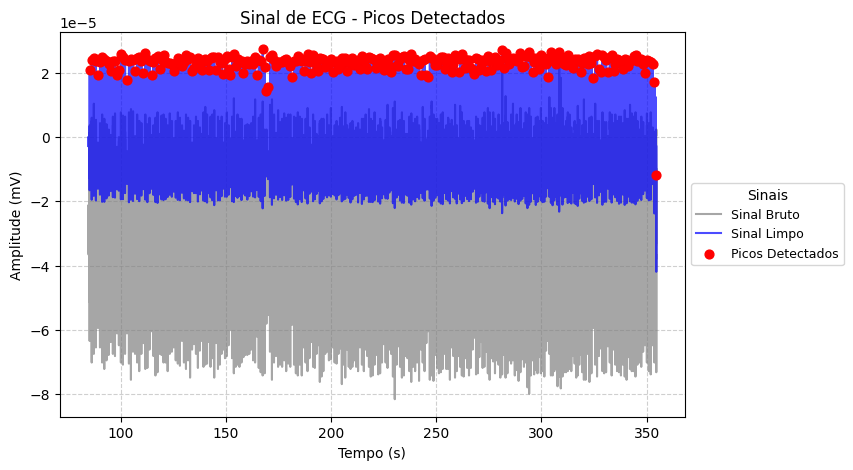

[INFO] Figura salva em: ecg_pre_processing/Sinal_de_ECG_-_Picos_Detectados.png


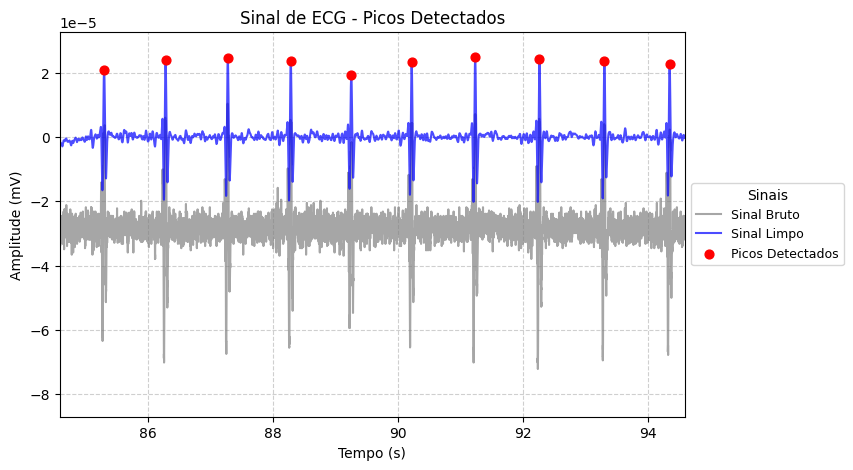

[INFO] Figura salva em: ecg_pre_processing/Sinal_de_ECG_-_Picos_Detectados_zoom.png


In [ ]:
from matplotlib import pyplot as plt
import os
from matplotlib import pyplot as plt

def plot_ecg(final_df, title, save_folder, zoom=False):
    """Plota o sinal de ECG e salva o gráfico na pasta especificada com a legenda à direita."""

    # 🔹 Criar a pasta se não existir
    os.makedirs(save_folder, exist_ok=True)

    fig, ax = plt.subplots(figsize=(10, 5))
    fig.subplots_adjust(right=0.75)

    legend_handles = []

    line_bruto, = ax.plot(final_df['time'], final_df['emg'], label="Sinal Bruto", color="gray", alpha=0.7, linewidth=1.5)
    legend_handles.append(line_bruto)

    line_cleaned, = ax.plot(final_df['time'], final_df['ecg_cleaned'], label="Sinal Limpo", color="blue", linewidth=1.5, alpha=0.7)
    legend_handles.append(line_cleaned)

    peak_times = final_df.loc[final_df['peaks'] == 1, 'time']
    peak_values = final_df.loc[final_df['peaks'] == 1, 'ecg_cleaned']
    scatter_peaks = ax.scatter(peak_times, peak_values, color="red", label="Picos Detectados", zorder=3, s=40)
    legend_handles.append(scatter_peaks)

    ax.set_title(title)
    ax.set_xlabel("Tempo (s)")
    ax.set_ylabel("Amplitude (mV)")
    ax.grid(True, linestyle="--", alpha=0.6)

    ax.legend(handles=legend_handles, title="Sinais", fontsize=9,
              loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)

    if zoom:
        ax.set_xlim(final_df['time'].min(), final_df['time'].min() + 10)
        filename = f"{save_folder}/{title.replace(' ', '_')}_zoom.png"
    else:
        filename = f"{save_folder}/{title.replace(' ', '_')}.png"

    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f"[INFO] Figura salva em: {filename}")

# 🔹 **Gerar os dois gráficos (completo e com zoom)**
plot_ecg(final_df, "Sinal de ECG - Picos Detectados", save_folder="ecg_pre_processing", zoom=False)
plot_ecg(final_df, "Sinal de ECG - Picos Detectados", save_folder="ecg_pre_processing", zoom=True)

In [ ]:
# Função para modificar picos manualmente com base nos tempos fornecidos
def modify_peaks(time_to_remove, time_to_add):
    """
    Remove e adiciona picos manualmente ao DataFrame com base nos tempos fornecidos.

    Parameters:
    - time_to_remove: Lista de tempos onde os picos devem ser removidos.
    - time_to_add: Lista de tempos onde os picos devem ser adicionados.
    """
    indices_to_remove = [final_df['time'].sub(t).abs().idxmin() for t in time_to_remove]
    indices_to_add = [final_df['time'].sub(t).abs().idxmin() for t in time_to_add]

    # Remover picos
    final_df.loc[indices_to_remove, 'peaks'] = 0
    # Adicionar picos
    final_df.loc[indices_to_add, 'peaks'] = 1

# Definir tempos para remover e adicionar picos manualmente
time_to_remove = []  # Adicione tempos aqui se necessário
time_to_add = []  # Exemplo de tempo a ser adicionado

# Aplicar modificações de picos
modify_peaks(time_to_remove, time_to_add)

print("Picos modificados manualmente com sucesso.")

Picos modificados manualmente com sucesso.


In [ ]:
# Aplicação de filtros para o sinal ECG

# Primeiro filtro: ±50ms ao redor dos picos detectados
samples_per_50ms = int(0.05 * fs)
first_mask = np.zeros(len(final_df), dtype=bool)
for idx in final_df.index[final_df['peaks'] == 1]:
    start_idx = max(idx - samples_per_50ms, 0)
    end_idx = min(idx + samples_per_50ms, len(final_df) - 1)
    first_mask[start_idx:end_idx] = True

first_filtered_signal = np.zeros(len(final_df))
first_filtered_signal[first_mask] = final_df['ecg_cleaned'][first_mask]

# Segundo filtro: Cruzamento pelo zero ao redor dos picos detectados
def find_zero_crossing(signal, start_idx, direction):
    if direction == "left":
        for idx in range(start_idx, 1, -1):
            if signal[idx] * signal[idx - 1] <= 0:
                return idx
        return 0  # Caso não encontre cruzamento, retorna início do sinal
    elif direction == "right":
        for idx in range(start_idx, len(signal) - 1):
            if signal[idx] * signal[idx + 1] <= 0:
                return idx
        return len(signal) - 1  # Caso não encontre cruzamento, retorna final do sinal
    return start_idx

second_mask = np.zeros(len(final_df), dtype=bool)
for idx in final_df.index[final_df['peaks'] == 1]:
    zero_crossing_left = find_zero_crossing(final_df['ecg_cleaned'], idx, "left")
    zero_crossing_right = find_zero_crossing(final_df['ecg_cleaned'], idx, "right")
    second_mask[zero_crossing_left:zero_crossing_right + 1] = True

# Combinação dos filtros para gerar o sinal final filtrado
final_mask = first_mask & second_mask
final_filtered_signal = np.zeros(len(final_df))
final_filtered_signal[final_mask] = final_df['ecg_cleaned'][final_mask]

# Atualizar o DataFrame com os sinais filtrados
final_df['first_filtered'] = first_filtered_signal
final_df['final_filtered'] = final_filtered_signal

print("Filtragem concluída e armazenada no DataFrame.")

# Visualização dos resultados após filtragem
fig = go.Figure()

# Sinal Limpo (sem filtros)
fig.add_trace(go.Scatter(
    x=final_df['time'],
    y=final_df['ecg_cleaned'],
    mode='lines',
    name='Sinal Limpo',
    opacity=1  # Defina a opacidade desejada (0.0 a 1.0)
))

# Primeiro filtro aplicado (±50ms ao redor dos picos)
fig.add_trace(go.Scatter(
    x=final_df['time'],
    y=final_df['first_filtered'],
    mode='lines',
    name='Primeiro Filtro (±50ms)',
    opacity=1  # Defina a opacidade desejada
))

# Sinal final filtrado (combinação dos filtros)
fig.add_trace(go.Scatter(
    x=final_df['time'],
    y=final_df['final_filtered'],
    mode='lines',
    name='Sinal Final Filtrado',
    opacity=1  # Opacidade total para o sinal final
))

# Adicionar os picos detectados para referência
fig.add_trace(go.Scatter(
    x=final_df.loc[final_df['peaks'] == 1, 'time'],
    y=final_df.loc[final_df['peaks'] == 1, 'ecg_cleaned'],
    mode='markers',
    name='Picos Detectados',
    marker=dict(color='red', size=8)
))

# Configuração do layout do gráfico
fig.update_layout(
    title="Sinal ECG - Aplicação de Filtros",
    xaxis_title="Tempo (s)",
    yaxis_title="Amplitude (mV)",
    legend_title="Sinais",
    xaxis_rangeslider_visible=True,
    template="plotly_white"
)

fig.show()

Filtragem concluída e armazenada no DataFrame.


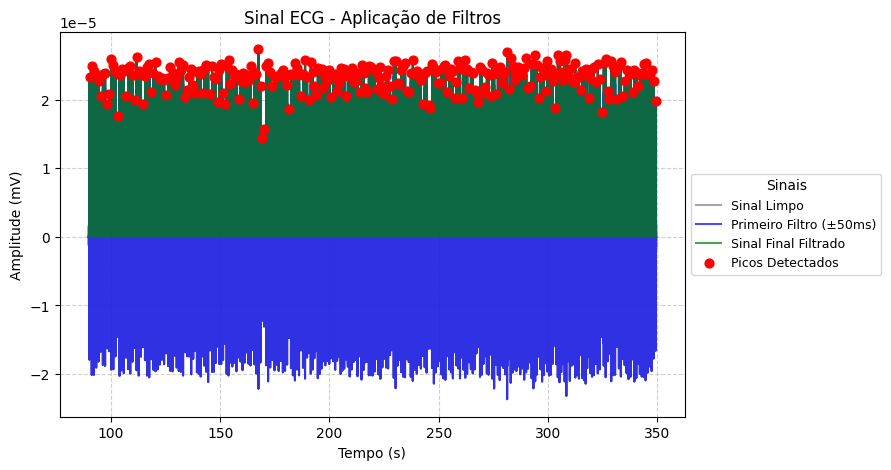

[INFO] Figura salva em: ecg_pre_processing/Sinal_ECG_-_Aplicação_de_Filtros.png


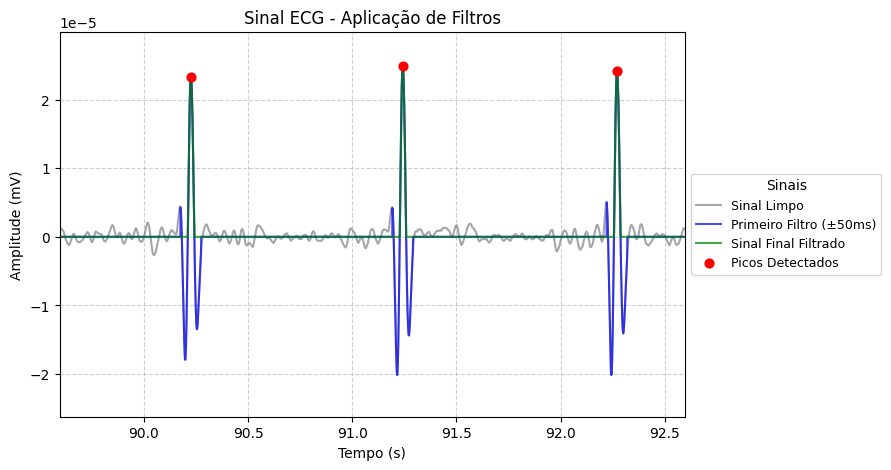

[INFO] Figura salva em: ecg_pre_processing/Sinal_ECG_-_Aplicação_de_Filtros_zoom.png


In [ ]:
# 🔹 **Função para plotar e salvar gráficos**
def plot_ecg_filters(final_df, title, save_folder, zoom=False):
    """Plota o sinal de ECG após aplicação dos filtros, removendo os primeiros e últimos 5 segundos, e salva o gráfico."""

    # 🔹 Cortar os primeiros e últimos 5 segundos do sinal
    time_min = final_df['time'].min() + 5
    time_max = final_df['time'].max() - 5
    filtered_df = final_df[(final_df['time'] >= time_min) & (final_df['time'] <= time_max)].reset_index(drop=True)

    fig, ax = plt.subplots(figsize=(10, 5))
    fig.subplots_adjust(right=0.75)  # 🔹 Reservar espaço para a legenda

    # Lista para a legenda personalizada
    legend_handles = []

    # Sinal Limpo (sem filtros) com transparência
    line_cleaned, = ax.plot(filtered_df['time'], filtered_df['ecg_cleaned'], label="Sinal Limpo", color="gray", alpha=0.7, linewidth=1.5)
    legend_handles.append(line_cleaned)

    # Primeiro filtro aplicado (±50ms ao redor dos picos) com transparência
    line_first_filter, = ax.plot(filtered_df['time'], filtered_df['first_filtered'], label="Primeiro Filtro (±50ms)", color="blue", linewidth=1.5, alpha=0.7)
    legend_handles.append(line_first_filter)

    # Sinal final filtrado (combinação dos filtros) com transparência
    line_final_filter, = ax.plot(filtered_df['time'], filtered_df['final_filtered'], label="Sinal Final Filtrado", color="green", linewidth=1.5, alpha=0.7)
    legend_handles.append(line_final_filter)

    # Picos detectados (mantém cor sólida para destacar)
    peak_times = filtered_df.loc[filtered_df['peaks'] == 1, 'time']
    peak_values = filtered_df.loc[filtered_df['peaks'] == 1, 'ecg_cleaned']
    scatter_peaks = ax.scatter(peak_times, peak_values, color="red", label="Picos Detectados", zorder=3, s=40)
    legend_handles.append(scatter_peaks)

    # Configuração do layout
    ax.set_title(title)
    ax.set_xlabel("Tempo (s)")
    ax.set_ylabel("Amplitude (mV)")
    ax.grid(True, linestyle="--", alpha=0.6)

    # 🔹 **Posicionar a legenda à direita do gráfico**
    ax.legend(handles=legend_handles, title="Sinais", fontsize=9,
              loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)

    # 🔹 Aplicar zoom nos primeiros 10 segundos se solicitado
    if zoom:
        ax.set_xlim(filtered_df['time'].min(), filtered_df['time'].min() + 3)
        filename = f"{save_folder}/{title.replace(' ', '_')}_zoom.png"
    else:
        filename = f"{save_folder}/{title.replace(' ', '_')}.png"

    # 🔹 Salvar figura
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f"[INFO] Figura salva em: {filename}")

# 🔹 **Gerar os dois gráficos (completo e com zoom)**
plot_ecg_filters(final_df, "Sinal ECG - Aplicação de Filtros", save_folder="ecg_pre_processing", zoom=False)
plot_ecg_filters(final_df, "Sinal ECG - Aplicação de Filtros", save_folder="ecg_pre_processing", zoom=True)

In [ ]:
from scipy.signal import hilbert

# Geração do sinal senoidal baseado nos picos R detectados
def gerar_sinal_sinusal_ecg(time, ecg_signal, peaks):
    """
    Gera um sinal senoidal baseado nos picos R do ECG.
    - Picos em +1
    - Forma de onda suave entre picos, atingindo -1 no meio.
    """
    ecg_min, ecg_max = ecg_signal.min(), ecg_signal.max()
    ecg_normalizado = 2 * (ecg_signal - ecg_min) / (ecg_max - ecg_min) - 1

    ecg_sinusal = np.zeros_like(ecg_signal, dtype=float)
    picos_indices = np.where(peaks == 1)[0]

    if len(picos_indices) < 2:
        print("Não há picos suficientes para gerar a onda senoidal.")
        return ecg_normalizado, ecg_sinusal

    for i in range(len(picos_indices) - 1):
        idx_i = picos_indices[i]
        idx_f = picos_indices[i + 1]
        t_i, t_f = time[idx_i], time[idx_f]

        for idx in range(idx_i, idx_f + 1):
            frac = (time[idx] - t_i) / (t_f - t_i)
            ecg_sinusal[idx] = np.cos(2 * np.pi * frac)

    ecg_sinusal[picos_indices] = 1.0  # Definir picos em +1

    return ecg_normalizado, ecg_sinusal

# Normalização do sinal final filtrado
ecg_cleaned = final_df['ecg_cleaned']

# Gerar sinal normalizado e senoidal baseado nos picos
ecg_normalizado, ecg_sinusal = gerar_sinal_sinusal_ecg(final_df['time'].values, ecg_cleaned, final_df['peaks'].values)

# Adicionar o sinal senoidal ao DataFrame
final_df['ecg_sinusal'] = ecg_sinusal

# Geração da senoide perfeita baseada na frequência média dos picos
picos_indices = np.where(final_df['peaks'] == 1)[0]

if len(picos_indices) < 2:
    print("Não há picos suficientes para gerar a senoide perfeita.")
else:
    peak_times = final_df['time'].iloc[picos_indices].values
    rr_intervals = np.diff(peak_times)
    avg_rr = np.mean(rr_intervals)
    freq_perfeita = 1.0 / avg_rr  # Hz

    seno_perfeita = np.sin(2 * np.pi * freq_perfeita * final_df['time'].values)

    # Definir limite de tempo para análise
    time_limit = 10  # segundos
    idx_limit = int(time_limit * fs)

    # Cálculo do PLV entre os sinais corrigidos
    def compute_plv(signal_1, signal_2):
        phase_diff = np.angle(hilbert(signal_1)) - np.angle(hilbert(signal_2))
        plv = np.abs(np.mean(np.exp(1j * phase_diff)))
        return plv

    plv_seno_picos = compute_plv(seno_perfeita[:idx_limit], ecg_sinusal[:idx_limit])
    plv_ecg_seno = compute_plv(ecg_cleaned[:idx_limit], seno_perfeita[:idx_limit])

    print(f"PLV entre Senoide Perfeita e Senoide pelos Picos (0-{time_limit}s): {plv_seno_picos:.4f}")
    print(f"PLV entre ECG Final Filtrado e Senoide Simulada (0-{time_limit}s): {plv_ecg_seno:.4f}")

# Visualização da comparação de fase entre os sinais corrigidos
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=final_df['time'][:idx_limit],
    y=np.angle(hilbert(ecg_cleaned[:idx_limit])),
    name='Fase - ECG Filtrado'
))

fig.add_trace(go.Scatter(
    x=final_df['time'][:idx_limit],
    y=np.angle(hilbert(ecg_sinusal[:idx_limit])),
    name='Fase - ECG Senoidal'
))

fig.add_trace(go.Scatter(
    x=final_df['time'][:idx_limit],
    y=np.angle(hilbert(seno_perfeita[:idx_limit])),
    name='Fase - Senoide Simulada'
))

fig.update_layout(
    title=f"Comparação de Fase entre Sinais - {athlete} / {condition}",
    xaxis_title="Tempo (s)",
    yaxis_title="Fase (radianos)",
    legend_title="Sinais",
    template='plotly_white'
)

fig.show()

print("Visualização da fase dos sinais corrigida concluída.")

PLV entre Senoide Perfeita e Senoide pelos Picos (0-10s): 0.2183
PLV entre ECG Final Filtrado e Senoide Simulada (0-10s): 0.0400


Visualização da fase dos sinais corrigida concluída.


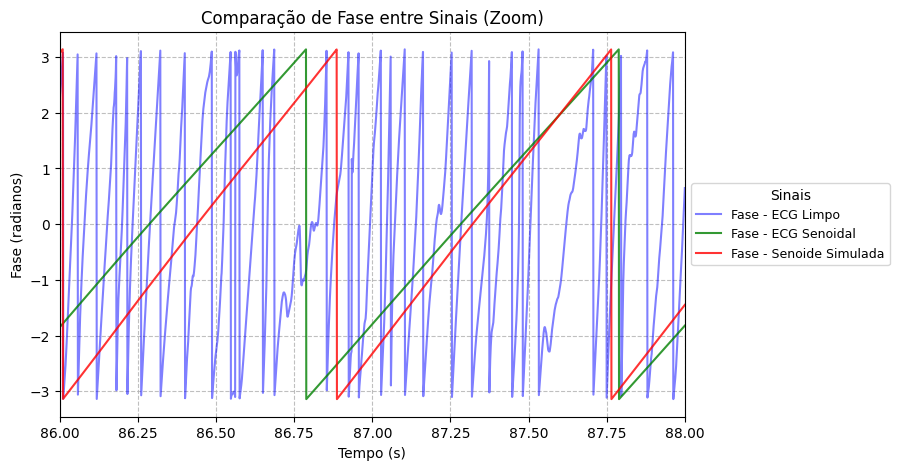

[INFO] Figura salva em: ecg_pre_processing/Comparação_de_Fase_entre_Sinais_(Zoom).png


In [ ]:
# Definir zoom manual (exemplo: mostrar apenas de 86 a 88 segundos)
start_zoom = 86
end_zoom = 88  # Zoom de 2 segundos, por exemplo

# 🔹 **Função para plotar e salvar gráficos**
def plot_phase_comparison(time, phase_ecg, phase_sinusal, phase_seno, save_folder, title):
    """Plota a comparação de fase entre os sinais corrigidos e salva o gráfico."""

    fig, ax = plt.subplots(figsize=(10, 5))
    fig.subplots_adjust(right=0.75)  # 🔹 Reservar espaço para a legenda

    # Lista para a legenda personalizada
    legend_handles = []

    # 🔹 Fase - ECG Limpo (com maior transparência e plotado primeiro)
    line_ecg, = ax.plot(time, phase_ecg, label="Fase - ECG Limpo", color="blue", linewidth=1.5, alpha=0.5)
    legend_handles.append(line_ecg)

    # 🔹 Fase - ECG Senoidal
    line_sinusal, = ax.plot(time, phase_sinusal, label="Fase - ECG Senoidal", color="green", linewidth=1.5, alpha=0.8)
    legend_handles.append(line_sinusal)

    # 🔹 Fase - Senoide Simulada
    line_seno, = ax.plot(time, phase_seno, label="Fase - Senoide Simulada", color="red", linewidth=1.5, alpha=0.8)
    legend_handles.append(line_seno)

    # Configuração do layout
    ax.set_title(title)
    ax.set_xlabel("Tempo (s)")
    ax.set_ylabel("Fase (radianos)")
    ax.grid(True, linestyle="--", alpha=0.8)

    # 🔹 Aplicar zoom manual no eixo X
    ax.set_xlim(start_zoom, end_zoom)

    # 🔹 **Posicionar a legenda à direita do gráfico**
    ax.legend(handles=legend_handles, title="Sinais", fontsize=9,
              loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)

    # 🔹 Salvar figura
    filename = f"{save_folder}/{title.replace(' ', '_').replace('/', '-')}.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f"[INFO] Figura salva em: {filename}")


# 🔹 **Cálculo das fases usando a Transformada de Hilbert**
phase_ecg_cleaned = np.angle(hilbert(final_df['ecg_cleaned'][:idx_limit]))
phase_ecg_sinusal = np.angle(hilbert(final_df['ecg_sinusal'][:idx_limit]))
phase_seno_perfeita = np.angle(hilbert(seno_perfeita[:idx_limit]))

# 🔹 **Gerar gráfico da comparação de fase**
plot_phase_comparison(final_df['time'][:idx_limit],
                      phase_ecg_cleaned,
                      phase_ecg_sinusal,
                      phase_seno_perfeita,
                      "ecg_pre_processing",
                      "Comparação de Fase entre Sinais (Zoom)")

In [ ]:
# Salvar os dados processados em um arquivo CSV para análises futuras
output_filename = f"{athlete}_{condition}_processed_ecg.csv"
final_df.to_csv(output_filename, index=False)

# Função para fazer upload do arquivo CSV para o Google Drive
def upload_to_drive(file_path, folder_id=None):
    file_metadata = {'name': file_path.split('/')[-1]}
    if folder_id:
        file_metadata['parents'] = [folder_id]

    media = MediaFileUpload(file_path, resumable=True)
    uploaded_file = service.files().create(
        body=file_metadata,
        media_body=media,
        fields='id'
    ).execute()

    print(f"Arquivo '{file_path}' enviado ao Google Drive com ID: {uploaded_file.get('id')}")

# Definir ID da pasta do Google Drive para upload (opcional)
drive_folder_id = '1Gc1cEllqCaZTaFbapsDFVo9bv4_04kKX'  # Substitua pelo ID da pasta se desejar armazenar lá

# Realizar upload do arquivo processado para o Google Drive
upload_to_drive(output_filename, drive_folder_id)

print(f"Arquivo salvo e enviado para o Google Drive: {output_filename}")

Arquivo 'athlete_4_post_cathodic_processed_ecg.csv' enviado ao Google Drive com ID: 1HrhnFYCDg_6XU56P7LCHBES4A4l3YIpn
Arquivo salvo e enviado para o Google Drive: athlete_4_post_cathodic_processed_ecg.csv


# EEG-EEG and EEG-ECG PLV

In [10]:
!pip install mne --quiet
import os
import io
import mne
import numpy as np
import pandas as pd
from scipy.signal import resample, hilbert, butter, filtfilt
import matplotlib.pyplot as plt
import warnings
from google.colab import auth
from googleapiclient.discovery import build
from googleapiclient.http import MediaIoBaseDownload, MediaFileUpload
import seaborn as sns

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 55.1 MB/s eta 0:00:00


In [11]:
# Autenticação no Google Drive
auth.authenticate_user()
drive_service = build('drive', 'v3')

# Suppress MNE warnings
warnings.filterwarnings("ignore", category=RuntimeWarning, message=".*does not conform to MNE naming conventions.*")

# Configure memory mapping for efficient parallel processing
mne.set_config('MNE_MEMMAP_MIN_SIZE', '10M')  # Store arrays >10MB on disk
mne.set_config('MNE_CACHE_DIR', '/dev/shm')   # Use shared memory for faster access

# Função para download de arquivos do Google Drive
def download_file(file_id, destination_folder):
    """Download file from Google Drive and save locally."""
    request = drive_service.files().get_media(fileId=file_id)
    file_metadata = drive_service.files().get(fileId=file_id).execute()
    file_name = file_metadata['name']
    file_path = os.path.join(destination_folder, file_name)

    if os.path.exists(file_path):
        print(f"[INFO] {file_name} já existe. Pulando download.")
        return file_path

    fh = io.BytesIO()
    downloader = MediaIoBaseDownload(fh, request)
    done = False
    while not done:
        status, done = downloader.next_chunk()
        print(f"[INFO] Download progress: {status.progress() * 100:.2f}%")

    with open(file_path, 'wb') as f:
        fh.seek(0)
        f.write(fh.read())

    print(f"[SUCCESS] Downloaded: {file_name}")
    return file_path

# Função para baixar arquivos de uma pasta no Google Drive
def download_files_from_folder(folder_id, destination_folder):
    os.makedirs(destination_folder, exist_ok=True)
    query = f"'{folder_id}' in parents and trashed=false"
    results = drive_service.files().list(q=query).execute()
    files = results.get('files', [])

    if not files:
        print(f"[ERROR] No files found in folder: {folder_id}")
        return

    for file in files:
        download_file(file['id'], destination_folder)

# Funções para carregar dados
def load_eeg_data(eeg_path):
    try:
        print(f"[INFO] Loading EEG: {eeg_path}")
        raw = mne.io.read_raw_fif(eeg_path, preload=True, verbose='ERROR')
        print(f"[SUCCESS] EEG loaded: {os.path.basename(eeg_path)} | Channels: {len(raw.ch_names)} | Duration: {raw.times[-1]:.2f}s | SFreq: {raw.info['sfreq']} Hz")
        return raw
    except Exception as e:
        print(f"[ERROR] Failed to load EEG {eeg_path}: {e}")
        return None

def load_ecg_data(ecg_path):
    try:
        data = pd.read_csv(ecg_path)
        print(f"[SUCCESS] ECG loaded: {os.path.basename(ecg_path)} | Records: {len(data)} | Time range: {data['time'].iloc[0]:.2f}s to {data['time'].iloc[-1]:.2f}s")
        return data
    except Exception as e:
        print(f"[ERROR] Failed to load ECG {ecg_path}: {e}")
        return None

def upload_to_drive(file_path, folder_id=None):
    file_metadata = {'name': file_path.split('/')[-1]}
    if folder_id:
        file_metadata['parents'] = [folder_id]

    media = MediaFileUpload(file_path, resumable=True)
    uploaded_file = drive_service.files().create(
        body=file_metadata,
        media_body=media,
        fields='id'
    ).execute()

    print(f"Arquivo '{file_path}' enviado ao Google Drive com ID: {uploaded_file.get('id')}")


# Função para reiniciar o tempo do ECG a partir de zero
def reset_ecg_time(df):
    if df is not None and 'time' in df.columns:
        df['time'] -= df['time'].iloc[0]
    return df

# Sincronização de durações: se ECG for menor que EEG, corta o final do EEG
def match_eeg_ecg_duration(data):
    """
    Verifica a duração do ECG e do EEG. Se ECG for menor, corta o EEG no tempo correspondente.
    Modifica diretamente os dados no dicionário 'data'.
    """
    for key in data['eeg']:
        ecg_key = key  # As chaves são iguais para 'eeg' e 'ecg'

        ecg_df = data['ecg'].get(ecg_key)
        eeg_raw = data['eeg'].get(key)

        if ecg_df is None or eeg_raw is None:
            print(f"[{key}] -> ECG ou EEG não disponível. Nenhuma ação realizada.")
            continue

        ecg_duration = ecg_df['time'].max()
        eeg_duration = eeg_raw.times[-1]

        if ecg_duration < eeg_duration:
            print(f"[{key}] -> ECG dura {ecg_duration:.2f}s, EEG dura {eeg_duration:.2f}s. Cortando EEG.")
            eeg_raw.crop(tmin=0, tmax=ecg_duration)
            data['eeg'][key] = eeg_raw  # Atualiza o EEG no dicionário
        else:
            print(f"[{key}] -> ECG e EEG já sincronizados. Nenhum corte necessário.")

Attempting to create new mne-python configuration file:
/root/.mne/mne-python.json


## Calculate Synchronicity

In [ ]:
# Download EEG and ECG files
download_files_from_folder(destination_folder='eeg', folder_id='1PRaH4O3pB4Nyb7nRl7oLuH9iu5aSKNrO')
download_files_from_folder(destination_folder='ecg', folder_id='1Gc1cEllqCaZTaFbapsDFVo9bv4_04kKX')

ATHLETES = ['athlete_1', 'athlete_2', 'athlete_3', 'athlete_4', 'athlete_5', 'athlete_6', 'athlete_7']
CONDITIONS = ['pre_sham', 'post_sham', 'pre_cathodic', 'post_cathodic']

data = {"eeg": {}, "ecg": {}}
for athlete in ATHLETES:
    for condition in CONDITIONS:
        eeg_path = os.path.join('eeg', f"{athlete}_{condition}.fif")
        ecg_path = os.path.join('ecg', f"{athlete}_{condition}_processed_ecg.csv")
        data["eeg"][f"{athlete}_{condition}"] = load_eeg_data(eeg_path)
        data["ecg"][f"{athlete}_{condition}"] = load_ecg_data(ecg_path)

# Resetando tempo do ECG para começar em 0
for key in data['ecg']:
    if data['ecg'][key] is not None:
        data['ecg'][key] = reset_ecg_time(data['ecg'][key])

# Executa a sincronização das durações
match_eeg_ecg_duration(data)

[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_7_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_6_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_5_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_4_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_3_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_2_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_1_post_sham.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_2_post_cathodic.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_7_post_cathodic.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_5_post_cathodic.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_4_post_cathodic.fif
[INFO] Download progress: 100.00%
[SUCCESS] Downloaded: athlete_3_post_cathodic.fif
[INFO] Download prog

In [ ]:
from joblib import Parallel, delayed
import os
import matplotlib.pyplot as plt
import numpy as np
import numpy.fft as fft
import pandas as pd
from scipy.signal import butter, filtfilt, hilbert, resample
from tqdm import tqdm

# Função de filtro passa‐banda
def bandpass_filter(data, fs, band, order=4):
    nyquist = 0.5 * fs
    low = band[0] / nyquist
    high = band[1] / nyquist
    b, a = butter(order, [low, high], btype='band')
    return filtfilt(b, a, data, axis=1)

def compute_cf_plm(x, y, fs, B=1.0):
    """
    Computes the CF-PLM using a direct FFT-based approach.
    Returns a two-sided frequency axis (centered at zero) and the CF-PLM value.
    """
    # 1) Build interferometric signal: z(t) = exp[i*(phi_x(t) - phi_y(t))]
    x_an = hilbert(x)
    y_an = hilbert(y)
    z = (x_an * np.conjugate(y_an)) / (np.abs(x_an) * np.abs(y_an))
    z = np.nan_to_num(z)

    # 2) Compute FFT and two-sided PSD (correct scaling: divide by (N * fs))
    N = len(z)
    Z = fft.fft(z)
    Pxx = np.abs(Z)**2 / (N * fs)
    freqs = fft.fftfreq(N, d=1/fs)

    # 3) Shift so zero frequency is centered
    Pxx_shifted = fft.fftshift(Pxx)
    freqs_shifted = fft.fftshift(freqs)

    # 4) Find the global maximum in PSD and its corresponding frequency
    peak_idx = np.argmax(Pxx_shifted)
    f_peak = freqs_shifted[peak_idx]

    # 5) Integrate the PSD in [f_peak - B, f_peak + B] and over all frequencies
    mask = (freqs_shifted >= f_peak - B) & (freqs_shifted <= f_peak + B)
    power_band = np.trapz(Pxx_shifted[mask], freqs_shifted[mask])
    total_power = np.trapz(Pxx_shifted, freqs_shifted)

    cf_plm_val = power_band / total_power
    return cf_plm_val, freqs_shifted, Pxx_shifted, f_peak

def calculate_connectivity(eeg_data, ecg_data, athlete, condition,
                           band_name, band_range, window_size=10,
                           connectivity_methods={'EEG_EEG': ['plv', 'pli'],
                                                 'EEG_ECG': ['plv', 'pli']}):
    """
    Calculates connectivity measures (PLV, PLI, and optionally CF-PLM) for EEG_EEG and EEG_ECG connections.
    """
    if eeg_data is None or ecg_data is None:
        print(f"[DEBUG] Dados ausentes para {athlete}/{condition}.")
        return pd.DataFrame()

    eeg_sfreq = eeg_data.info['sfreq']

    # Process ECG: resample if necessary
    ecg_signal = ecg_data['ecg_cleaned'].values
    ecg_time = ecg_data['time'].values
    ecg_sfreq = 1.0 / np.mean(np.diff(ecg_time))
    if not np.isclose(ecg_sfreq, eeg_sfreq):
        ecg_signal = resample(ecg_signal, int(len(ecg_signal) * eeg_sfreq / ecg_sfreq))

    # Filter EEG data and extract filtered signal
    filtered_eeg = eeg_data.copy().filter(l_freq=band_range[0],
                                          h_freq=band_range[1],
                                          verbose=False).get_data()

    # Determine minimum length and create window segments
    min_len = min(filtered_eeg.shape[1], len(ecg_signal))
    w_samp = int(window_size * eeg_sfreq)
    n_windows = (min_len - w_samp) // w_samp + 1
    total_samples = n_windows * w_samp

    # Prepare phase-based segmentation (for PLV/PLI)
    eeg_analytic = hilbert(filtered_eeg, axis=1)
    eeg_phases = np.angle(eeg_analytic)[:, :total_samples]
    ecg_analytic = hilbert(ecg_signal)
    ecg_phase = np.angle(ecg_analytic)[:total_samples]
    eeg_phases_windows = eeg_phases.reshape(filtered_eeg.shape[0], n_windows, w_samp)
    ecg_phase_windows = ecg_phase.reshape(n_windows, w_samp)

    # Also prepare windowed segments of the raw filtered signals for CF-PLM
    filtered_eeg_windows = filtered_eeg[:, :total_samples].reshape(filtered_eeg.shape[0], n_windows, w_samp)
    ecg_signal_windows = ecg_signal[:total_samples].reshape(n_windows, w_samp)

    results = {}

    # EEG_EEG connectivity
    if 'EEG_EEG' in connectivity_methods:
        methods = connectivity_methods['EEG_EEG']
        n_ch = eeg_phases_windows.shape[0]
        print(f"[INFO] Processando EEG_EEG para {athlete}/{condition} na banda {band_name}...")
        for i in tqdm(range(n_ch), desc=f"EEG_EEG Pairs ({athlete}/{condition}/{band_name})"):
            for j in range(i + 1, n_ch):
                pair_name = f"{eeg_data.ch_names[i]}_{eeg_data.ch_names[j]}"
                phase_diff = eeg_phases_windows[i] - eeg_phases_windows[j]
                metrics = {}
                if 'plv' in methods:
                    plv_vals = np.abs(np.mean(np.exp(1j * phase_diff), axis=1))
                    metrics['plv'] = plv_vals.tolist()
                if 'pli' in methods:
                    pli_vals = np.abs(np.mean(np.sign(np.sin(phase_diff)), axis=1))
                    metrics['pli'] = pli_vals.tolist()
                if 'cf_plm' in methods:
                    cf_plm_vals = []
                    for w in range(n_windows):
                        seg_x = filtered_eeg_windows[i, w, :]
                        seg_y = filtered_eeg_windows[j, w, :]
                        cf_plm_val, _, _, _ = compute_cf_plm(seg_x, seg_y, eeg_sfreq)
                        cf_plm_vals.append(cf_plm_val)
                    metrics['cf_plm'] = cf_plm_vals
                results[pair_name] = metrics

    # EEG_ECG connectivity
    if 'EEG_ECG' in connectivity_methods:
        methods = connectivity_methods['EEG_ECG']
        print(f"[INFO] Processando EEG_ECG para {athlete}/{condition} na banda {band_name}...")
        for ch_idx, ch_name in tqdm(enumerate(eeg_data.ch_names),
                                    total=len(eeg_data.ch_names),
                                    desc=f"EEG_ECG Pairs ({athlete}/{condition}/{band_name})"):
            phase_diff = eeg_phases_windows[ch_idx] - ecg_phase_windows
            metrics = {}
            if 'plv' in methods:
                plv_vals = np.abs(np.mean(np.exp(1j * phase_diff), axis=1))
                metrics['plv'] = plv_vals.tolist()
            if 'pli' in methods:
                pli_vals = np.abs(np.mean(np.sign(np.sin(phase_diff)), axis=1))
                metrics['pli'] = pli_vals.tolist()
            if 'cf_plm' in methods:
                cf_plm_vals = []
                for w in range(n_windows):
                    seg_x = filtered_eeg_windows[ch_idx, w, :]
                    seg_y = ecg_signal_windows[w, :]
                    cf_plm_val, _, _, _ = compute_cf_plm(seg_x, seg_y, eeg_sfreq)
                    cf_plm_vals.append(cf_plm_val)
                metrics['cf_plm'] = cf_plm_vals
            results[f"{ch_name}_ECG"] = metrics

    # Organize results into a DataFrame
    rows = []
    time_points = n_windows
    for t in range(time_points):
        for pair, metrics in results.items():
            rows.append({
                'athlete': athlete,
                'condition': condition,
                'frequency_band': band_name,
                'channel_pair': pair,
                'time_window': t,
                'plv': metrics.get('plv', [np.nan]*time_points)[t],
                'pli': metrics.get('pli', [np.nan]*time_points)[t],
                'cf_plm': metrics.get('cf_plm', [np.nan]*time_points)[t],
            })

    return pd.DataFrame(rows)

# Parâmetros e configuração
ATHLETES = ['athlete_1', 'athlete_2', 'athlete_3', 'athlete_4', 'athlete_5', 'athlete_6', 'athlete_7']
CONDITIONS = ['pre_sham', 'post_sham', 'pre_cathodic', 'post_cathodic']
WINDOW_SIZE = 10  # segundos
FREQUENCY_BANDS = {
    'delta': [0.5, 4],
    'theta': [4, 8],
    'alpha': [8, 13],
    'beta': [13, 30],
    'gamma': [30, 60]
}

all_results = []

# Loop principal para processamento
for athlete in ATHLETES:
    for condition in CONDITIONS:
        key = f"{athlete}_{condition}"
        if key not in data['eeg'] or key not in data['ecg']:
            print(f"[WARNING] Dados ausentes para {athlete} {condition}. Pulando.")
            continue
        for band_name, band_range in FREQUENCY_BANDS.items():
            print(f"[INFO] Processando {key} para a banda {band_name}...")
            df = calculate_connectivity(
                eeg_data=data['eeg'][key],
                ecg_data=data['ecg'][key],
                athlete=athlete,
                condition=condition,
                band_name=band_name,
                band_range=band_range,
                window_size=WINDOW_SIZE,
                connectivity_methods={'EEG_EEG': ['plv', 'pli', 'cf_plm'], 'EEG_ECG': ['plv', 'pli', 'cf_plm']}
            )
            filename = f"{athlete}_{condition}_connectivity_{band_name}.csv"
            df.to_csv(filename, index=False)
            print(f"[INFO] Salvo: {filename}")
            all_results.append(df)

if all_results:
    summary_df = pd.concat(all_results, ignore_index=True)
    summary_filename = "summary_connectivity.csv"
    summary_df.to_csv(summary_filename, index=False)
    print(f"[INFO] Summary salvo: {summary_filename}")
else:
    print("[INFO] Nenhum resultado foi processado.")

[INFO] Processando athlete_1_pre_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_1/pre_sham na banda delta...


EEG_EEG Pairs (athlete_1/pre_sham/delta): 100%|██████████| 61/61 [00:37<00:00,  1.62it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_sham na banda delta...


EEG_ECG Pairs (athlete_1/pre_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 50.18it/s]


[INFO] Salvo: athlete_1_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_1_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_1/pre_sham na banda theta...


EEG_EEG Pairs (athlete_1/pre_sham/theta): 100%|██████████| 61/61 [00:36<00:00,  1.66it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_sham na banda theta...


EEG_ECG Pairs (athlete_1/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 50.01it/s]


[INFO] Salvo: athlete_1_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_1_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_1/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_1/pre_sham/alpha): 100%|██████████| 61/61 [00:36<00:00,  1.66it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_1/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 37.11it/s]


[INFO] Salvo: athlete_1_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_1_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_1/pre_sham na banda beta...


EEG_EEG Pairs (athlete_1/pre_sham/beta): 100%|██████████| 61/61 [00:37<00:00,  1.64it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_sham na banda beta...


EEG_ECG Pairs (athlete_1/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 48.94it/s]


[INFO] Salvo: athlete_1_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_1_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_1/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_1/pre_sham/gamma): 100%|██████████| 61/61 [00:37<00:00,  1.62it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_1/pre_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 48.99it/s]


[INFO] Salvo: athlete_1_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_1_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_1/post_sham na banda delta...


EEG_EEG Pairs (athlete_1/post_sham/delta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_1/post_sham na banda delta...


EEG_ECG Pairs (athlete_1/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 47.09it/s]


[INFO] Salvo: athlete_1_post_sham_connectivity_delta.csv
[INFO] Processando athlete_1_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_1/post_sham na banda theta...


EEG_EEG Pairs (athlete_1/post_sham/theta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_1/post_sham na banda theta...


EEG_ECG Pairs (athlete_1/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 45.14it/s]


[INFO] Salvo: athlete_1_post_sham_connectivity_theta.csv
[INFO] Processando athlete_1_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_1/post_sham na banda alpha...


EEG_EEG Pairs (athlete_1/post_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_1/post_sham na banda alpha...


EEG_ECG Pairs (athlete_1/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 46.29it/s]


[INFO] Salvo: athlete_1_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_1_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_1/post_sham na banda beta...


EEG_EEG Pairs (athlete_1/post_sham/beta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_1/post_sham na banda beta...


EEG_ECG Pairs (athlete_1/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 31.26it/s]


[INFO] Salvo: athlete_1_post_sham_connectivity_beta.csv
[INFO] Processando athlete_1_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_1/post_sham na banda gamma...


EEG_EEG Pairs (athlete_1/post_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_1/post_sham na banda gamma...


EEG_ECG Pairs (athlete_1/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.96it/s]


[INFO] Salvo: athlete_1_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_1_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_1/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_1/pre_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_1/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 46.49it/s]


[INFO] Salvo: athlete_1_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_1_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_1/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_1/pre_cathodic/theta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_1/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 47.46it/s]


[INFO] Salvo: athlete_1_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_1_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_1/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_1/pre_cathodic/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_1/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 47.39it/s]


[INFO] Salvo: athlete_1_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_1_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_1/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_1/pre_cathodic/beta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_1/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 45.88it/s]


[INFO] Salvo: athlete_1_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_1_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_1/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_1/pre_cathodic/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_1/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_1/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.16it/s]


[INFO] Salvo: athlete_1_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_1_post_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_1/post_cathodic na banda delta...


EEG_EEG Pairs (athlete_1/post_cathodic/delta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_1/post_cathodic na banda delta...


EEG_ECG Pairs (athlete_1/post_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 45.38it/s]


[INFO] Salvo: athlete_1_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_1_post_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_1/post_cathodic na banda theta...


EEG_EEG Pairs (athlete_1/post_cathodic/theta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_1/post_cathodic na banda theta...


EEG_ECG Pairs (athlete_1/post_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 44.89it/s]


[INFO] Salvo: athlete_1_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_1_post_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_1/post_cathodic na banda alpha...


EEG_EEG Pairs (athlete_1/post_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_1/post_cathodic na banda alpha...


EEG_ECG Pairs (athlete_1/post_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 44.51it/s]


[INFO] Salvo: athlete_1_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_1_post_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_1/post_cathodic na banda beta...


EEG_EEG Pairs (athlete_1/post_cathodic/beta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_1/post_cathodic na banda beta...


EEG_ECG Pairs (athlete_1/post_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 44.78it/s]


[INFO] Salvo: athlete_1_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_1_post_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_1/post_cathodic na banda gamma...


EEG_EEG Pairs (athlete_1/post_cathodic/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_1/post_cathodic na banda gamma...


EEG_ECG Pairs (athlete_1/post_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 45.56it/s]


[INFO] Salvo: athlete_1_post_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_2_pre_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_2/pre_sham na banda delta...


EEG_EEG Pairs (athlete_2/pre_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_sham na banda delta...


EEG_ECG Pairs (athlete_2/pre_sham/delta): 100%|██████████| 61/61 [00:02<00:00, 29.72it/s]


[INFO] Salvo: athlete_2_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_2_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_2/pre_sham na banda theta...


EEG_EEG Pairs (athlete_2/pre_sham/theta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_sham na banda theta...


EEG_ECG Pairs (athlete_2/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 44.04it/s]


[INFO] Salvo: athlete_2_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_2_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_2/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_2/pre_sham/alpha): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_2/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 45.50it/s]


[INFO] Salvo: athlete_2_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_2_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_2/pre_sham na banda beta...


EEG_EEG Pairs (athlete_2/pre_sham/beta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_sham na banda beta...


EEG_ECG Pairs (athlete_2/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 45.18it/s]


[INFO] Salvo: athlete_2_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_2_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_2/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_2/pre_sham/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_2/pre_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.72it/s]


[INFO] Salvo: athlete_2_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_2_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_2/post_sham na banda delta...


EEG_EEG Pairs (athlete_2/post_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_2/post_sham na banda delta...


EEG_ECG Pairs (athlete_2/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 35.96it/s]


[INFO] Salvo: athlete_2_post_sham_connectivity_delta.csv
[INFO] Processando athlete_2_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_2/post_sham na banda theta...


EEG_EEG Pairs (athlete_2/post_sham/theta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_2/post_sham na banda theta...


EEG_ECG Pairs (athlete_2/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 46.30it/s]


[INFO] Salvo: athlete_2_post_sham_connectivity_theta.csv
[INFO] Processando athlete_2_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_2/post_sham na banda alpha...


EEG_EEG Pairs (athlete_2/post_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_2/post_sham na banda alpha...


EEG_ECG Pairs (athlete_2/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 34.80it/s]


[INFO] Salvo: athlete_2_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_2_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_2/post_sham na banda beta...


EEG_EEG Pairs (athlete_2/post_sham/beta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_2/post_sham na banda beta...


EEG_ECG Pairs (athlete_2/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 45.46it/s]


[INFO] Salvo: athlete_2_post_sham_connectivity_beta.csv
[INFO] Processando athlete_2_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_2/post_sham na banda gamma...


EEG_EEG Pairs (athlete_2/post_sham/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_2/post_sham na banda gamma...


EEG_ECG Pairs (athlete_2/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.32it/s]


[INFO] Salvo: athlete_2_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_2_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_2/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_2/pre_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_2/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 34.82it/s]


[INFO] Salvo: athlete_2_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_2_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_2/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_2/pre_cathodic/theta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_2/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 44.80it/s]


[INFO] Salvo: athlete_2_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_2_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_2/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_2/pre_cathodic/alpha): 100%|██████████| 61/61 [00:41<00:00,  1.47it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_2/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 42.21it/s]


[INFO] Salvo: athlete_2_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_2_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_2/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_2/pre_cathodic/beta): 100%|██████████| 61/61 [00:43<00:00,  1.41it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_2/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 35.87it/s]


[INFO] Salvo: athlete_2_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_2_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_2/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_2/pre_cathodic/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.46it/s]


[INFO] Processando EEG_ECG para athlete_2/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_2/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 35.55it/s]


[INFO] Salvo: athlete_2_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_2_post_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_2/post_cathodic na banda delta...


EEG_EEG Pairs (athlete_2/post_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_2/post_cathodic na banda delta...


EEG_ECG Pairs (athlete_2/post_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 46.20it/s]


[INFO] Salvo: athlete_2_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_2_post_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_2/post_cathodic na banda theta...


EEG_EEG Pairs (athlete_2/post_cathodic/theta): 100%|██████████| 61/61 [00:38<00:00,  1.58it/s]


[INFO] Processando EEG_ECG para athlete_2/post_cathodic na banda theta...


EEG_ECG Pairs (athlete_2/post_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 47.20it/s]


[INFO] Salvo: athlete_2_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_2_post_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_2/post_cathodic na banda alpha...


EEG_EEG Pairs (athlete_2/post_cathodic/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_2/post_cathodic na banda alpha...


EEG_ECG Pairs (athlete_2/post_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 46.36it/s]


[INFO] Salvo: athlete_2_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_2_post_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_2/post_cathodic na banda beta...


EEG_EEG Pairs (athlete_2/post_cathodic/beta): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_2/post_cathodic na banda beta...


EEG_ECG Pairs (athlete_2/post_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 43.43it/s]


[INFO] Salvo: athlete_2_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_2_post_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_2/post_cathodic na banda gamma...


EEG_EEG Pairs (athlete_2/post_cathodic/gamma): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_2/post_cathodic na banda gamma...


EEG_ECG Pairs (athlete_2/post_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 45.30it/s]


[INFO] Salvo: athlete_2_post_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_3_pre_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_3/pre_sham na banda delta...


EEG_EEG Pairs (athlete_3/pre_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_sham na banda delta...


EEG_ECG Pairs (athlete_3/pre_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 31.08it/s]


[INFO] Salvo: athlete_3_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_3_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_3/pre_sham na banda theta...


EEG_EEG Pairs (athlete_3/pre_sham/theta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_sham na banda theta...


EEG_ECG Pairs (athlete_3/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 48.05it/s]


[INFO] Salvo: athlete_3_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_3_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_3/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_3/pre_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_3/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 34.35it/s]


[INFO] Salvo: athlete_3_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_3_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_3/pre_sham na banda beta...


EEG_EEG Pairs (athlete_3/pre_sham/beta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_sham na banda beta...


EEG_ECG Pairs (athlete_3/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 46.16it/s]


[INFO] Salvo: athlete_3_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_3_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_3/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_3/pre_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.49it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_3/pre_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 45.17it/s]


[INFO] Salvo: athlete_3_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_3_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_3/post_sham na banda delta...


EEG_EEG Pairs (athlete_3/post_sham/delta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_3/post_sham na banda delta...


EEG_ECG Pairs (athlete_3/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 45.78it/s]


[INFO] Salvo: athlete_3_post_sham_connectivity_delta.csv
[INFO] Processando athlete_3_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_3/post_sham na banda theta...


EEG_EEG Pairs (athlete_3/post_sham/theta): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_3/post_sham na banda theta...


EEG_ECG Pairs (athlete_3/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 44.70it/s]


[INFO] Salvo: athlete_3_post_sham_connectivity_theta.csv
[INFO] Processando athlete_3_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_3/post_sham na banda alpha...


EEG_EEG Pairs (athlete_3/post_sham/alpha): 100%|██████████| 61/61 [00:41<00:00,  1.49it/s]


[INFO] Processando EEG_ECG para athlete_3/post_sham na banda alpha...


EEG_ECG Pairs (athlete_3/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 40.05it/s]


[INFO] Salvo: athlete_3_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_3_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_3/post_sham na banda beta...


EEG_EEG Pairs (athlete_3/post_sham/beta): 100%|██████████| 61/61 [00:41<00:00,  1.49it/s]


[INFO] Processando EEG_ECG para athlete_3/post_sham na banda beta...


EEG_ECG Pairs (athlete_3/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 44.76it/s]


[INFO] Salvo: athlete_3_post_sham_connectivity_beta.csv
[INFO] Processando athlete_3_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_3/post_sham na banda gamma...


EEG_EEG Pairs (athlete_3/post_sham/gamma): 100%|██████████| 61/61 [00:45<00:00,  1.35it/s]


[INFO] Processando EEG_ECG para athlete_3/post_sham na banda gamma...


EEG_ECG Pairs (athlete_3/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 43.51it/s]


[INFO] Salvo: athlete_3_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_3_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_3/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_3/pre_cathodic/delta): 100%|██████████| 61/61 [00:41<00:00,  1.46it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_3/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 44.55it/s]


[INFO] Salvo: athlete_3_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_3_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_3/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_3/pre_cathodic/theta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_3/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 38.21it/s]


[INFO] Salvo: athlete_3_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_3_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_3/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_3/pre_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.49it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_3/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 45.67it/s]


[INFO] Salvo: athlete_3_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_3_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_3/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_3/pre_cathodic/beta): 100%|██████████| 61/61 [00:41<00:00,  1.46it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_3/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 44.30it/s]


[INFO] Salvo: athlete_3_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_3_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_3/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_3/pre_cathodic/gamma): 100%|██████████| 61/61 [00:42<00:00,  1.45it/s]


[INFO] Processando EEG_ECG para athlete_3/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_3/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 32.14it/s]


[INFO] Salvo: athlete_3_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_3_post_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_3/post_cathodic na banda delta...


EEG_EEG Pairs (athlete_3/post_cathodic/delta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_3/post_cathodic na banda delta...


EEG_ECG Pairs (athlete_3/post_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 45.37it/s]


[INFO] Salvo: athlete_3_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_3_post_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_3/post_cathodic na banda theta...


EEG_EEG Pairs (athlete_3/post_cathodic/theta): 100%|██████████| 61/61 [00:41<00:00,  1.47it/s]


[INFO] Processando EEG_ECG para athlete_3/post_cathodic na banda theta...


EEG_ECG Pairs (athlete_3/post_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 45.78it/s]


[INFO] Salvo: athlete_3_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_3_post_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_3/post_cathodic na banda alpha...


EEG_EEG Pairs (athlete_3/post_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_3/post_cathodic na banda alpha...


EEG_ECG Pairs (athlete_3/post_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 42.45it/s]


[INFO] Salvo: athlete_3_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_3_post_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_3/post_cathodic na banda beta...


EEG_EEG Pairs (athlete_3/post_cathodic/beta): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_3/post_cathodic na banda beta...


EEG_ECG Pairs (athlete_3/post_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 45.63it/s]


[INFO] Salvo: athlete_3_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_3_post_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_3/post_cathodic na banda gamma...


EEG_EEG Pairs (athlete_3/post_cathodic/gamma): 100%|██████████| 61/61 [00:42<00:00,  1.42it/s]


[INFO] Processando EEG_ECG para athlete_3/post_cathodic na banda gamma...


EEG_ECG Pairs (athlete_3/post_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 43.11it/s]


[INFO] Salvo: athlete_3_post_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_4_pre_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_4/pre_sham na banda delta...


EEG_EEG Pairs (athlete_4/pre_sham/delta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_sham na banda delta...


EEG_ECG Pairs (athlete_4/pre_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 47.76it/s]


[INFO] Salvo: athlete_4_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_4_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_4/pre_sham na banda theta...


EEG_EEG Pairs (athlete_4/pre_sham/theta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_sham na banda theta...


EEG_ECG Pairs (athlete_4/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 46.77it/s]


[INFO] Salvo: athlete_4_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_4_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_4/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_4/pre_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_4/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 46.60it/s]


[INFO] Salvo: athlete_4_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_4_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_4/pre_sham na banda beta...


EEG_EEG Pairs (athlete_4/pre_sham/beta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_sham na banda beta...


EEG_ECG Pairs (athlete_4/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 46.24it/s]


[INFO] Salvo: athlete_4_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_4_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_4/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_4/pre_sham/gamma): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_4/pre_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 46.96it/s]


[INFO] Salvo: athlete_4_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_4_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_4/post_sham na banda delta...


EEG_EEG Pairs (athlete_4/post_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_4/post_sham na banda delta...


EEG_ECG Pairs (athlete_4/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 45.61it/s]


[INFO] Salvo: athlete_4_post_sham_connectivity_delta.csv
[INFO] Processando athlete_4_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_4/post_sham na banda theta...


EEG_EEG Pairs (athlete_4/post_sham/theta): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_4/post_sham na banda theta...


EEG_ECG Pairs (athlete_4/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 32.37it/s]


[INFO] Salvo: athlete_4_post_sham_connectivity_theta.csv
[INFO] Processando athlete_4_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_4/post_sham na banda alpha...


EEG_EEG Pairs (athlete_4/post_sham/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_4/post_sham na banda alpha...


EEG_ECG Pairs (athlete_4/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 46.30it/s]


[INFO] Salvo: athlete_4_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_4_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_4/post_sham na banda beta...


EEG_EEG Pairs (athlete_4/post_sham/beta): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_4/post_sham na banda beta...


EEG_ECG Pairs (athlete_4/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 45.29it/s]


[INFO] Salvo: athlete_4_post_sham_connectivity_beta.csv
[INFO] Processando athlete_4_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_4/post_sham na banda gamma...


EEG_EEG Pairs (athlete_4/post_sham/gamma): 100%|██████████| 61/61 [00:42<00:00,  1.44it/s]


[INFO] Processando EEG_ECG para athlete_4/post_sham na banda gamma...


EEG_ECG Pairs (athlete_4/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 32.38it/s]


[INFO] Salvo: athlete_4_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_4_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_4/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_4/pre_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_4/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 46.02it/s]


[INFO] Salvo: athlete_4_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_4_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_4/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_4/pre_cathodic/theta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_4/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 39.31it/s]


[INFO] Salvo: athlete_4_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_4_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_4/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_4/pre_cathodic/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_4/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 46.40it/s]


[INFO] Salvo: athlete_4_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_4_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_4/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_4/pre_cathodic/beta): 100%|██████████| 61/61 [00:41<00:00,  1.45it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_4/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 45.48it/s]


[INFO] Salvo: athlete_4_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_4_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_4/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_4/pre_cathodic/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.46it/s]


[INFO] Processando EEG_ECG para athlete_4/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_4/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 33.98it/s]


[INFO] Salvo: athlete_4_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_4_post_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_4/post_cathodic na banda delta...


EEG_EEG Pairs (athlete_4/post_cathodic/delta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_4/post_cathodic na banda delta...


EEG_ECG Pairs (athlete_4/post_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 44.78it/s]


[INFO] Salvo: athlete_4_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_4_post_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_4/post_cathodic na banda theta...


EEG_EEG Pairs (athlete_4/post_cathodic/theta): 100%|██████████| 61/61 [00:41<00:00,  1.47it/s]


[INFO] Processando EEG_ECG para athlete_4/post_cathodic na banda theta...


EEG_ECG Pairs (athlete_4/post_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 45.86it/s]


[INFO] Salvo: athlete_4_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_4_post_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_4/post_cathodic na banda alpha...


EEG_EEG Pairs (athlete_4/post_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.49it/s]


[INFO] Processando EEG_ECG para athlete_4/post_cathodic na banda alpha...


EEG_ECG Pairs (athlete_4/post_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 36.74it/s]


[INFO] Salvo: athlete_4_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_4_post_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_4/post_cathodic na banda beta...


EEG_EEG Pairs (athlete_4/post_cathodic/beta): 100%|██████████| 61/61 [00:41<00:00,  1.49it/s]


[INFO] Processando EEG_ECG para athlete_4/post_cathodic na banda beta...


EEG_ECG Pairs (athlete_4/post_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 43.61it/s]


[INFO] Salvo: athlete_4_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_4_post_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_4/post_cathodic na banda gamma...


EEG_EEG Pairs (athlete_4/post_cathodic/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_4/post_cathodic na banda gamma...


EEG_ECG Pairs (athlete_4/post_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.31it/s]


[INFO] Salvo: athlete_4_post_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_5_pre_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_5/pre_sham na banda delta...


EEG_EEG Pairs (athlete_5/pre_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_sham na banda delta...


EEG_ECG Pairs (athlete_5/pre_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 44.27it/s]


[INFO] Salvo: athlete_5_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_5_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_5/pre_sham na banda theta...


EEG_EEG Pairs (athlete_5/pre_sham/theta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_sham na banda theta...


EEG_ECG Pairs (athlete_5/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 45.32it/s]


[INFO] Salvo: athlete_5_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_5_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_5/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_5/pre_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_5/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 45.98it/s]


[INFO] Salvo: athlete_5_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_5_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_5/pre_sham na banda beta...


EEG_EEG Pairs (athlete_5/pre_sham/beta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_sham na banda beta...


EEG_ECG Pairs (athlete_5/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 45.83it/s]


[INFO] Salvo: athlete_5_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_5_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_5/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_5/pre_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_5/pre_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 34.16it/s]


[INFO] Salvo: athlete_5_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_5_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_5/post_sham na banda delta...


EEG_EEG Pairs (athlete_5/post_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_5/post_sham na banda delta...


EEG_ECG Pairs (athlete_5/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 46.75it/s]


[INFO] Salvo: athlete_5_post_sham_connectivity_delta.csv
[INFO] Processando athlete_5_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_5/post_sham na banda theta...


EEG_EEG Pairs (athlete_5/post_sham/theta): 100%|██████████| 61/61 [00:42<00:00,  1.44it/s]


[INFO] Processando EEG_ECG para athlete_5/post_sham na banda theta...


EEG_ECG Pairs (athlete_5/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 35.96it/s]


[INFO] Salvo: athlete_5_post_sham_connectivity_theta.csv
[INFO] Processando athlete_5_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_5/post_sham na banda alpha...


EEG_EEG Pairs (athlete_5/post_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_5/post_sham na banda alpha...


EEG_ECG Pairs (athlete_5/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 45.32it/s]


[INFO] Salvo: athlete_5_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_5_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_5/post_sham na banda beta...


EEG_EEG Pairs (athlete_5/post_sham/beta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_5/post_sham na banda beta...


EEG_ECG Pairs (athlete_5/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 45.50it/s]


[INFO] Salvo: athlete_5_post_sham_connectivity_beta.csv
[INFO] Processando athlete_5_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_5/post_sham na banda gamma...


EEG_EEG Pairs (athlete_5/post_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_5/post_sham na banda gamma...


EEG_ECG Pairs (athlete_5/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 45.66it/s]


[INFO] Salvo: athlete_5_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_5_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_5/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_5/pre_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_5/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 46.74it/s]


[INFO] Salvo: athlete_5_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_5_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_5/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_5/pre_cathodic/theta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_5/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 46.91it/s]


[INFO] Salvo: athlete_5_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_5_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_5/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_5/pre_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_5/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 45.26it/s]


[INFO] Salvo: athlete_5_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_5_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_5/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_5/pre_cathodic/beta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_5/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 46.38it/s]


[INFO] Salvo: athlete_5_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_5_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_5/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_5/pre_cathodic/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.48it/s]


[INFO] Processando EEG_ECG para athlete_5/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_5/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 45.41it/s]


[INFO] Salvo: athlete_5_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_5_post_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_5/post_cathodic na banda delta...


EEG_EEG Pairs (athlete_5/post_cathodic/delta): 100%|██████████| 61/61 [00:16<00:00,  3.76it/s]


[INFO] Processando EEG_ECG para athlete_5/post_cathodic na banda delta...


EEG_ECG Pairs (athlete_5/post_cathodic/delta): 100%|██████████| 61/61 [00:00<00:00, 110.15it/s]


[INFO] Salvo: athlete_5_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_5_post_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_5/post_cathodic na banda theta...


EEG_EEG Pairs (athlete_5/post_cathodic/theta): 100%|██████████| 61/61 [00:16<00:00,  3.66it/s]


[INFO] Processando EEG_ECG para athlete_5/post_cathodic na banda theta...


EEG_ECG Pairs (athlete_5/post_cathodic/theta): 100%|██████████| 61/61 [00:00<00:00, 110.20it/s]


[INFO] Salvo: athlete_5_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_5_post_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_5/post_cathodic na banda alpha...


EEG_EEG Pairs (athlete_5/post_cathodic/alpha): 100%|██████████| 61/61 [00:16<00:00,  3.74it/s]


[INFO] Processando EEG_ECG para athlete_5/post_cathodic na banda alpha...


EEG_ECG Pairs (athlete_5/post_cathodic/alpha): 100%|██████████| 61/61 [00:00<00:00, 111.97it/s]


[INFO] Salvo: athlete_5_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_5_post_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_5/post_cathodic na banda beta...


EEG_EEG Pairs (athlete_5/post_cathodic/beta): 100%|██████████| 61/61 [00:17<00:00,  3.57it/s]


[INFO] Processando EEG_ECG para athlete_5/post_cathodic na banda beta...


EEG_ECG Pairs (athlete_5/post_cathodic/beta): 100%|██████████| 61/61 [00:00<00:00, 110.11it/s]


[INFO] Salvo: athlete_5_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_5_post_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_5/post_cathodic na banda gamma...


EEG_EEG Pairs (athlete_5/post_cathodic/gamma): 100%|██████████| 61/61 [00:16<00:00,  3.63it/s]


[INFO] Processando EEG_ECG para athlete_5/post_cathodic na banda gamma...


EEG_ECG Pairs (athlete_5/post_cathodic/gamma): 100%|██████████| 61/61 [00:00<00:00, 84.63it/s]


[INFO] Salvo: athlete_5_post_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_6_pre_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_6/pre_sham na banda delta...


EEG_EEG Pairs (athlete_6/pre_sham/delta): 100%|██████████| 61/61 [00:38<00:00,  1.60it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_sham na banda delta...


EEG_ECG Pairs (athlete_6/pre_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 48.18it/s]


[INFO] Salvo: athlete_6_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_6_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_6/pre_sham na banda theta...


EEG_EEG Pairs (athlete_6/pre_sham/theta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_sham na banda theta...


EEG_ECG Pairs (athlete_6/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 45.69it/s]


[INFO] Salvo: athlete_6_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_6_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_6/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_6/pre_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_6/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 43.25it/s]


[INFO] Salvo: athlete_6_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_6_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_6/pre_sham na banda beta...


EEG_EEG Pairs (athlete_6/pre_sham/beta): 100%|██████████| 61/61 [00:39<00:00,  1.56it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_sham na banda beta...


EEG_ECG Pairs (athlete_6/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 47.09it/s]


[INFO] Salvo: athlete_6_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_6_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_6/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_6/pre_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_6/pre_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.60it/s]


[INFO] Salvo: athlete_6_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_6_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_6/post_sham na banda delta...


EEG_EEG Pairs (athlete_6/post_sham/delta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_6/post_sham na banda delta...


EEG_ECG Pairs (athlete_6/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 46.03it/s]


[INFO] Salvo: athlete_6_post_sham_connectivity_delta.csv
[INFO] Processando athlete_6_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_6/post_sham na banda theta...


EEG_EEG Pairs (athlete_6/post_sham/theta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_6/post_sham na banda theta...


EEG_ECG Pairs (athlete_6/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 45.92it/s]


[INFO] Salvo: athlete_6_post_sham_connectivity_theta.csv
[INFO] Processando athlete_6_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_6/post_sham na banda alpha...


EEG_EEG Pairs (athlete_6/post_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_6/post_sham na banda alpha...


EEG_ECG Pairs (athlete_6/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 45.93it/s]


[INFO] Salvo: athlete_6_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_6_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_6/post_sham na banda beta...


EEG_EEG Pairs (athlete_6/post_sham/beta): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_6/post_sham na banda beta...


EEG_ECG Pairs (athlete_6/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 46.13it/s]


[INFO] Salvo: athlete_6_post_sham_connectivity_beta.csv
[INFO] Processando athlete_6_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_6/post_sham na banda gamma...


EEG_EEG Pairs (athlete_6/post_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_6/post_sham na banda gamma...


EEG_ECG Pairs (athlete_6/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 45.33it/s]


[INFO] Salvo: athlete_6_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_6_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_6/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_6/pre_cathodic/delta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_6/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 45.44it/s]


[INFO] Salvo: athlete_6_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_6_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_6/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_6/pre_cathodic/theta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_6/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 45.92it/s]


[INFO] Salvo: athlete_6_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_6_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_6/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_6/pre_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_6/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 46.21it/s]


[INFO] Salvo: athlete_6_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_6_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_6/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_6/pre_cathodic/beta): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_6/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 44.99it/s]


[INFO] Salvo: athlete_6_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_6_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_6/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_6/pre_cathodic/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_6/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_6/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.95it/s]


[INFO] Salvo: athlete_6_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_6_post_cathodic para a banda delta...
[DEBUG] Dados ausentes para athlete_6/post_cathodic.
[INFO] Salvo: athlete_6_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_6_post_cathodic para a banda theta...
[DEBUG] Dados ausentes para athlete_6/post_cathodic.
[INFO] Salvo: athlete_6_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_6_post_cathodic para a banda alpha...
[DEBUG] Dados ausentes para athlete_6/post_cathodic.
[INFO] Salvo: athlete_6_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_6_post_cathodic para a banda beta...
[DEBUG] Dados ausentes para athlete_6/post_cathodic.
[INFO] Salvo: athlete_6_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_6_post_cathodic para a banda gamma...
[DEBUG] Dados ausentes para athlete_6/post_cathodic.
[INFO] Salvo: athlete_6_post_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_7_pre_sham para a ba

EEG_EEG Pairs (athlete_7/pre_sham/delta): 100%|██████████| 61/61 [00:38<00:00,  1.57it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_sham na banda delta...


EEG_ECG Pairs (athlete_7/pre_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 44.83it/s]


[INFO] Salvo: athlete_7_pre_sham_connectivity_delta.csv
[INFO] Processando athlete_7_pre_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_7/pre_sham na banda theta...


EEG_EEG Pairs (athlete_7/pre_sham/theta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_sham na banda theta...


EEG_ECG Pairs (athlete_7/pre_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 46.14it/s]


[INFO] Salvo: athlete_7_pre_sham_connectivity_theta.csv
[INFO] Processando athlete_7_pre_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_7/pre_sham na banda alpha...


EEG_EEG Pairs (athlete_7/pre_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_sham na banda alpha...


EEG_ECG Pairs (athlete_7/pre_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 43.57it/s]


[INFO] Salvo: athlete_7_pre_sham_connectivity_alpha.csv
[INFO] Processando athlete_7_pre_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_7/pre_sham na banda beta...


EEG_EEG Pairs (athlete_7/pre_sham/beta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_sham na banda beta...


EEG_ECG Pairs (athlete_7/pre_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 44.87it/s]


[INFO] Salvo: athlete_7_pre_sham_connectivity_beta.csv
[INFO] Processando athlete_7_pre_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_7/pre_sham na banda gamma...


EEG_EEG Pairs (athlete_7/pre_sham/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_sham na banda gamma...


EEG_ECG Pairs (athlete_7/pre_sham/gamma): 100%|██████████| 61/61 [00:02<00:00, 29.80it/s]


[INFO] Salvo: athlete_7_pre_sham_connectivity_gamma.csv
[INFO] Processando athlete_7_post_sham para a banda delta...
[INFO] Processando EEG_EEG para athlete_7/post_sham na banda delta...


EEG_EEG Pairs (athlete_7/post_sham/delta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_7/post_sham na banda delta...


EEG_ECG Pairs (athlete_7/post_sham/delta): 100%|██████████| 61/61 [00:01<00:00, 46.92it/s]


[INFO] Salvo: athlete_7_post_sham_connectivity_delta.csv
[INFO] Processando athlete_7_post_sham para a banda theta...
[INFO] Processando EEG_EEG para athlete_7/post_sham na banda theta...


EEG_EEG Pairs (athlete_7/post_sham/theta): 100%|██████████| 61/61 [00:38<00:00,  1.59it/s]


[INFO] Processando EEG_ECG para athlete_7/post_sham na banda theta...


EEG_ECG Pairs (athlete_7/post_sham/theta): 100%|██████████| 61/61 [00:01<00:00, 47.64it/s]


[INFO] Salvo: athlete_7_post_sham_connectivity_theta.csv
[INFO] Processando athlete_7_post_sham para a banda alpha...
[INFO] Processando EEG_EEG para athlete_7/post_sham na banda alpha...


EEG_EEG Pairs (athlete_7/post_sham/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_7/post_sham na banda alpha...


EEG_ECG Pairs (athlete_7/post_sham/alpha): 100%|██████████| 61/61 [00:01<00:00, 47.88it/s]


[INFO] Salvo: athlete_7_post_sham_connectivity_alpha.csv
[INFO] Processando athlete_7_post_sham para a banda beta...
[INFO] Processando EEG_EEG para athlete_7/post_sham na banda beta...


EEG_EEG Pairs (athlete_7/post_sham/beta): 100%|██████████| 61/61 [00:38<00:00,  1.57it/s]


[INFO] Processando EEG_ECG para athlete_7/post_sham na banda beta...


EEG_ECG Pairs (athlete_7/post_sham/beta): 100%|██████████| 61/61 [00:01<00:00, 47.26it/s]


[INFO] Salvo: athlete_7_post_sham_connectivity_beta.csv
[INFO] Processando athlete_7_post_sham para a banda gamma...
[INFO] Processando EEG_EEG para athlete_7/post_sham na banda gamma...


EEG_EEG Pairs (athlete_7/post_sham/gamma): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_7/post_sham na banda gamma...


EEG_ECG Pairs (athlete_7/post_sham/gamma): 100%|██████████| 61/61 [00:01<00:00, 38.89it/s]


[INFO] Salvo: athlete_7_post_sham_connectivity_gamma.csv
[INFO] Processando athlete_7_pre_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_7/pre_cathodic na banda delta...


EEG_EEG Pairs (athlete_7/pre_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.55it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_cathodic na banda delta...


EEG_ECG Pairs (athlete_7/pre_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 45.27it/s]


[INFO] Salvo: athlete_7_pre_cathodic_connectivity_delta.csv
[INFO] Processando athlete_7_pre_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_7/pre_cathodic na banda theta...


EEG_EEG Pairs (athlete_7/pre_cathodic/theta): 100%|██████████| 61/61 [00:39<00:00,  1.53it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_cathodic na banda theta...


EEG_ECG Pairs (athlete_7/pre_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 32.88it/s]


[INFO] Salvo: athlete_7_pre_cathodic_connectivity_theta.csv
[INFO] Processando athlete_7_pre_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_7/pre_cathodic na banda alpha...


EEG_EEG Pairs (athlete_7/pre_cathodic/alpha): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_cathodic na banda alpha...


EEG_ECG Pairs (athlete_7/pre_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 44.27it/s]


[INFO] Salvo: athlete_7_pre_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_7_pre_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_7/pre_cathodic na banda beta...


EEG_EEG Pairs (athlete_7/pre_cathodic/beta): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_cathodic na banda beta...


EEG_ECG Pairs (athlete_7/pre_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 37.54it/s]


[INFO] Salvo: athlete_7_pre_cathodic_connectivity_beta.csv
[INFO] Processando athlete_7_pre_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_7/pre_cathodic na banda gamma...


EEG_EEG Pairs (athlete_7/pre_cathodic/gamma): 100%|██████████| 61/61 [00:40<00:00,  1.51it/s]


[INFO] Processando EEG_ECG para athlete_7/pre_cathodic na banda gamma...


EEG_ECG Pairs (athlete_7/pre_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 43.66it/s]


[INFO] Salvo: athlete_7_pre_cathodic_connectivity_gamma.csv
[INFO] Processando athlete_7_post_cathodic para a banda delta...
[INFO] Processando EEG_EEG para athlete_7/post_cathodic na banda delta...


EEG_EEG Pairs (athlete_7/post_cathodic/delta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_7/post_cathodic na banda delta...


EEG_ECG Pairs (athlete_7/post_cathodic/delta): 100%|██████████| 61/61 [00:01<00:00, 39.66it/s]


[INFO] Salvo: athlete_7_post_cathodic_connectivity_delta.csv
[INFO] Processando athlete_7_post_cathodic para a banda theta...
[INFO] Processando EEG_EEG para athlete_7/post_cathodic na banda theta...


EEG_EEG Pairs (athlete_7/post_cathodic/theta): 100%|██████████| 61/61 [00:39<00:00,  1.54it/s]


[INFO] Processando EEG_ECG para athlete_7/post_cathodic na banda theta...


EEG_ECG Pairs (athlete_7/post_cathodic/theta): 100%|██████████| 61/61 [00:01<00:00, 45.27it/s]


[INFO] Salvo: athlete_7_post_cathodic_connectivity_theta.csv
[INFO] Processando athlete_7_post_cathodic para a banda alpha...
[INFO] Processando EEG_EEG para athlete_7/post_cathodic na banda alpha...


EEG_EEG Pairs (athlete_7/post_cathodic/alpha): 100%|██████████| 61/61 [00:40<00:00,  1.50it/s]


[INFO] Processando EEG_ECG para athlete_7/post_cathodic na banda alpha...


EEG_ECG Pairs (athlete_7/post_cathodic/alpha): 100%|██████████| 61/61 [00:01<00:00, 41.84it/s]


[INFO] Salvo: athlete_7_post_cathodic_connectivity_alpha.csv
[INFO] Processando athlete_7_post_cathodic para a banda beta...
[INFO] Processando EEG_EEG para athlete_7/post_cathodic na banda beta...


EEG_EEG Pairs (athlete_7/post_cathodic/beta): 100%|██████████| 61/61 [00:40<00:00,  1.52it/s]


[INFO] Processando EEG_ECG para athlete_7/post_cathodic na banda beta...


EEG_ECG Pairs (athlete_7/post_cathodic/beta): 100%|██████████| 61/61 [00:01<00:00, 45.78it/s]


[INFO] Salvo: athlete_7_post_cathodic_connectivity_beta.csv
[INFO] Processando athlete_7_post_cathodic para a banda gamma...
[INFO] Processando EEG_EEG para athlete_7/post_cathodic na banda gamma...


EEG_EEG Pairs (athlete_7/post_cathodic/gamma): 100%|██████████| 61/61 [00:41<00:00,  1.47it/s]


[INFO] Processando EEG_ECG para athlete_7/post_cathodic na banda gamma...


EEG_ECG Pairs (athlete_7/post_cathodic/gamma): 100%|██████████| 61/61 [00:01<00:00, 44.38it/s]


[INFO] Salvo: athlete_7_post_cathodic_connectivity_gamma.csv
[INFO] Summary salvo: summary_connectivity.csv


## Some statistics and final df process

In [34]:
download_file('16r8UrSkp3nNsYBTsYsbGgyRlNKHfwpgF', '')

[INFO] summary_connectivity.csv já existe. Pulando download.


'summary_connectivity.csv'

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import ast

colors = {
        'delta': 'orange',
        'theta': 'blue',
        'alpha': 'green',
        'beta': 'red',
        'gamma': 'purple'
    }

df = pd.read_csv('summary_connectivity.csv')
df['channel_type'] = df['channel_pair'].apply(lambda x: 'EEG_ECG' if 'ECG' in x else 'EEG_EEG')
df

,athlete,condition,frequency_band,channel_pair,time_window,plv,pli,cf_plm,channel_type
0,athlete_1,pre_sham,delta,Fp1_Fz,0,0.740011,0.3010,0.691711,EEG_EEG
1,athlete_1,pre_sham,delta,Fp1_F3,0,0.491336,0.3368,0.520507,EEG_EEG
2,athlete_1,pre_sham,delta,Fp1_FFT7h,0,0.502263,0.4228,0.560331,EEG_EEG
3,athlete_1,pre_sham,delta,Fp1_FT9,0,0.504327,0.1748,0.528556,EEG_EEG
4,athlete_1,pre_sham,delta,Fp1_FC5,0,0.707437,0.3896,0.676356,EEG_EEG
...,...,...,...,...,...,...,...,...,...
6684680,athlete_7,post_cathodic,gamma,FC4_ECG,26,0.016051,0.0172,0.049194,EEG_ECG
6684681,athlete_7,post_cathodic,gamma,FFT8h_ECG,26,0.016794,0.0176,0.044620,EEG_ECG
6684682,athlete_7,post_cathodic,gamma,F6_ECG,26,0.009909,0.0052,0.052931,EEG_ECG
6684683,athlete_7,post_cathodic,gamma,F2_ECG,26,0.029035,0.0028,0.059329,EEG_ECG


In [36]:
df[(df['athlete'] == 'athlete_6') & (df['condition'] == 'post_cathodic')]

,athlete,condition,frequency_band,channel_pair,time_window,plv,pli,cf_plm,channel_type


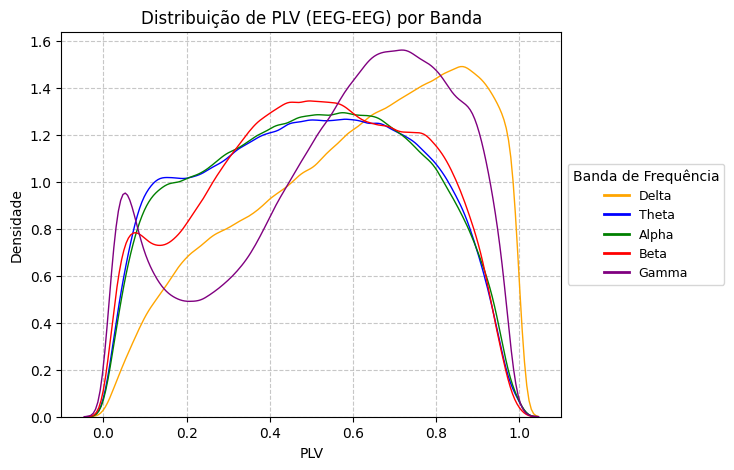

[INFO] Figura salva em: connectivity_metrics/Distribuição_de_PLV_(EEG-EEG)_por_Banda.png


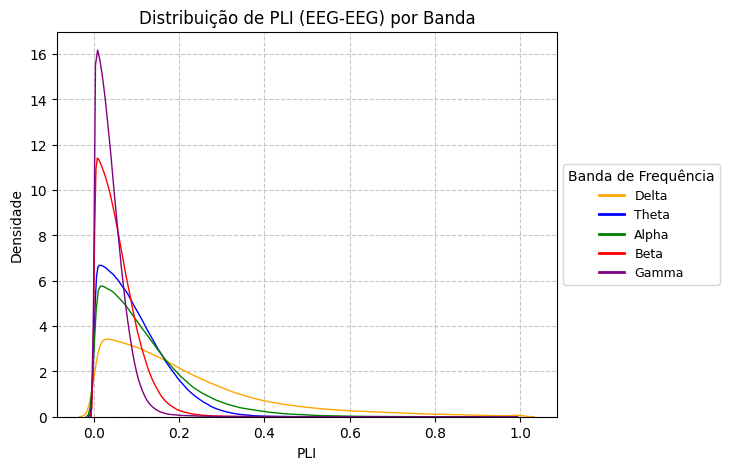

[INFO] Figura salva em: connectivity_metrics/Distribuição_de_PLI_(EEG-EEG)_por_Banda.png


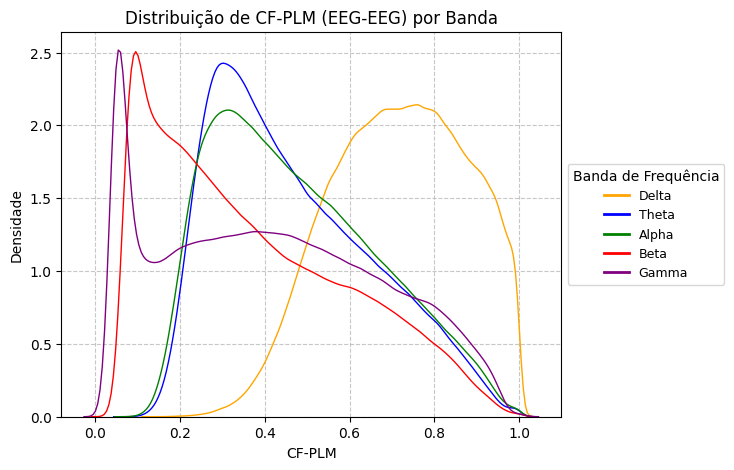

[INFO] Figura salva em: connectivity_metrics/Distribuição_de_CF-PLM_(EEG-EEG)_por_Banda.png


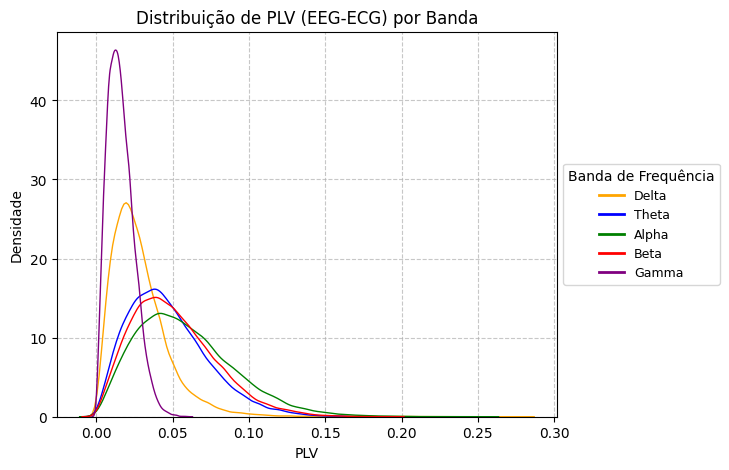

[INFO] Figura salva em: connectivity_metrics/Distribuição_de_PLV_(EEG-ECG)_por_Banda.png


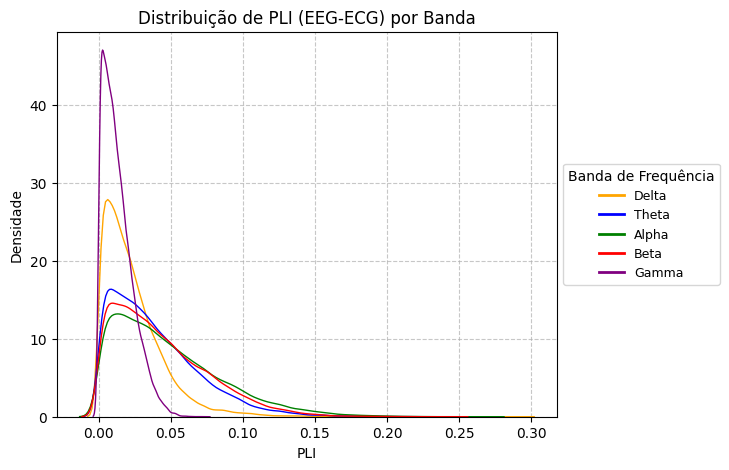

[INFO] Figura salva em: connectivity_metrics/Distribuição_de_PLI_(EEG-ECG)_por_Banda.png


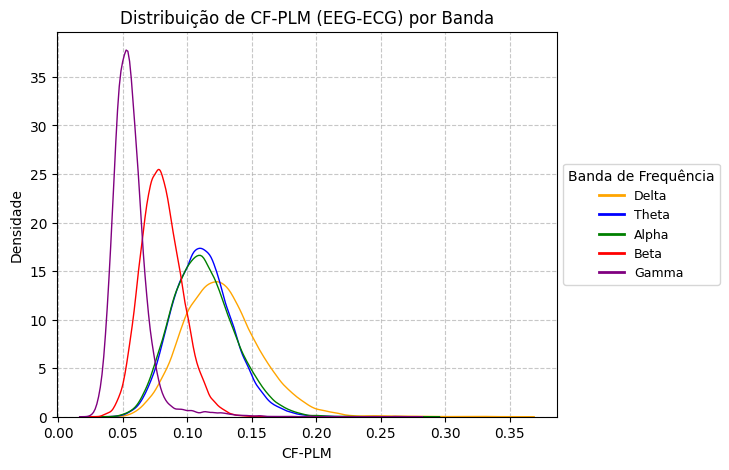

[INFO] Figura salva em: connectivity_metrics/Distribuição_de_CF-PLM_(EEG-ECG)_por_Banda.png


In [37]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Criar pasta para salvar os gráficos
save_folder = "connectivity_metrics"
os.makedirs(save_folder, exist_ok=True)

df_eeg = df[~df['channel_pair'].str.contains('ECG', na=False)].copy()  # EEG-EEG
df_ecg = df[df['channel_pair'].str.contains('ECG', na=False)].copy()   # EEG-ECG

def plot_kde_by_band(df, metric, title, xlabel):
    """Plota distribuições (KDE) do metric (plv/pli/cf_plm) por frequency_band e salva a figura."""

    if df.empty or metric not in df.columns:
        print(f"[ERRO] Sem dados para {title} ou coluna {metric} ausente.")
        return

    fig, ax = plt.subplots(figsize=(8, 5))
    fig.subplots_adjust(right=0.75)  # 🔹 Reservando espaço para a legenda

    color_legend_handles = []

    for band, color in colors.items():
        band_data = df[df['frequency_band'] == band][metric]
        if not band_data.empty:
            sns.kdeplot(
                band_data.dropna(),
                color=color,
                label=band.capitalize(),
                linewidth=1,
                alpha=1,
                ax=ax
            )

        # Criar legendas personalizadas para as bandas
        color_legend_handles.append(plt.Line2D([0], [0], color=color, linewidth=2, label=band.capitalize()))

    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Densidade')
    ax.grid(True, linestyle='--', alpha=0.7)

    # 🔹 Posicionando a legenda à direita (consistente com o primeiro código)
    ax.legend(handles=color_legend_handles, title='Banda de Frequência', fontsize=9,
              loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)

    # 🔹 Gerar nome do arquivo seguro para salvar
    filename = f"{save_folder}/{title.replace(' ', '_').replace('/', '-')}.png"

    # 🔹 Salvar figura
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

    print(f"[INFO] Figura salva em: {filename}")

# === 4) EEG-EEG: Plot de PLV, PLI, CF-PLM separados por banda ===
plot_kde_by_band(df_eeg, 'plv', 'Distribuição de PLV (EEG-EEG) por Banda', 'PLV')
plot_kde_by_band(df_eeg, 'pli', 'Distribuição de PLI (EEG-EEG) por Banda', 'PLI')
plot_kde_by_band(df_eeg, 'cf_plm', 'Distribuição de CF-PLM (EEG-EEG) por Banda', 'CF-PLM')

# === 5) EEG-ECG: Plot de PLV, PLI, CF-PLM separados por banda ===
plot_kde_by_band(df_ecg, 'plv', 'Distribuição de PLV (EEG-ECG) por Banda', 'PLV')
plot_kde_by_band(df_ecg, 'pli', 'Distribuição de PLI (EEG-ECG) por Banda', 'PLI')
plot_kde_by_band(df_ecg, 'cf_plm', 'Distribuição de CF-PLM (EEG-ECG) por Banda', 'CF-PLM')

In [38]:
!zip -r connectivity_metrics.zip /content/connectivity_metrics/

updating: content/connectivity_metrics/ (stored 0%)
updating: content/connectivity_metrics/Distribuição_de_PLI_(EEG-ECG)_por_Banda.png (deflated 13%)
updating: content/connectivity_metrics/Distribuição_de_CF-PLM_(EEG-EEG)_por_Banda.png (deflated 6%)
updating: content/connectivity_metrics/Distribuição_de_PLI_(EEG-EEG)_por_Banda.png (deflated 13%)
updating: content/connectivity_metrics/Distribuição_de_PLV_(EEG-EEG)_por_Banda.png (deflated 6%)
updating: content/connectivity_metrics/Distribuição_de_CF-PLM_(EEG-ECG)_por_Banda.png (deflated 11%)
updating: content/connectivity_metrics/Distribuição_de_PLV_(EEG-ECG)_por_Banda.png (deflated 13%)


In [39]:
# Parâmetros e configuração
ATHLETES = ['athlete_1', 'athlete_2', 'athlete_3', 'athlete_4', 'athlete_5', 'athlete_6', 'athlete_7']
CONDITIONS = ['pre_sham', 'post_sham', 'pre_cathodic', 'post_cathodic']
WINDOW_SIZE = 10  # segundos
FREQUENCY_BANDS = {
    'delta': [0.5, 4],
    'theta': [4, 8],
    'alpha': [8, 13],
    'beta': [13, 30],
    'gamma': [30, 60]
}

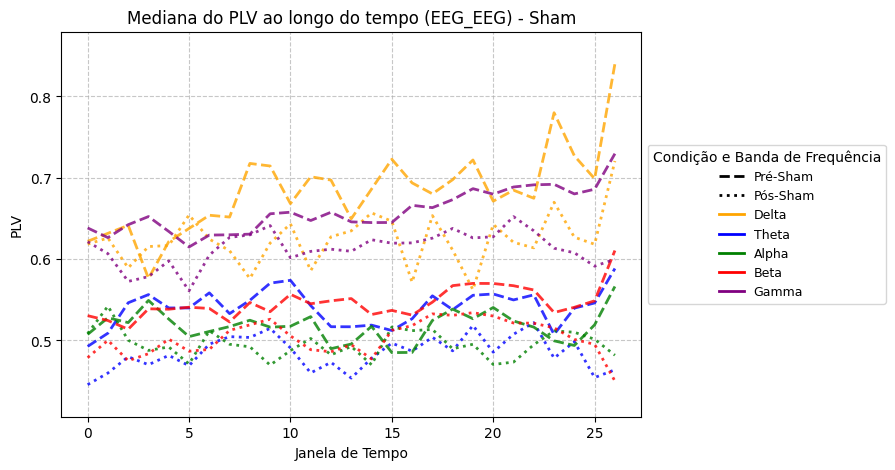

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_EEG)_Sham.png


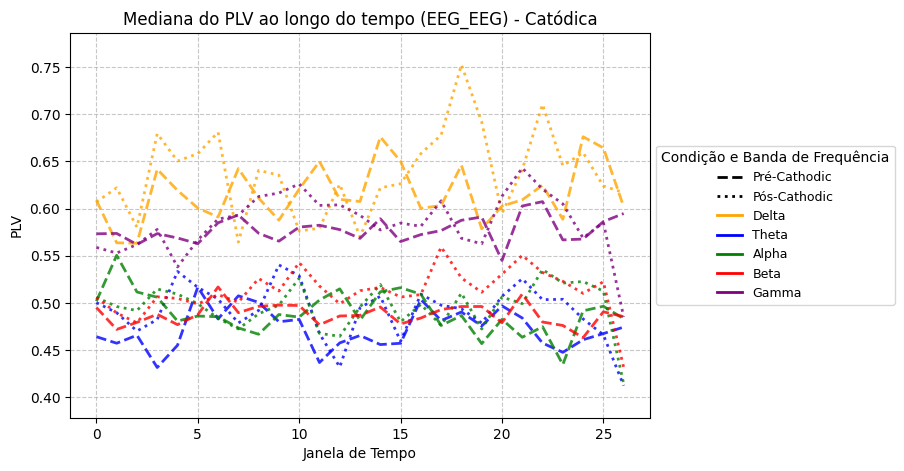

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_EEG)_Catódica.png


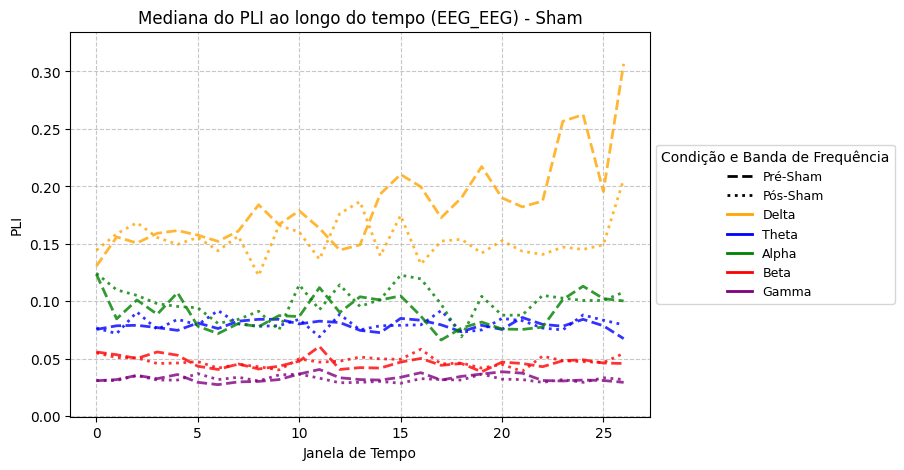

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_EEG)_Sham.png


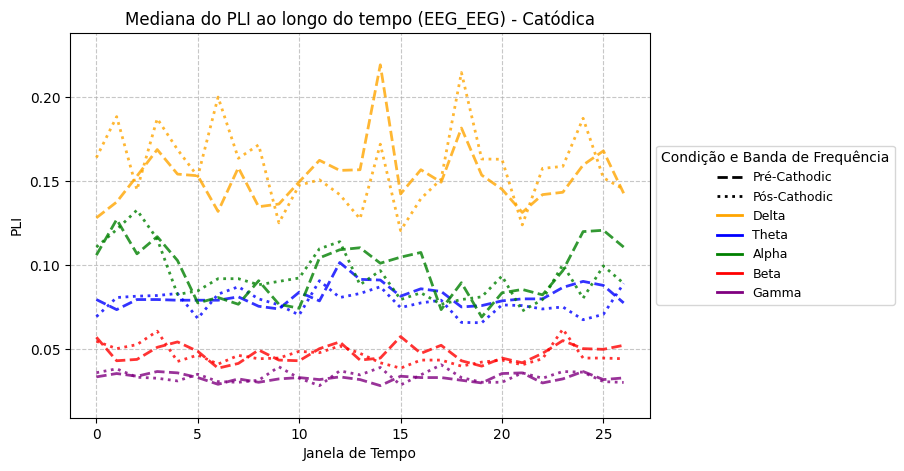

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_EEG)_Catódica.png


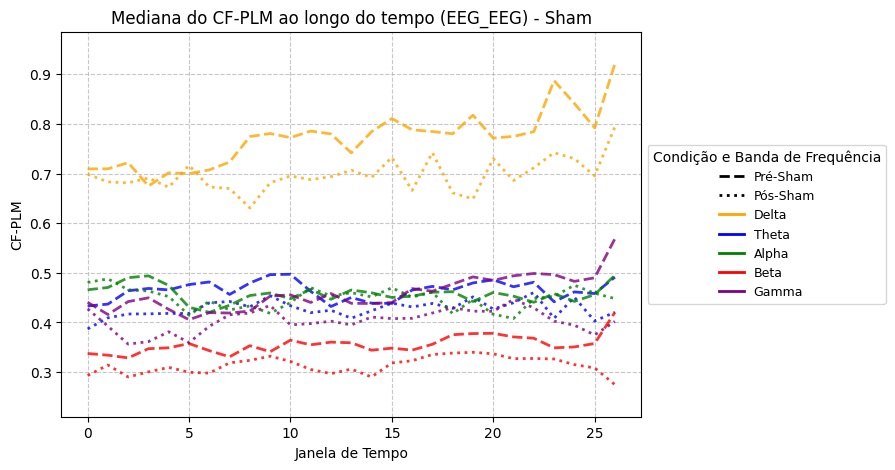

[INFO] Figura salva em: connectivity_over_time/Mediana_do_CF-PLM_ao_longo_do_tempo_(EEG_EEG)_Sham.png


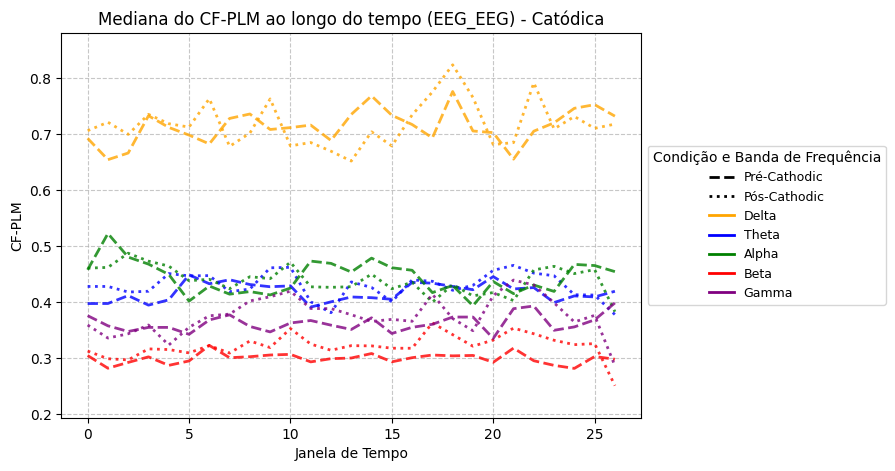

[INFO] Figura salva em: connectivity_over_time/Mediana_do_CF-PLM_ao_longo_do_tempo_(EEG_EEG)_Catódica.png


In [40]:
import os
import matplotlib.pyplot as plt

def plot_median_metric_over_time(df, channel_type, metric, title, ylabel):
    """
    Plota a **mediana** da métrica escolhida ao longo do tempo para um channel_type específico.
    """

    df_selected = df[df['channel_type'] == channel_type]

    if df_selected.empty or metric not in df_selected.columns:
        print(f"[ERRO] Sem dados para {title} ou coluna {metric} ausente.")
        return

    save_folder = "connectivity_over_time"
    os.makedirs(save_folder, exist_ok=True)

    condition_styles = {
        'pre_sham': {'linestyle': '--', 'label': 'Pré-Sham'},
        'post_sham': {'linestyle': ':', 'label': 'Pós-Sham'},
        'pre_cathodic': {'linestyle': '--', 'label': 'Pré-Cathodic'},
        'post_cathodic': {'linestyle': ':', 'label': 'Pós-Cathodic'}
    }

    condition_pairs = [
        ('pre_sham', 'post_sham', 'Sham'),
        ('pre_cathodic', 'post_cathodic', 'Catódica')
    ]

    for cond1, cond2, cond_name in condition_pairs:
        fig, ax = plt.subplots(figsize=(8, 5))
        fig.subplots_adjust(right=0.85)

        color_legend_handles = []
        linestyle_legend_handles = []

        y_min, y_max = float('inf'), float('-inf')  # 🔹 Guardar valores extremos para ajuste dinâmico

        for band, color in colors.items():
            color_legend_handles.append(plt.Line2D([0], [0], color=color, linewidth=2, label=band.capitalize()))

            for condition in [cond1, cond2]:
                band_data = df_selected[(df_selected['frequency_band'] == band) &
                                        (df_selected['condition'] == condition)]

                if not band_data.empty:
                    median_values = band_data.groupby('time_window')[metric].median()

                    # 🔹 Atualizar valores extremos
                    y_min = min(y_min, median_values.min())
                    y_max = max(y_max, median_values.max())

                    line_style = condition_styles[condition]['linestyle']
                    ax.plot(median_values.index, median_values.values,
                            color=color, linestyle=line_style, linewidth=2, alpha=0.8)

                if band == list(colors.keys())[0]:
                    linestyle_legend_handles.append(
                        plt.Line2D([0], [0], color='black', linestyle=line_style, linewidth=2, label=condition_styles[condition]['label'])
                    )

        # 🔹 Aplicar limite dinâmico ao eixo Y com margem de segurança
        margin = (y_max - y_min) * 0.1  # 🔹 Adiciona 10% de margem para evitar cortes no gráfico
        ax.set_ylim(y_min - margin, y_max + margin)

        ax.set_title(f'{title} - {cond_name}')
        ax.set_xlabel('Janela de Tempo')
        ax.set_ylabel(ylabel)
        ax.grid(True, linestyle='--', alpha=0.7)

        ax.legend(handles=linestyle_legend_handles + color_legend_handles, title='Condição e Banda de Frequência', fontsize=9,
                  loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)

        filename = f"{save_folder}/{title.replace(' ', '_').replace('/', '-')}_{cond_name}.png"
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()

        print(f"[INFO] Figura salva em: {filename}")

# Definir channel_type
channel_type = "EEG_EEG"

# === 4) Gerar gráficos para cada métrica ===
plot_median_metric_over_time(df, channel_type, 'plv', f'Mediana do PLV ao longo do tempo ({channel_type})', 'PLV')
plot_median_metric_over_time(df, channel_type, 'pli', f'Mediana do PLI ao longo do tempo ({channel_type})', 'PLI')
plot_median_metric_over_time(df, channel_type, 'cf_plm', f'Mediana do CF-PLM ao longo do tempo ({channel_type})', 'CF-PLM')

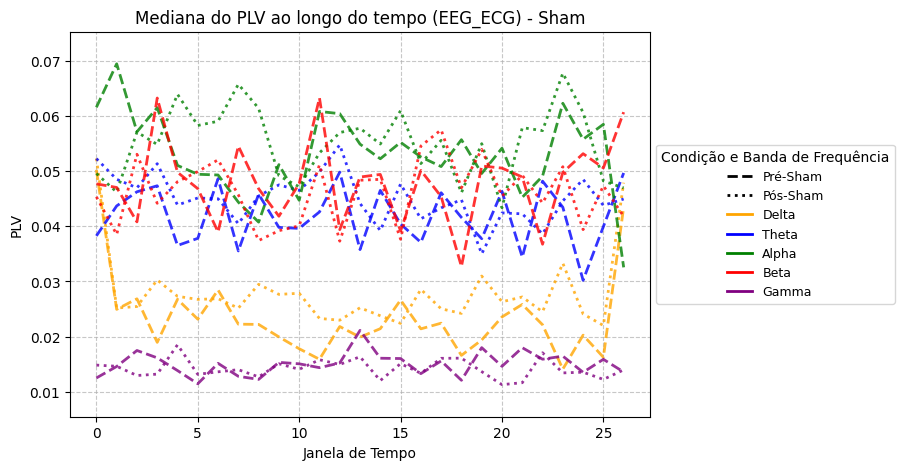

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_ECG)_Sham.png


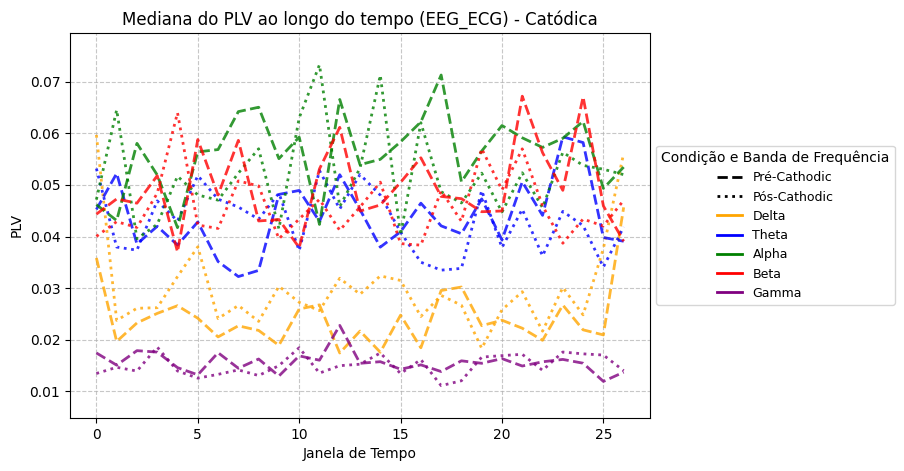

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_ECG)_Catódica.png


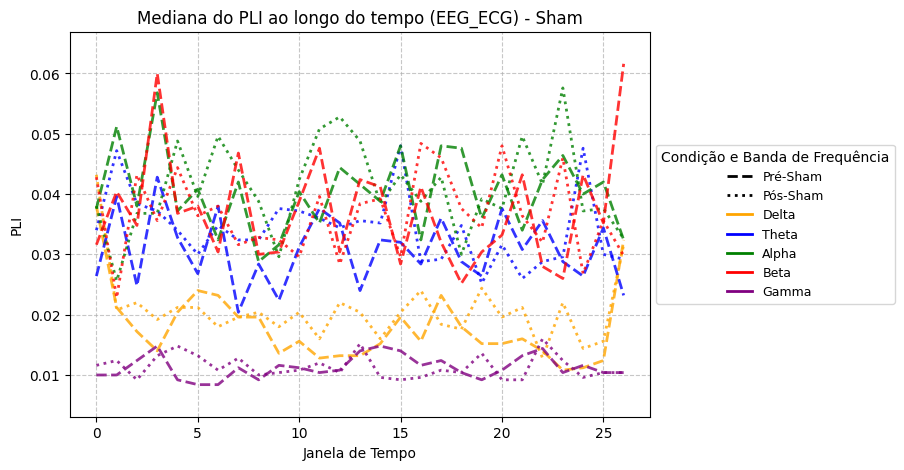

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_ECG)_Sham.png


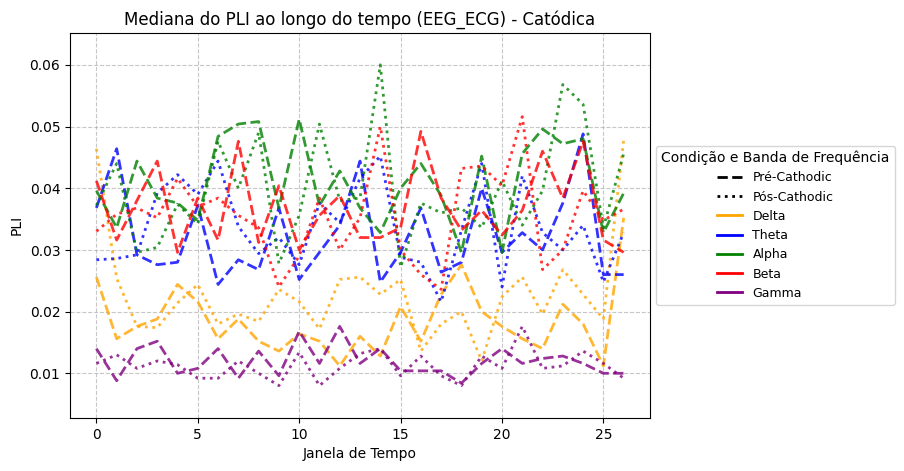

[INFO] Figura salva em: connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_ECG)_Catódica.png


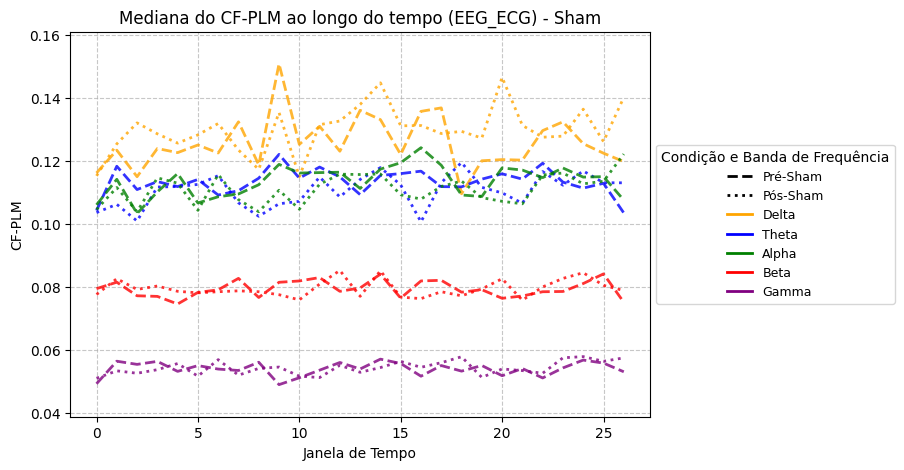

[INFO] Figura salva em: connectivity_over_time/Mediana_do_CF-PLM_ao_longo_do_tempo_(EEG_ECG)_Sham.png


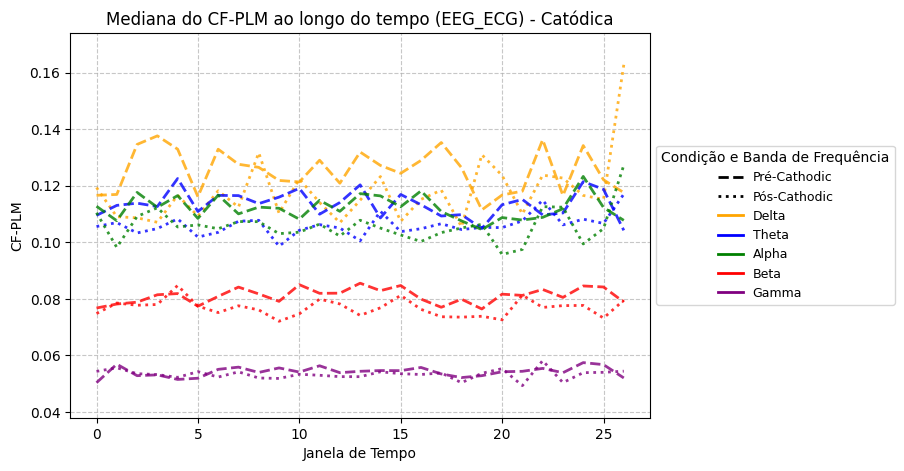

[INFO] Figura salva em: connectivity_over_time/Mediana_do_CF-PLM_ao_longo_do_tempo_(EEG_ECG)_Catódica.png


In [41]:
# Definir channel_type
channel_type = "EEG_ECG"

# === 4) Gerar gráficos para cada métrica ===
plot_median_metric_over_time(df, channel_type, 'plv', f'Mediana do PLV ao longo do tempo ({channel_type})', 'PLV')
plot_median_metric_over_time(df, channel_type, 'pli', f'Mediana do PLI ao longo do tempo ({channel_type})', 'PLI')
plot_median_metric_over_time(df, channel_type, 'cf_plm', f'Mediana do CF-PLM ao longo do tempo ({channel_type})', 'CF-PLM')

In [42]:
!zip -r connectivity_over_time.zip /content/connectivity_over_time

updating: content/connectivity_over_time/ (stored 0%)
updating: content/connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_EEG)_Catódica.png (deflated 5%)
updating: content/connectivity_over_time/Mediana_do_CF-PLM_ao_longo_do_tempo_(EEG_ECG)_Catódica.png (deflated 7%)
updating: content/connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_ECG)_Sham.png (deflated 4%)
updating: content/connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_ECG)_Catódica.png (deflated 4%)
updating: content/connectivity_over_time/Mediana_do_CF-PLM_ao_longo_do_tempo_(EEG_EEG)_Catódica.png (deflated 8%)
updating: content/connectivity_over_time/Mediana_do_PLI_ao_longo_do_tempo_(EEG_EEG)_Catódica.png (deflated 6%)
updating: content/connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_ECG)_Catódica.png (deflated 4%)
updating: content/connectivity_over_time/Mediana_do_PLV_ao_longo_do_tempo_(EEG_EEG)_Sham.png (deflated 6%)
updating: content/connectivity_over_time/Mediana_do_CF-PLM_a

In [43]:
import pandas as pd
import numpy as np

# === 1) Fazer cópia e aplicar transformações iniciais ===
df = df.copy()

# === 2) Determinar Tipo de Canal (EEG_EEG ou EEG_ECG) ===
df['channel_pair_type'] = df['channel_pair'].apply(
    lambda x: 'EEG_ECG' if 'ECG' in x else 'EEG_EEG'
)

# === 3) AGRUPAR E CALCULAR MEDIANAS ENTRE TIME WINDOWS ===
group_cols = ['athlete', 'frequency_band', 'condition', 'channel_pair', 'channel_pair_type']

agg_df = (
    df.groupby(group_cols, as_index=False)
      .agg(
          median_plv=('plv', 'median'),
          median_pli=('pli', 'median'),
          median_cf_plm=('cf_plm', 'median')
      )
)

print("\n[INFO] Agregação concluída. Exibindo as primeiras linhas de agg_df:")
agg_df


[INFO] Agregação concluída. Exibindo as primeiras linhas de agg_df:


,athlete,frequency_band,condition,channel_pair,channel_pair_type,median_plv,median_pli,median_cf_plm
0,athlete_1,alpha,post_cathodic,AF3_AF4,EEG_EEG,0.310135,0.0836,0.273417
1,athlete_1,alpha,post_cathodic,AF3_AFz,EEG_EEG,0.654856,0.0400,0.539971
2,athlete_1,alpha,post_cathodic,AF3_C1,EEG_EEG,0.137658,0.0548,0.230753
3,athlete_1,alpha,post_cathodic,AF3_C2,EEG_EEG,0.528261,0.0556,0.409973
4,athlete_1,alpha,post_cathodic,AF3_C5,EEG_EEG,0.175020,0.0736,0.259842
...,...,...,...,...,...,...,...,...
255280,athlete_7,theta,pre_sham,TTP8h_ECG,EEG_ECG,0.044580,0.0384,0.107613
255281,athlete_7,theta,pre_sham,TTP8h_F2,EEG_EEG,0.404123,0.0628,0.372486
255282,athlete_7,theta,pre_sham,TTP8h_F6,EEG_EEG,0.696920,0.0952,0.597143
255283,athlete_7,theta,pre_sham,TTP8h_FC4,EEG_EEG,0.710109,0.0724,0.615393


In [44]:
# === 1) Contar ocorrências válidas (não NaN e > 0) para PLV, PLI e CF-PLM ===
metric_counts_agg = (
    agg_df.assign(
        plv_valid=lambda x: x['median_plv'].notna() & (x['median_plv'] > 0),
        pli_valid=lambda x: x['median_pli'].notna() & (x['median_pli'] > 0),
        cf_plm_valid=lambda x: x['median_cf_plm'].notna() & (x['median_cf_plm'] > 0)
    )
    .groupby(['channel_pair', 'condition'])
    .agg(
        plv_count=('plv_valid', 'sum'),
        pli_count=('pli_valid', 'sum'),
        cf_plm_count=('cf_plm_valid', 'sum')
    )
    .reset_index()
)

# === 2) Pivotar para obter colunas separadas para cada condition e métrica ===
metric_counts_agg_pivot = metric_counts_agg.pivot(
    index='channel_pair',
    columns='condition',
    values=['plv_count', 'pli_count', 'cf_plm_count']
).fillna(0)

# === 3) Ajustar nomes de colunas ===
metric_counts_agg_pivot.columns = [
    f"{metric}_{condition}" for metric, condition in metric_counts_agg_pivot.columns
]

# === 4) Resetar índice para exibir corretamente ===
metric_counts_agg_pivot = metric_counts_agg_pivot.reset_index()

# === 5) Exibir resultado ===
print("\n[INFO] Contagem de PLV, PLI e CF-PLM por channel_pair e condition:")
metric_counts_agg_pivot


[INFO] Contagem de PLV, PLI e CF-PLM por channel_pair e condition:


,channel_pair,plv_count_post_cathodic,plv_count_post_sham,plv_count_pre_cathodic,plv_count_pre_sham,pli_count_post_cathodic,pli_count_post_sham,pli_count_pre_cathodic,pli_count_pre_sham,cf_plm_count_post_cathodic,cf_plm_count_post_sham,cf_plm_count_pre_cathodic,cf_plm_count_pre_sham
0,AF3_AF4,30,35,35,35,30,35,35,35,30,35,35,35
1,AF3_AFz,30,35,35,35,30,35,35,35,30,35,35,35
2,AF3_C1,30,35,35,35,30,35,35,35,30,35,35,35
3,AF3_C2,30,35,35,35,30,35,35,35,30,35,35,35
4,AF3_C5,30,35,35,35,30,35,35,35,30,35,35,35
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1886,TTP8h_ECG,30,35,35,35,30,35,35,35,30,35,35,35
1887,TTP8h_F2,30,35,35,35,30,35,35,35,30,35,35,35
1888,TTP8h_F6,30,35,35,35,30,35,35,35,30,35,35,35
1889,TTP8h_FC4,30,35,35,35,30,35,35,35,30,35,35,35


In [45]:
# === 1) Separar 'time' (pre/post) e 'cond' (sham/cathodic) ===
agg_df[['time', 'cond']] = agg_df['condition'].str.split('_', expand=True)

# === 2) Pivot para organizar os dados considerando também o channel_pair ===
df_pivot = agg_df.pivot_table(
    index=["athlete", "frequency_band", "channel_pair", "channel_pair_type", "cond"],
    columns="time",
    values=["median_plv", "median_pli", "median_cf_plm"]
).reset_index()

# === 3) Calcula a diferença (post - pre) para cada métrica (PLV, PLI, CF-PLM) ===
df_pivot["median_plv_diff"] = df_pivot[("median_plv", "post")] - df_pivot[("median_plv", "pre")]
df_pivot["median_pli_diff"] = df_pivot[("median_pli", "post")] - df_pivot[("median_pli", "pre")]
df_pivot["median_cf_plm_diff"] = df_pivot[("median_cf_plm", "post")] - df_pivot[("median_cf_plm", "pre")]

# === 4) Seleciona e renomeia as colunas finais desejadas ===
df_final = df_pivot[[
    "athlete", "frequency_band", "channel_pair", "channel_pair_type", "cond",
    "median_plv_diff", "median_pli_diff", "median_cf_plm_diff"
]].rename(columns={"cond": "condition"})

# === 5) Separar 'channel_pair' em 'channel_1' e 'channel_2' ===
df_final[['channel_1', 'channel_2']] = df_final['channel_pair'].str.split('_', expand=True)

# === 6) Salvar como CSV ===
df_final.to_csv('plv_pli_cf_plm_diffs.csv', index=False)
print("[INFO] Arquivo 'plv_pli_cf_plm_diffs.csv' salvo com sucesso!")

# === 7) Exibir o DataFrame final ===
df_final

[INFO] Arquivo 'plv_pli_cf_plm_diffs.csv' salvo com sucesso!


,athlete,frequency_band,channel_pair,channel_pair_type,condition,median_plv_diff,median_pli_diff,median_cf_plm_diff,channel_1,channel_2
time,,,,,,,,,,
0,athlete_1,alpha,AF3_AF4,EEG_EEG,cathodic,-0.037006,0.0048,-0.037367,AF3,AF4
1,athlete_1,alpha,AF3_AF4,EEG_EEG,sham,-0.073028,-0.0190,-0.043164,AF3,AF4
2,athlete_1,alpha,AF3_AFz,EEG_EEG,cathodic,0.218275,-0.0556,0.185118,AF3,AFz
3,athlete_1,alpha,AF3_AFz,EEG_EEG,sham,-0.182684,0.0214,-0.195448,AF3,AFz
4,athlete_1,alpha,AF3_C1,EEG_EEG,cathodic,0.021820,-0.0372,0.000713,AF3,C1
...,...,...,...,...,...,...,...,...,...,...
132365,athlete_7,theta,TTP8h_F6,EEG_EEG,sham,-0.102083,-0.0278,-0.085960,TTP8h,F6
132366,athlete_7,theta,TTP8h_FC4,EEG_EEG,cathodic,0.044841,0.0120,0.046663,TTP8h,FC4
132367,athlete_7,theta,TTP8h_FC4,EEG_EEG,sham,0.076322,-0.0034,0.093866,TTP8h,FC4


In [46]:
df_filtered = df_final[~((df_final['athlete'] == 'athlete_6') & (df_final['condition'] == 'cathodic'))]
df_filtered.to_csv('plv_pli_cf_plm_diffs.csv')

In [47]:
df_filtered[(df_filtered['channel_pair'] == 'C3_TP9') & (df_filtered['frequency_band'] == 'alpha')]

,athlete,frequency_band,channel_pair,channel_pair_type,condition,median_plv_diff,median_pli_diff,median_cf_plm_diff,channel_1,channel_2
time,,,,,,,,,,
340,athlete_1,alpha,C3_TP9,EEG_EEG,cathodic,0.013311,0.0112,0.017395,C3,TP9
341,athlete_1,alpha,C3_TP9,EEG_EEG,sham,0.116525,0.0144,0.151997,C3,TP9
19250,athlete_2,alpha,C3_TP9,EEG_EEG,cathodic,0.012669,0.0020,0.018439,C3,TP9
19251,athlete_2,alpha,C3_TP9,EEG_EEG,sham,0.008730,0.0052,0.013147,C3,TP9
38160,athlete_3,alpha,C3_TP9,EEG_EEG,cathodic,0.079190,0.0284,0.107062,C3,TP9
38161,athlete_3,alpha,C3_TP9,EEG_EEG,sham,0.143077,0.0574,0.131656,C3,TP9
57070,athlete_4,alpha,C3_TP9,EEG_EEG,cathodic,-0.728188,-0.0828,-0.609765,C3,TP9
57071,athlete_4,alpha,C3_TP9,EEG_EEG,sham,-0.046870,-0.0044,-0.071437,C3,TP9
75980,athlete_5,alpha,C3_TP9,EEG_EEG,cathodic,0.494494,0.0104,0.379059,C3,TP9


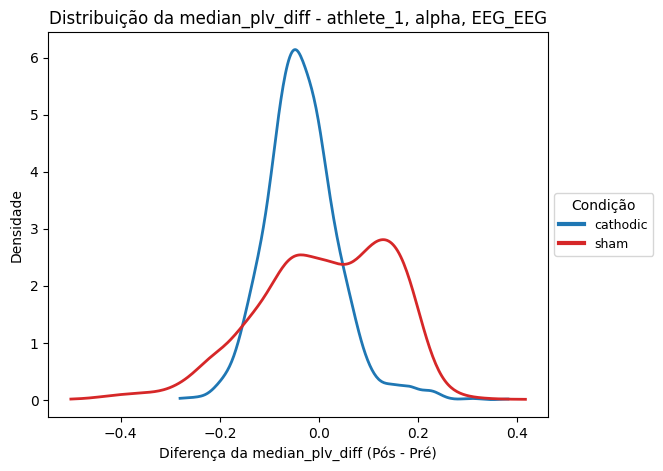

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_1_alpha_EEG_EEG.png


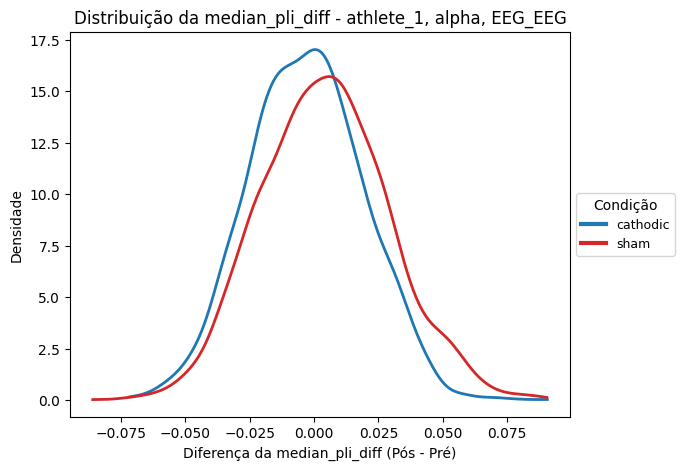

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_1_alpha_EEG_EEG.png


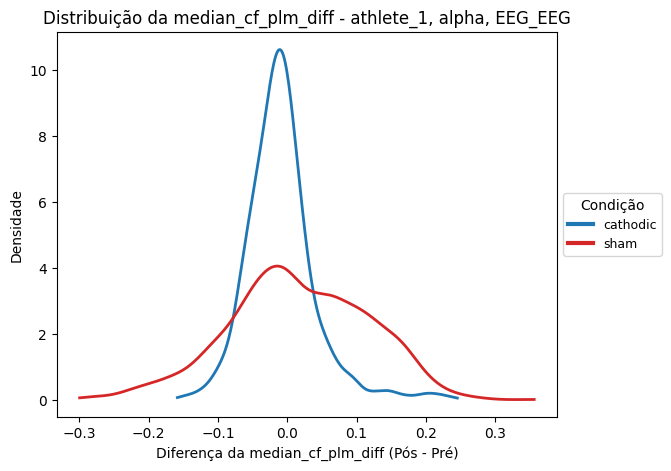

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_alpha_EEG_EEG.png


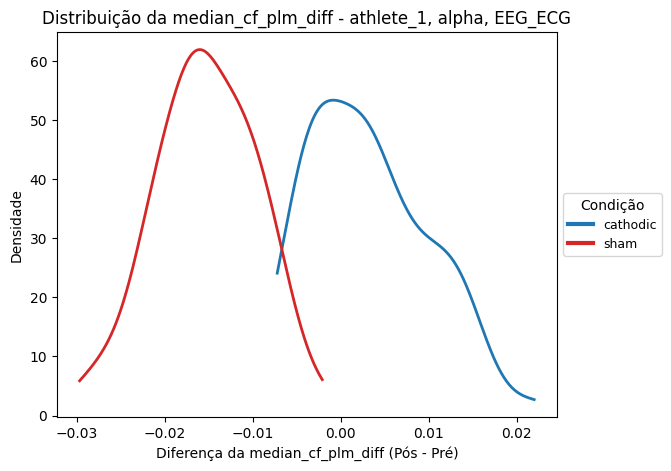

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_alpha_EEG_ECG.png


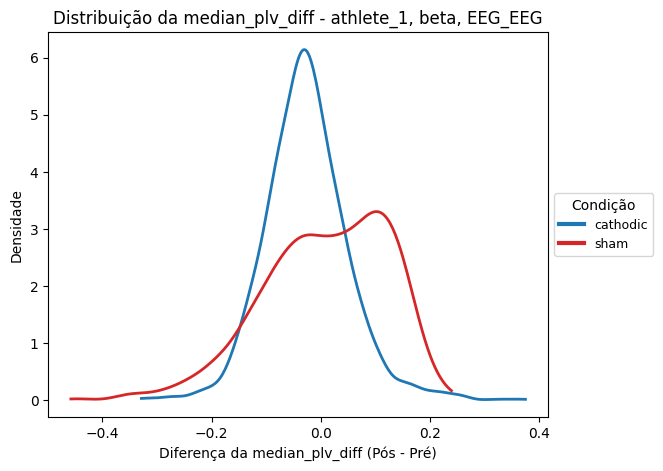

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_1_beta_EEG_EEG.png


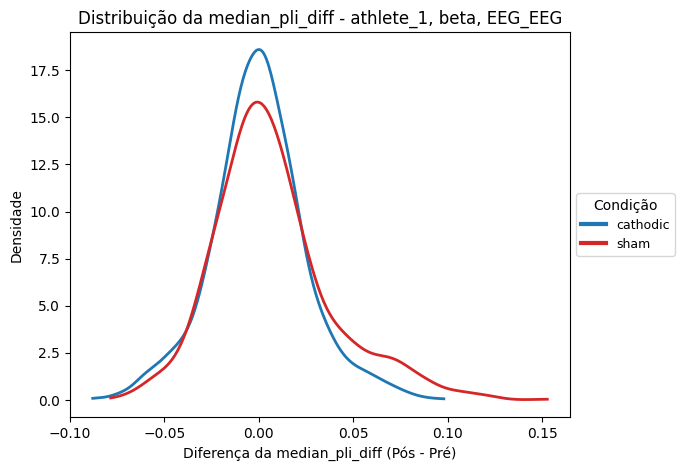

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_1_beta_EEG_EEG.png


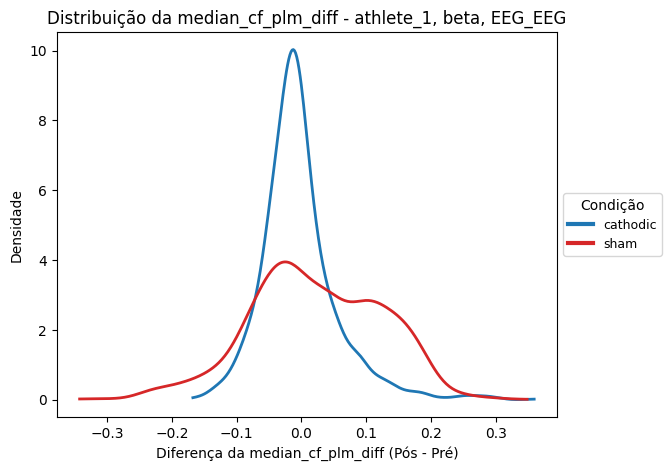

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_beta_EEG_EEG.png


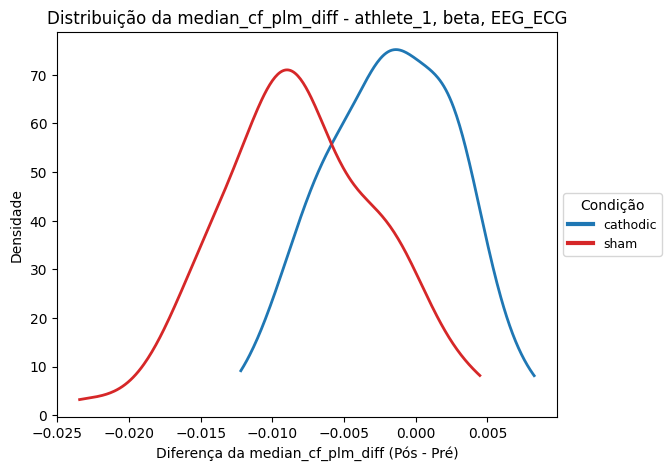

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_beta_EEG_ECG.png


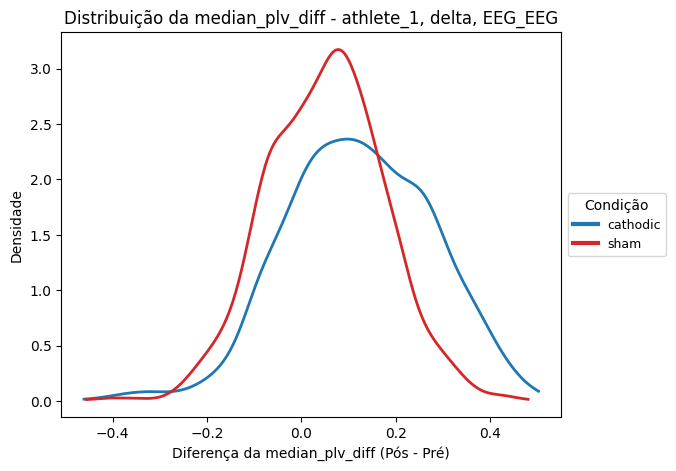

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_1_delta_EEG_EEG.png


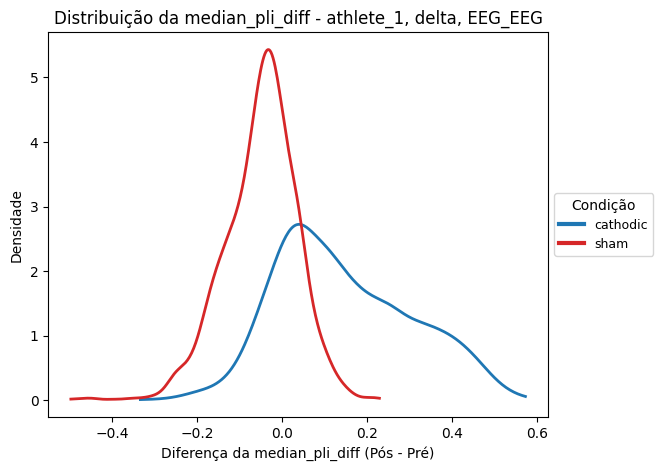

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_1_delta_EEG_EEG.png


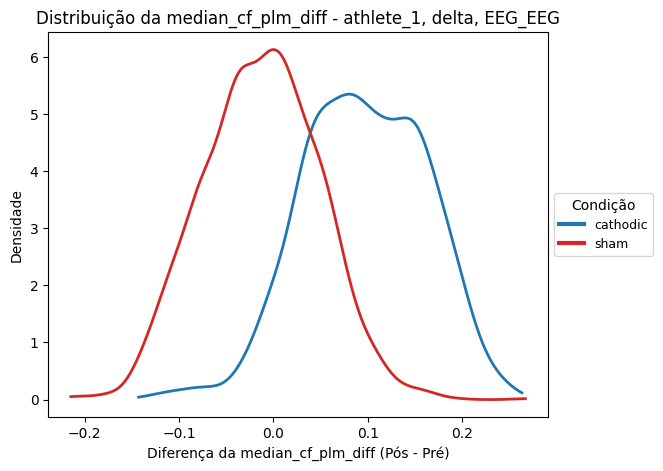

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_delta_EEG_EEG.png


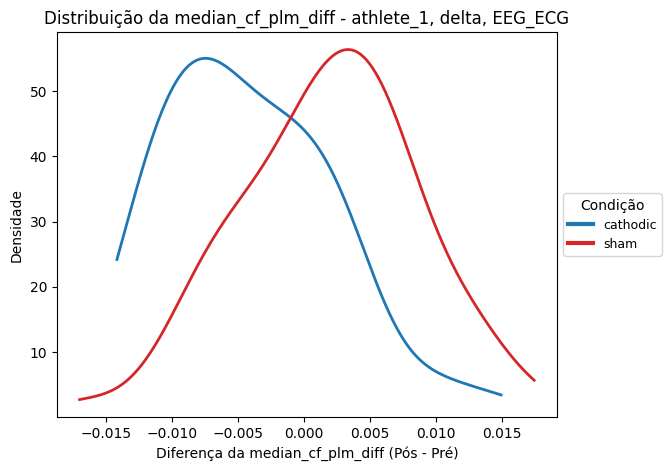

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_delta_EEG_ECG.png


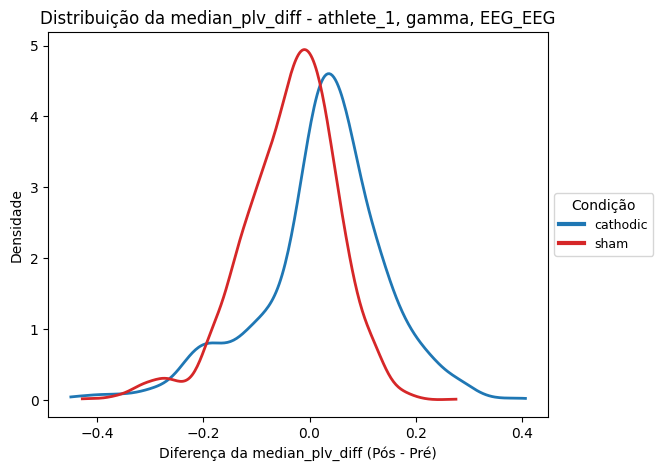

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_1_gamma_EEG_EEG.png


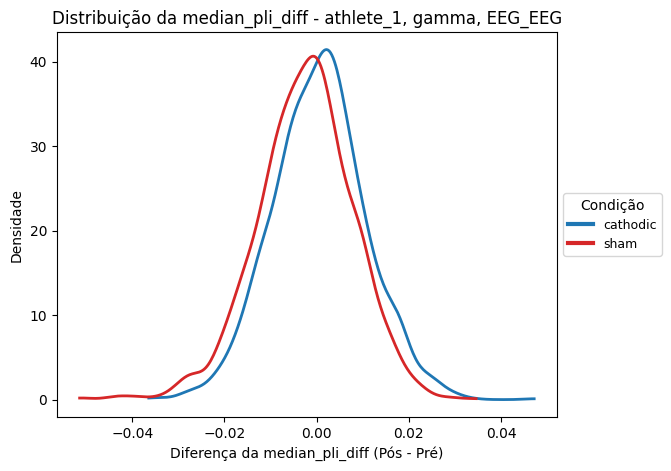

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_1_gamma_EEG_EEG.png


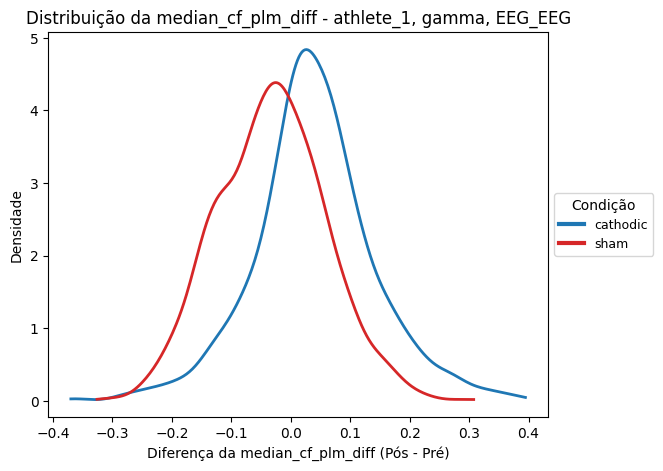

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_gamma_EEG_EEG.png


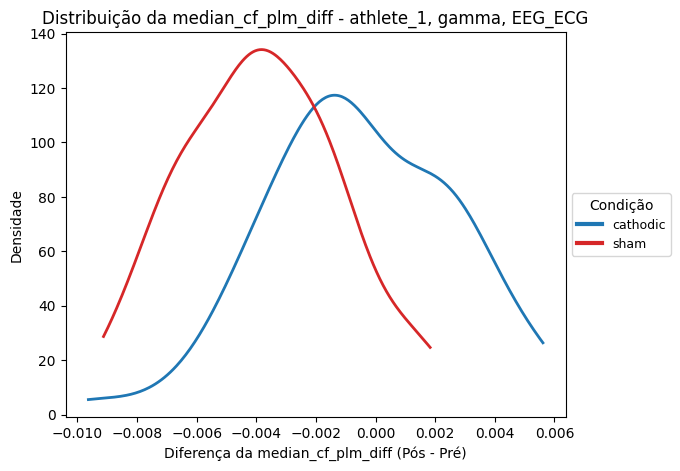

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_gamma_EEG_ECG.png


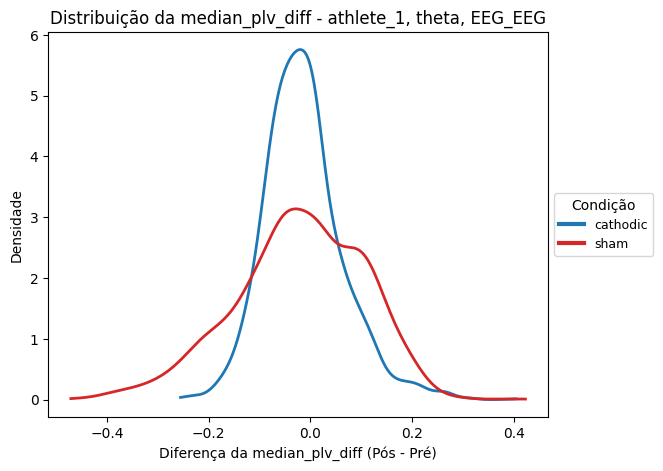

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_1_theta_EEG_EEG.png


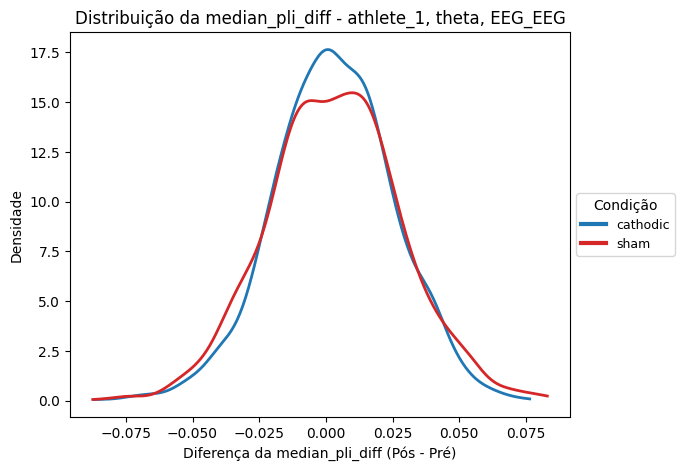

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_1_theta_EEG_EEG.png


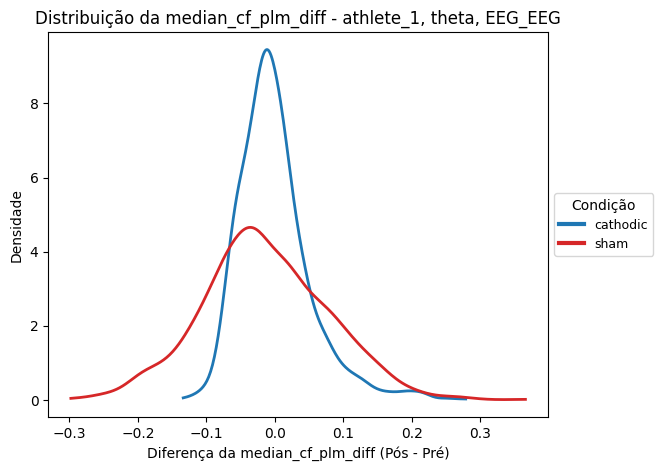

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_theta_EEG_EEG.png


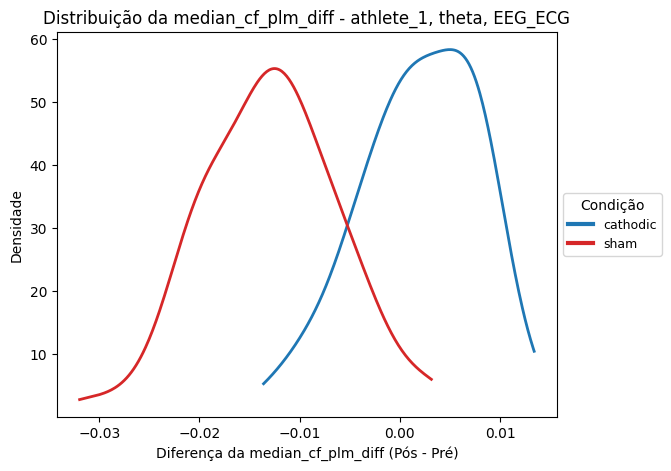

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_1_theta_EEG_ECG.png


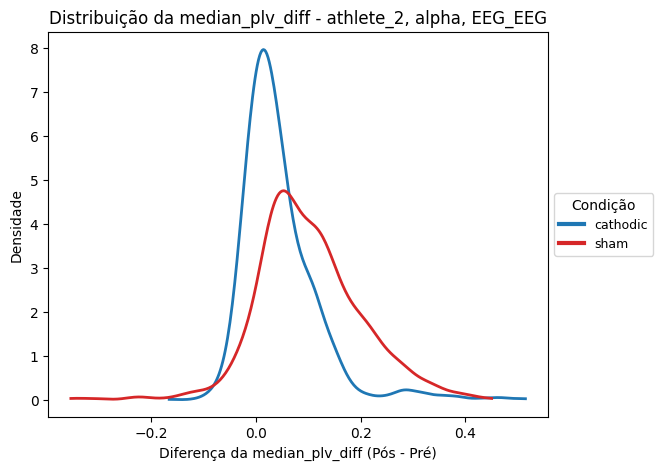

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_2_alpha_EEG_EEG.png


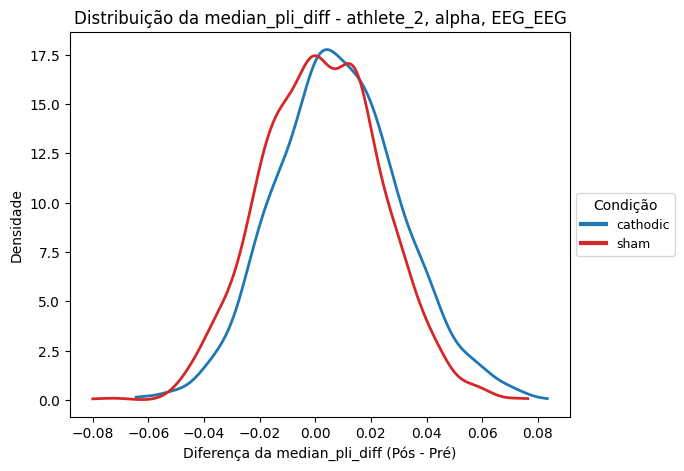

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_2_alpha_EEG_EEG.png


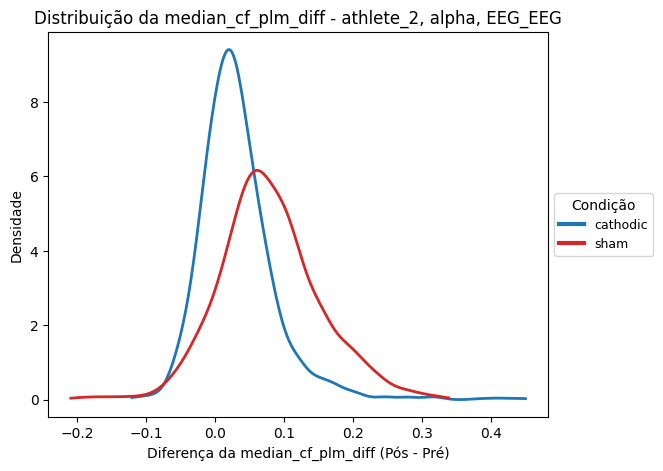

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_alpha_EEG_EEG.png


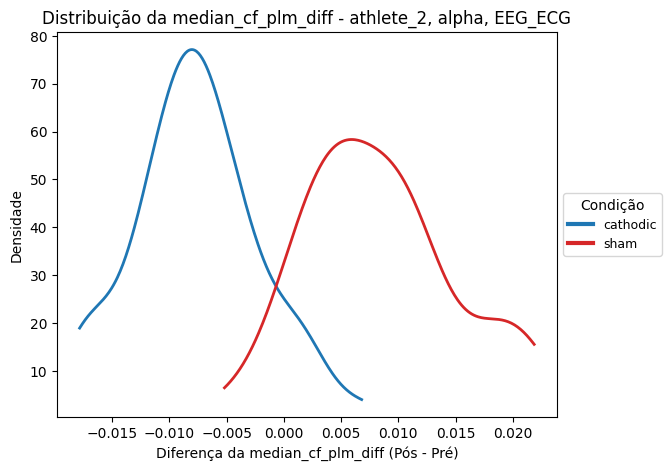

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_alpha_EEG_ECG.png


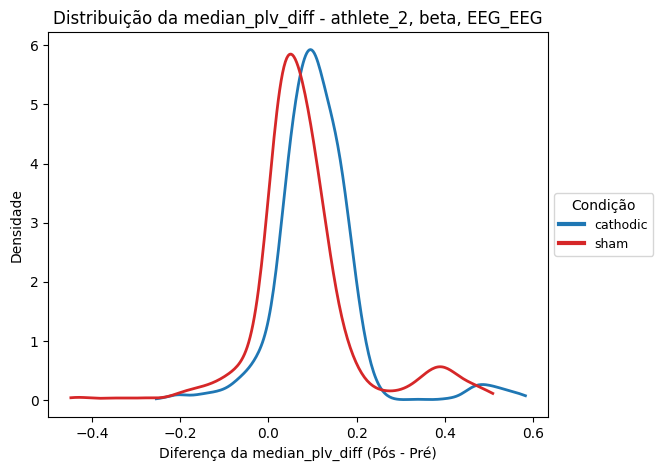

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_2_beta_EEG_EEG.png


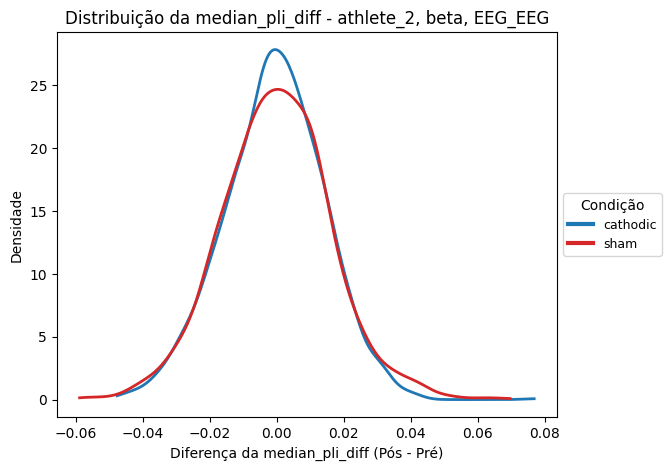

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_2_beta_EEG_EEG.png


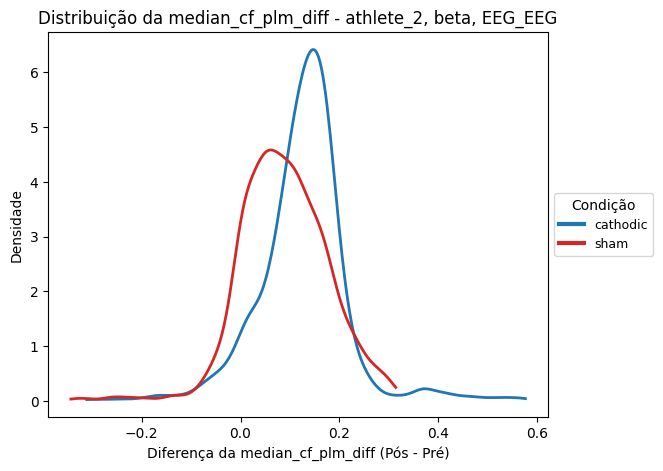

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_beta_EEG_EEG.png


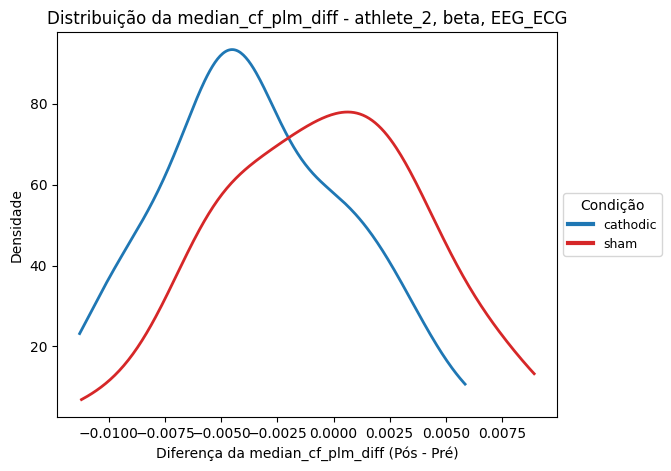

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_beta_EEG_ECG.png


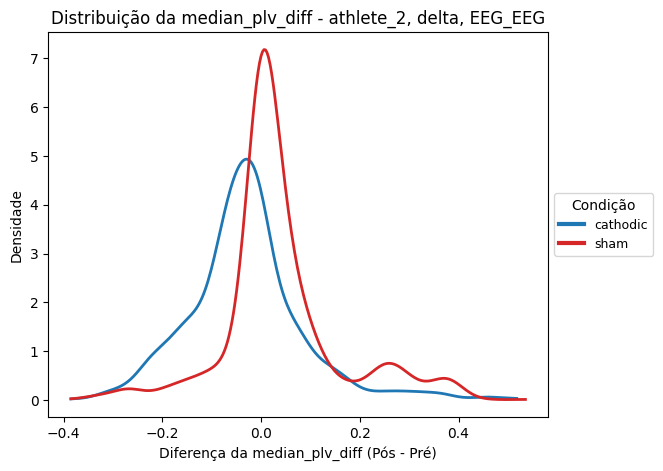

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_2_delta_EEG_EEG.png


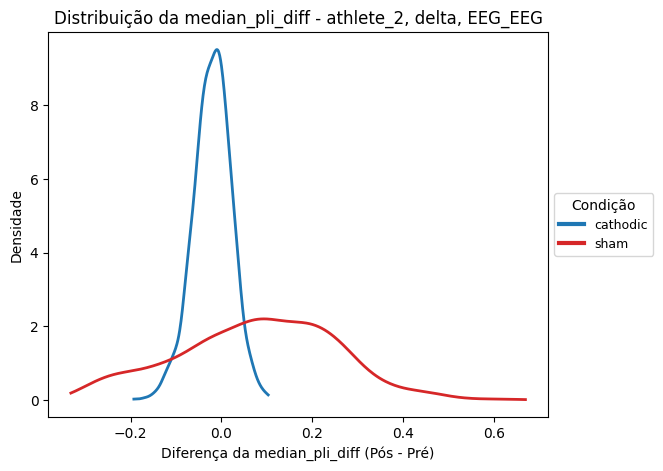

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_2_delta_EEG_EEG.png


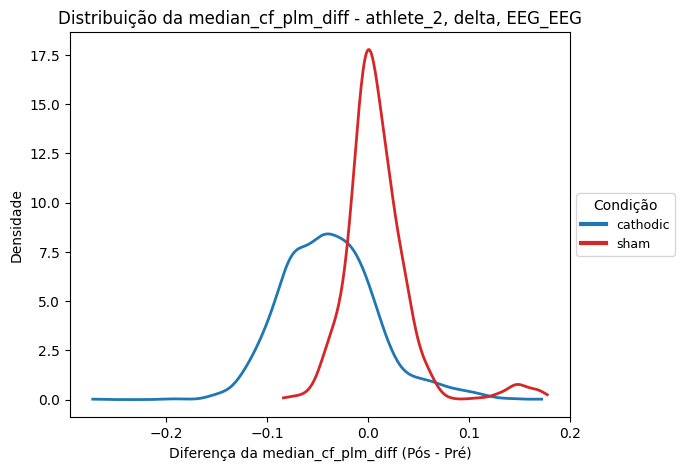

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_delta_EEG_EEG.png


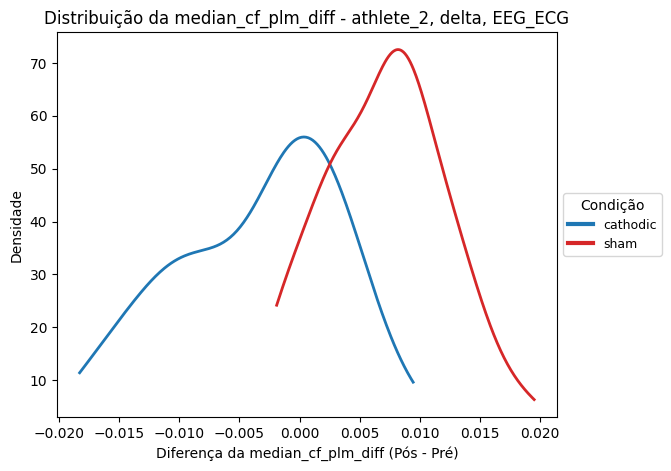

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_delta_EEG_ECG.png


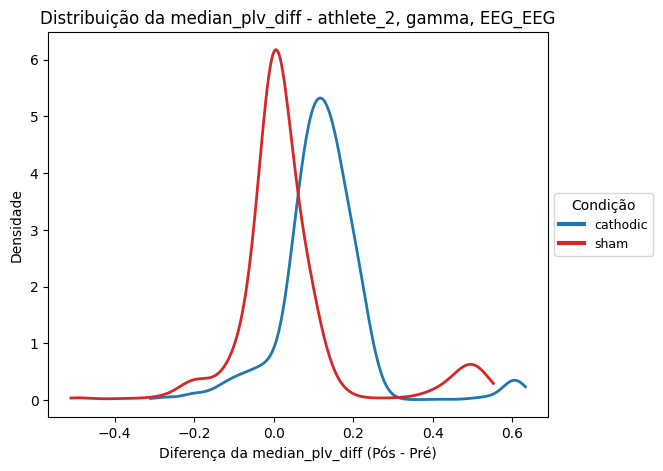

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_2_gamma_EEG_EEG.png


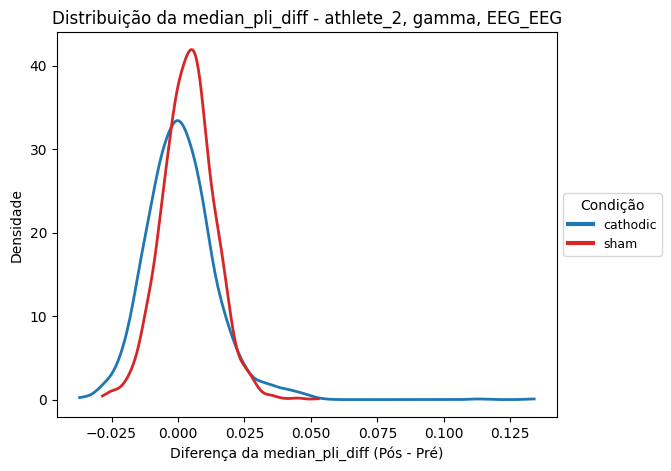

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_2_gamma_EEG_EEG.png


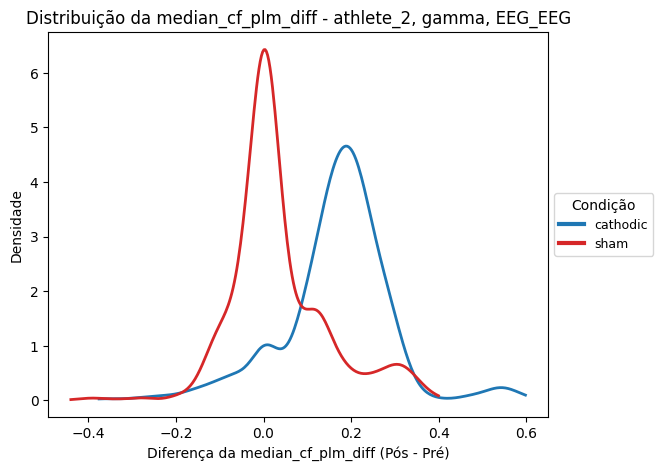

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_gamma_EEG_EEG.png


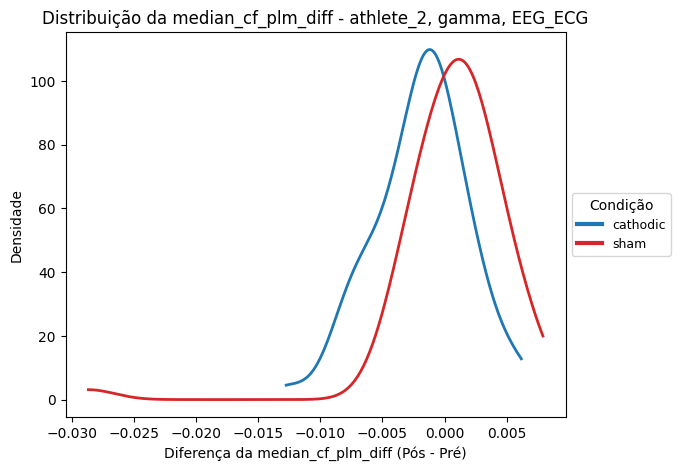

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_gamma_EEG_ECG.png


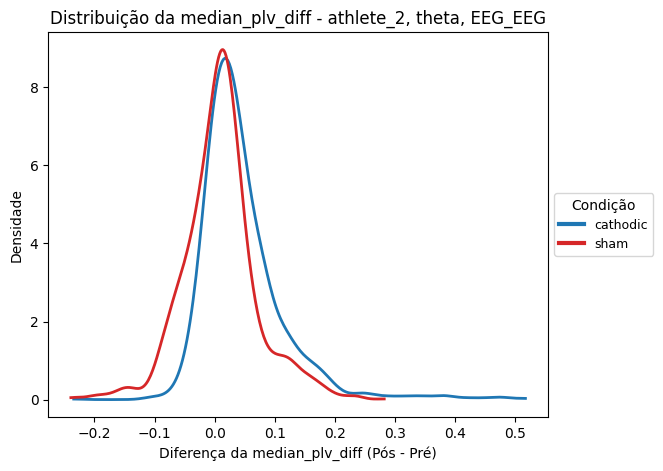

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_2_theta_EEG_EEG.png


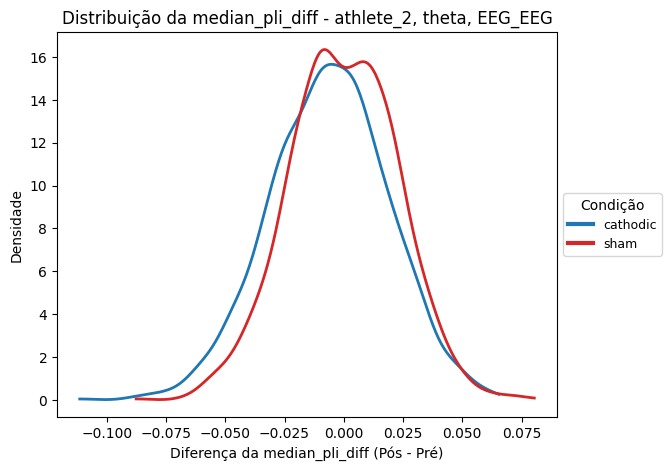

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_2_theta_EEG_EEG.png


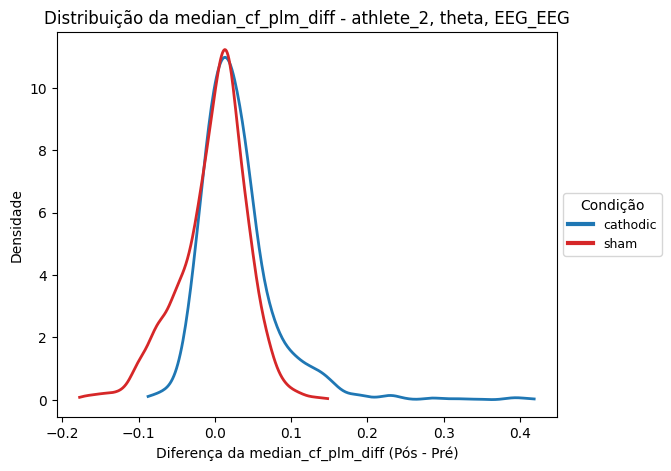

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_theta_EEG_EEG.png


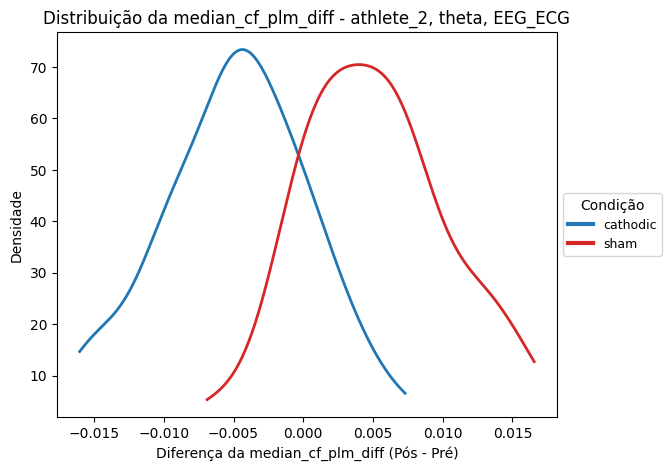

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_theta_EEG_ECG.png


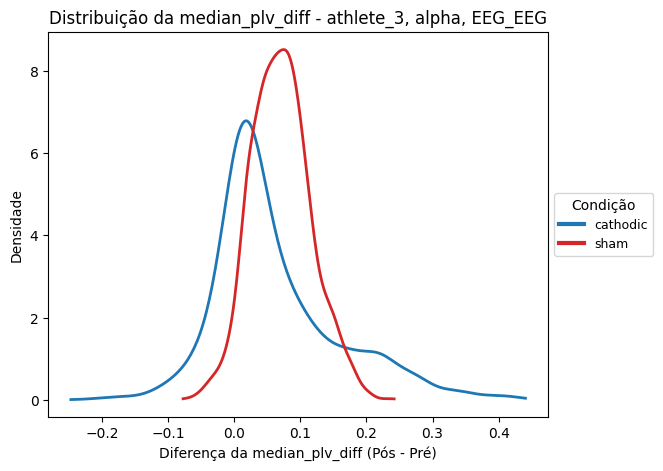

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_3_alpha_EEG_EEG.png


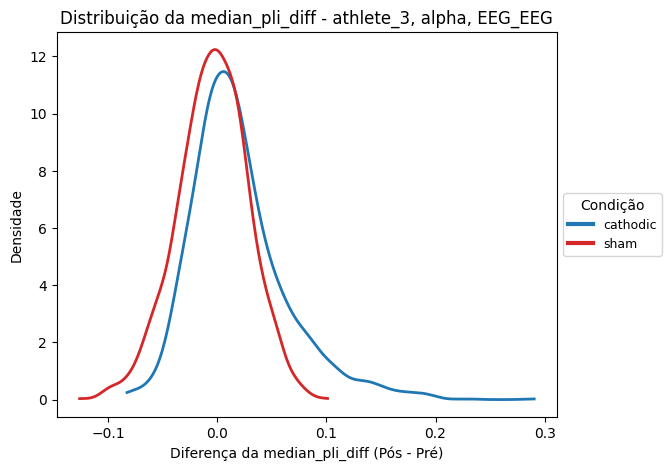

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_3_alpha_EEG_EEG.png


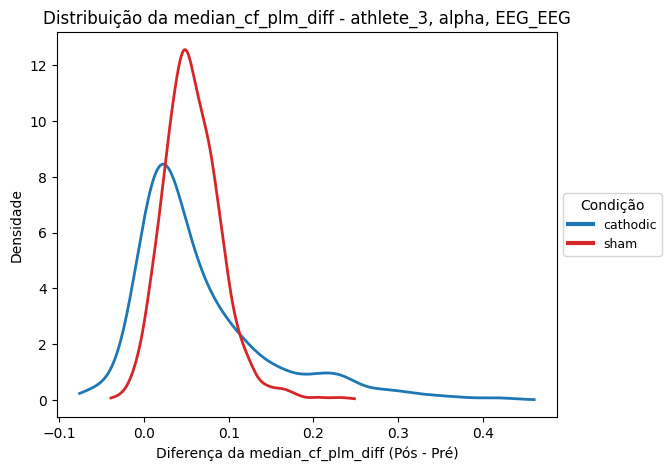

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_alpha_EEG_EEG.png


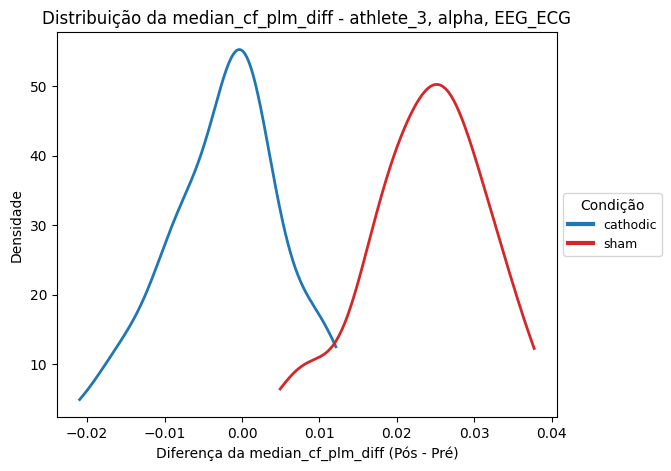

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_alpha_EEG_ECG.png


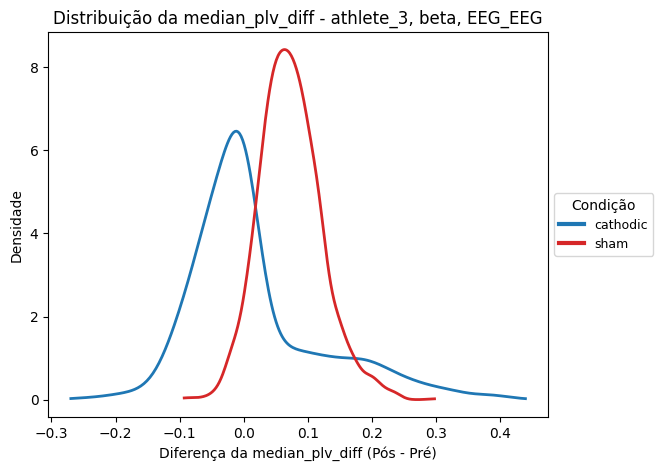

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_3_beta_EEG_EEG.png


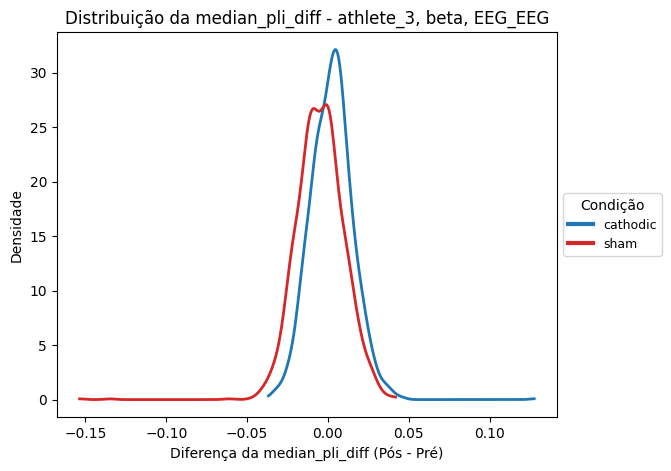

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_3_beta_EEG_EEG.png


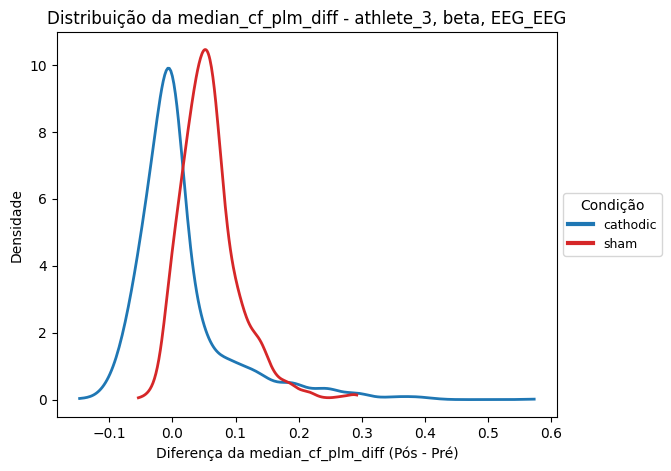

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_beta_EEG_EEG.png


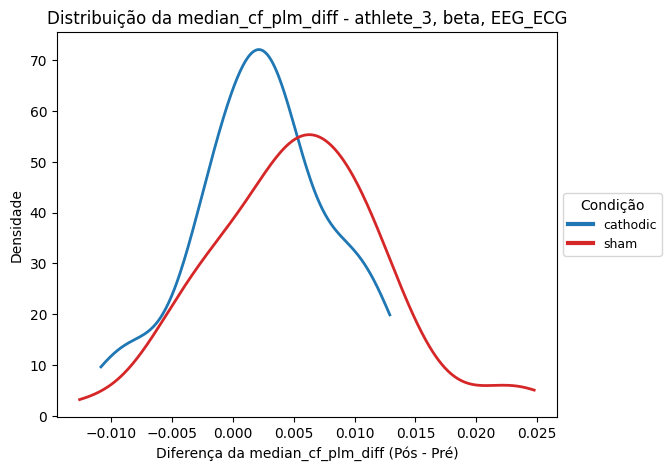

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_beta_EEG_ECG.png


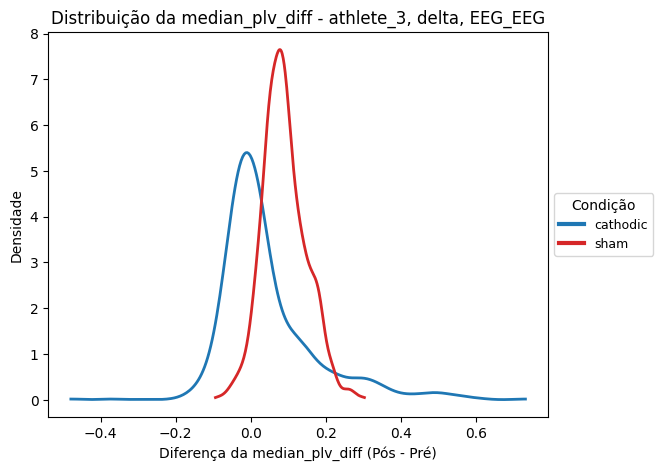

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_3_delta_EEG_EEG.png


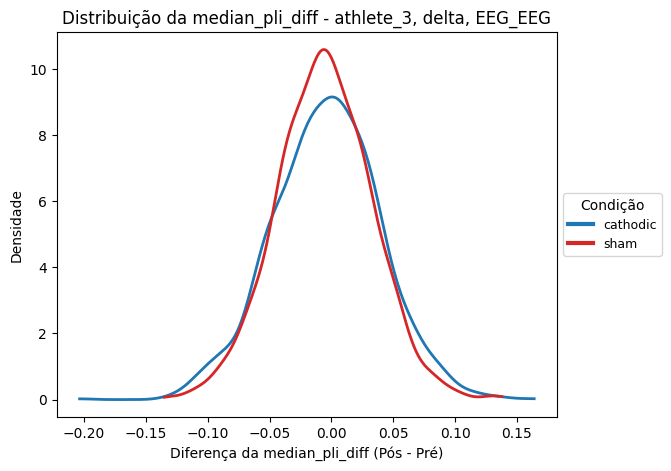

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_3_delta_EEG_EEG.png


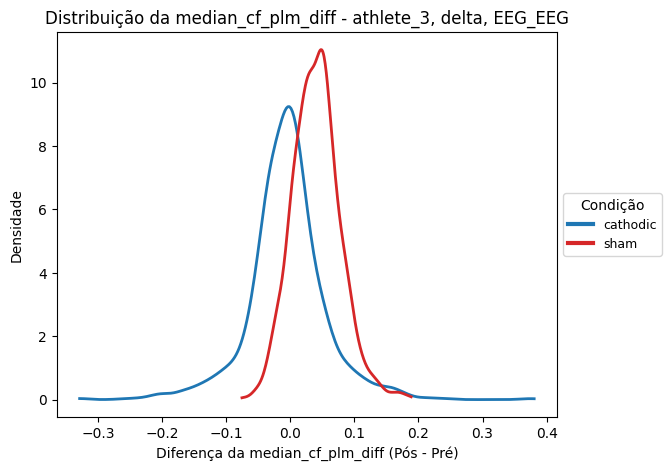

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_delta_EEG_EEG.png


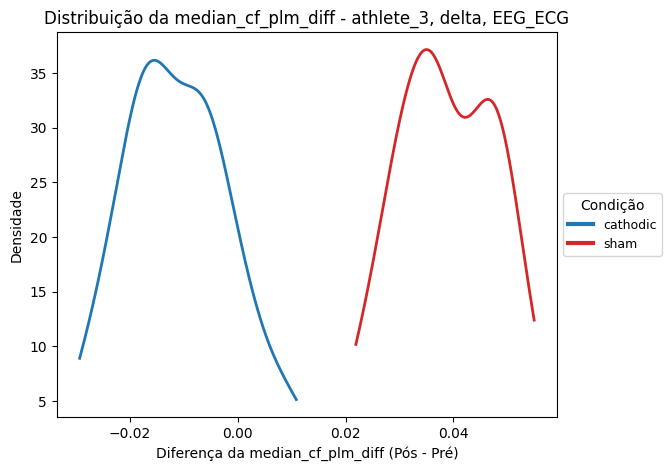

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_delta_EEG_ECG.png


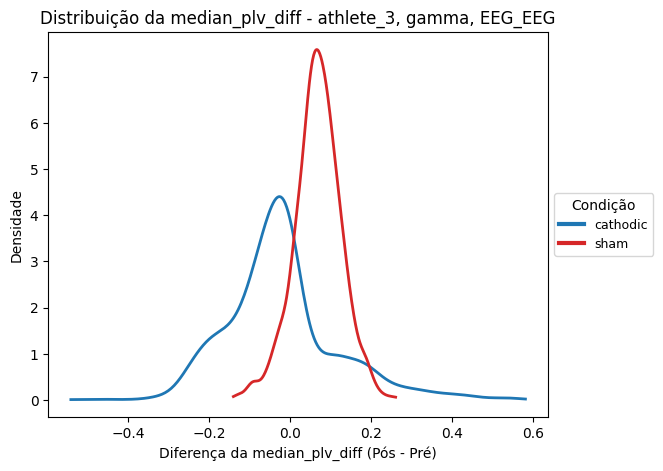

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_3_gamma_EEG_EEG.png


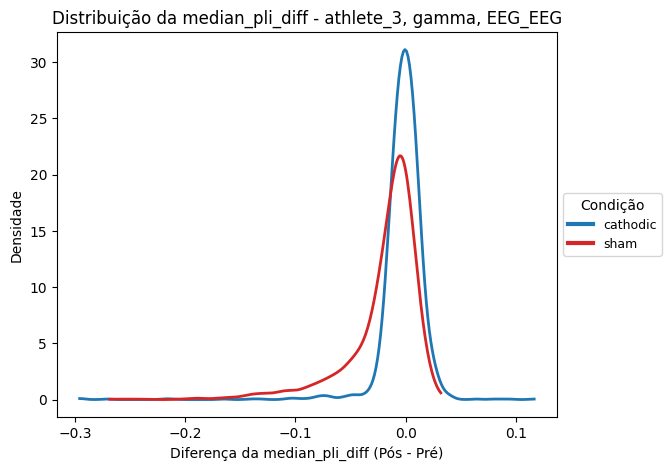

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_3_gamma_EEG_EEG.png


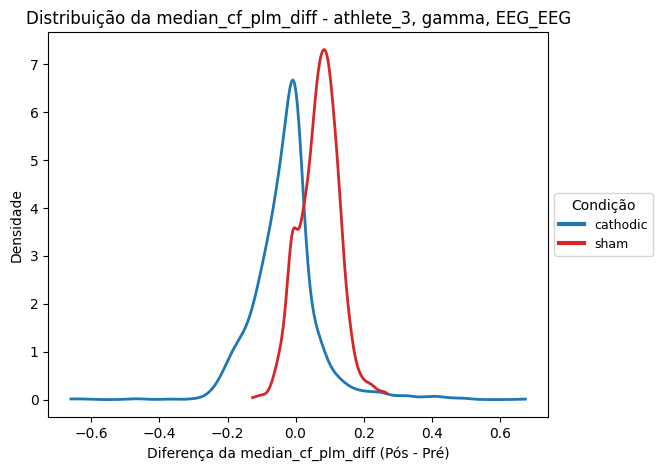

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_gamma_EEG_EEG.png


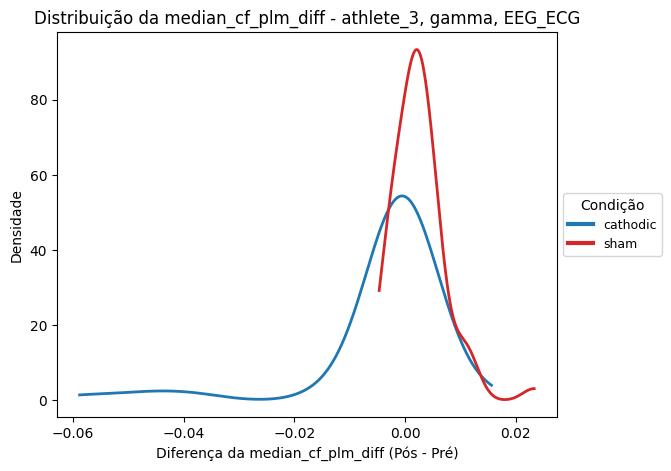

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_gamma_EEG_ECG.png


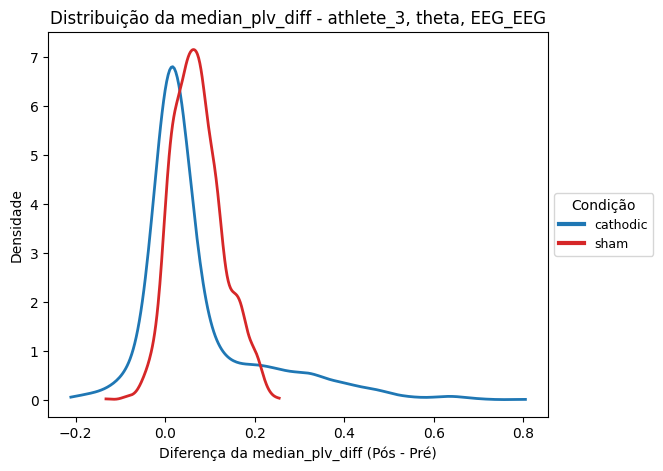

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_3_theta_EEG_EEG.png


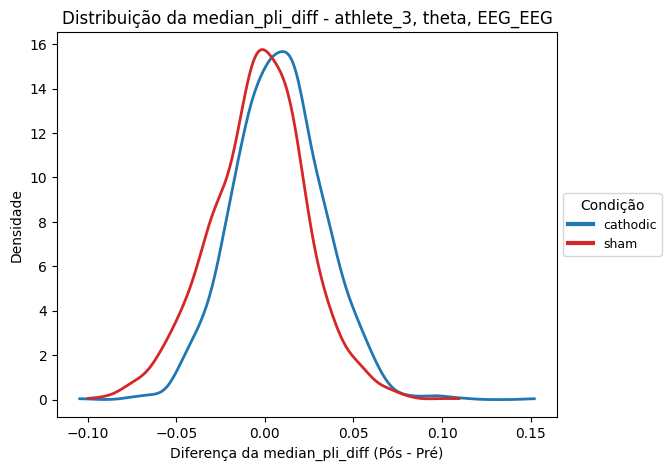

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_3_theta_EEG_EEG.png


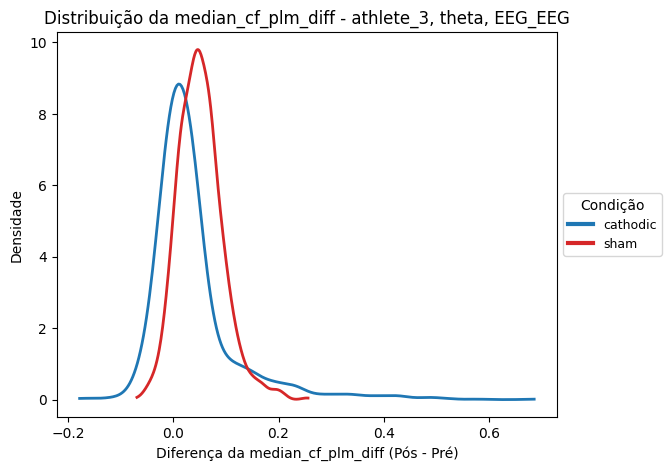

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_theta_EEG_EEG.png


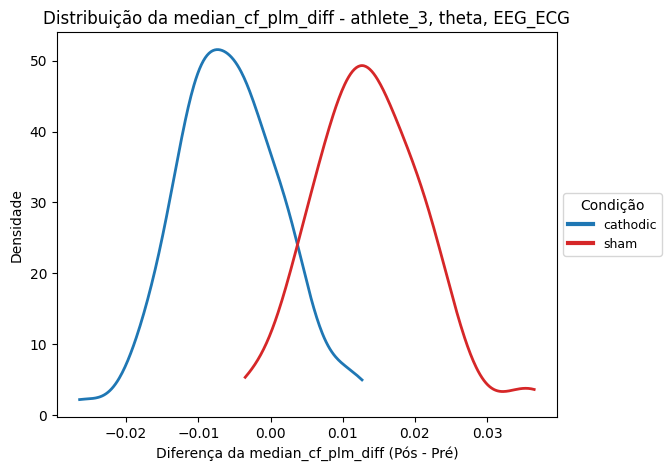

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_theta_EEG_ECG.png


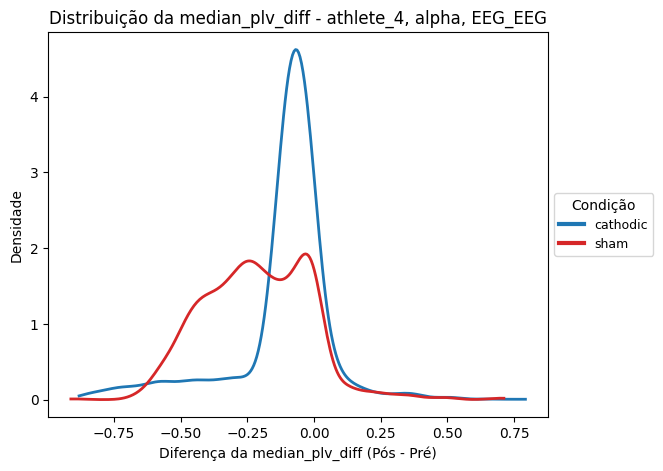

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_4_alpha_EEG_EEG.png


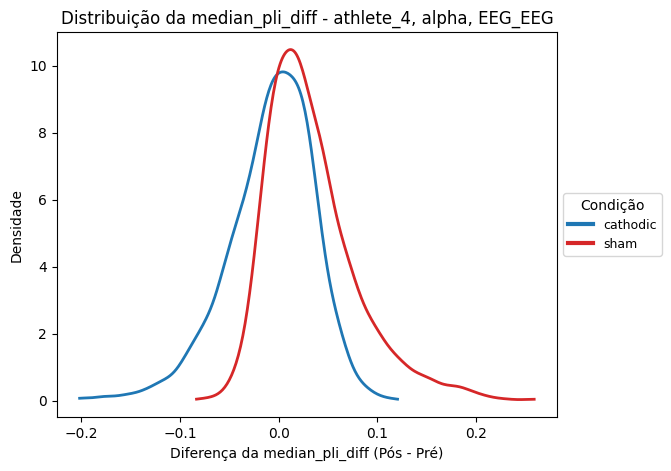

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_4_alpha_EEG_EEG.png


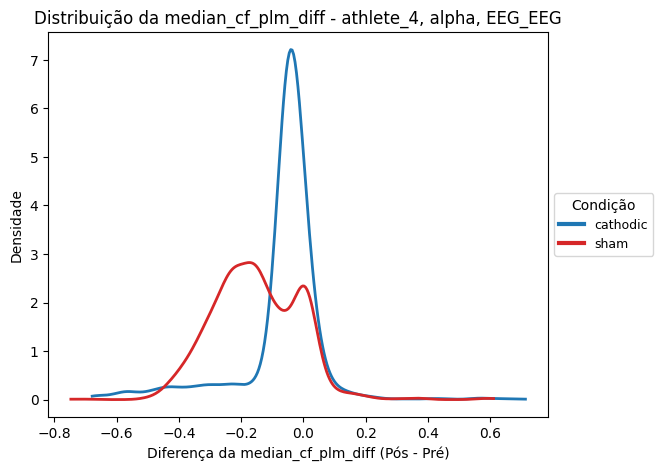

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_alpha_EEG_EEG.png


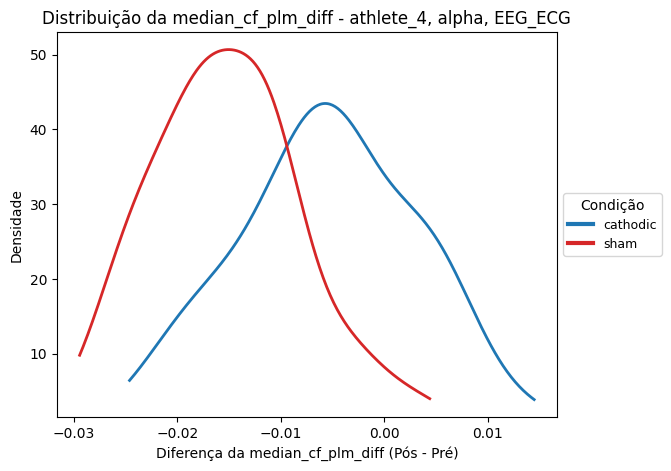

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_alpha_EEG_ECG.png


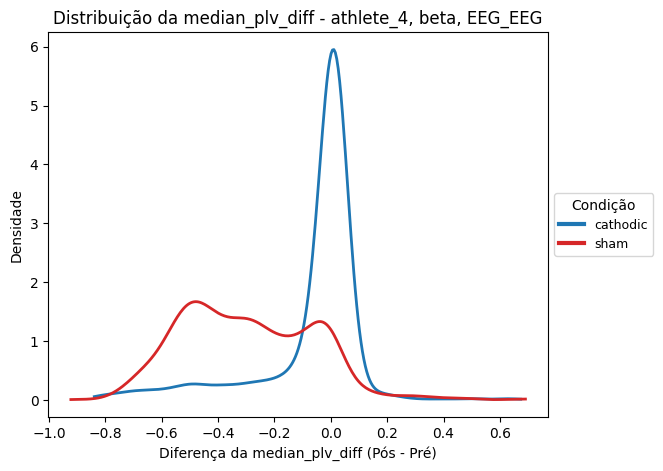

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_4_beta_EEG_EEG.png


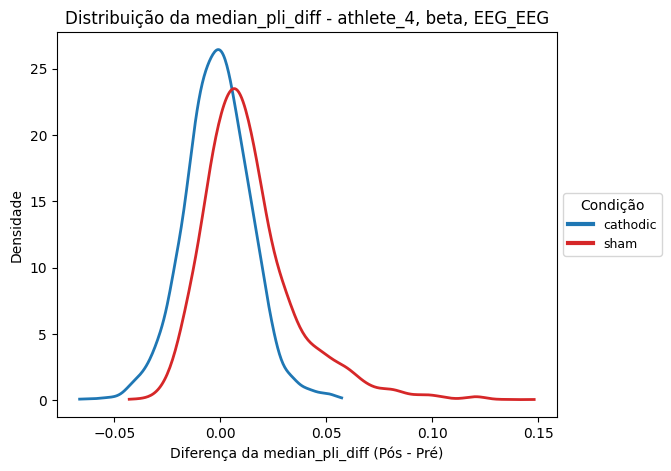

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_4_beta_EEG_EEG.png


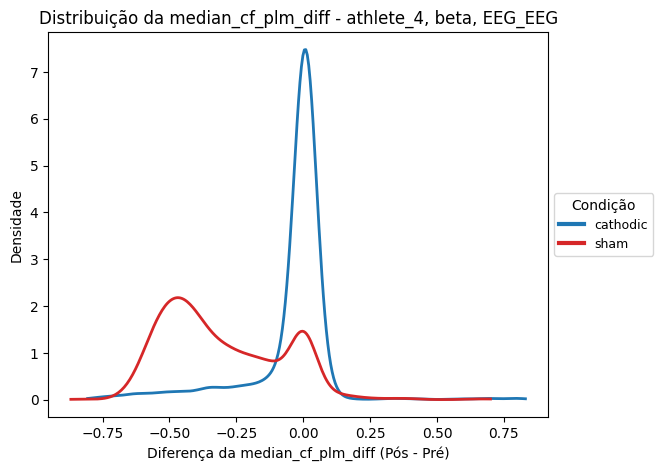

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_beta_EEG_EEG.png


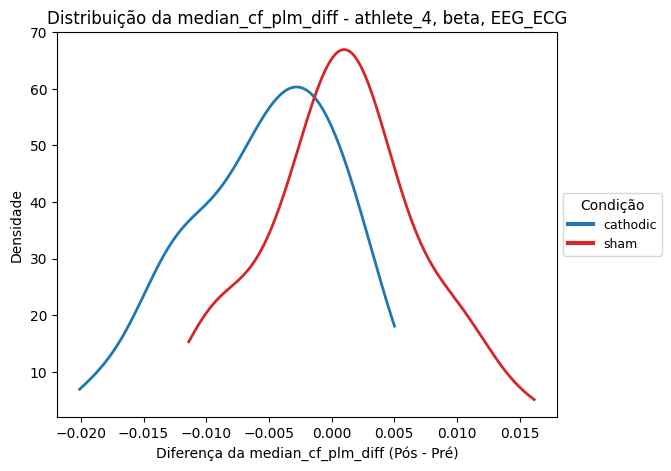

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_beta_EEG_ECG.png


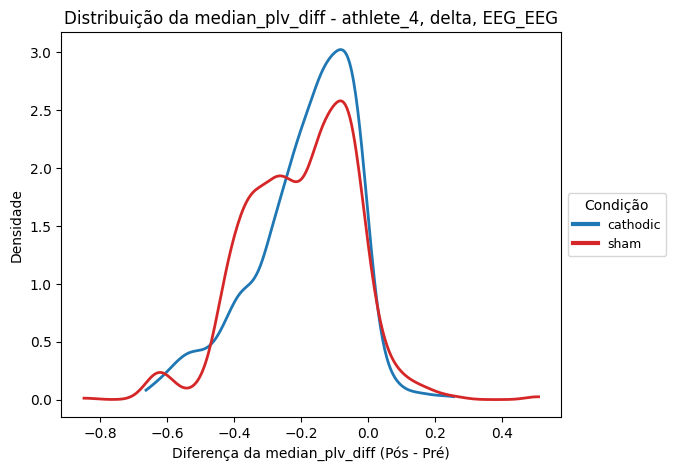

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_4_delta_EEG_EEG.png


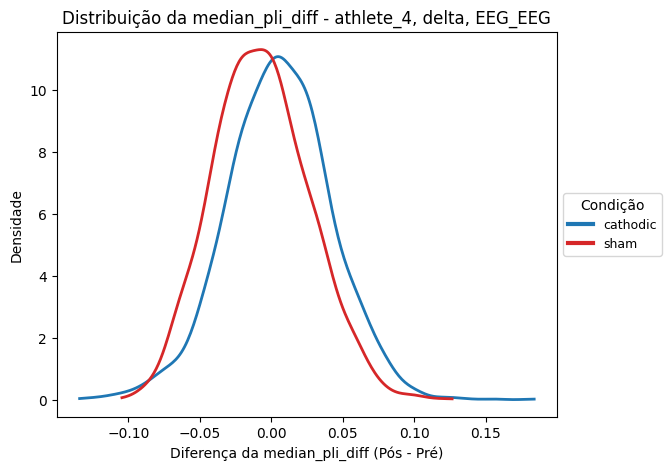

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_4_delta_EEG_EEG.png


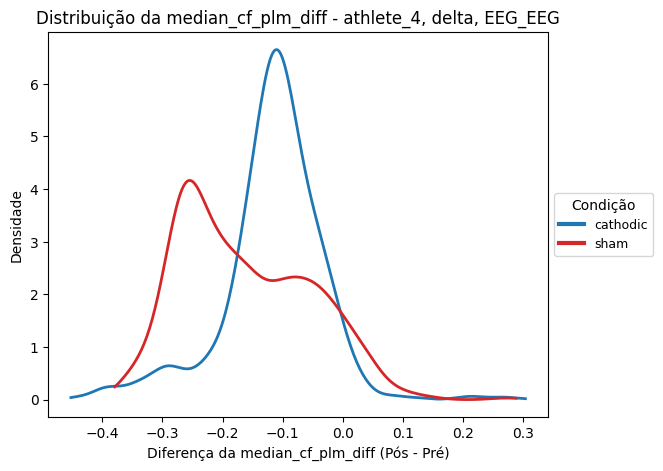

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_delta_EEG_EEG.png


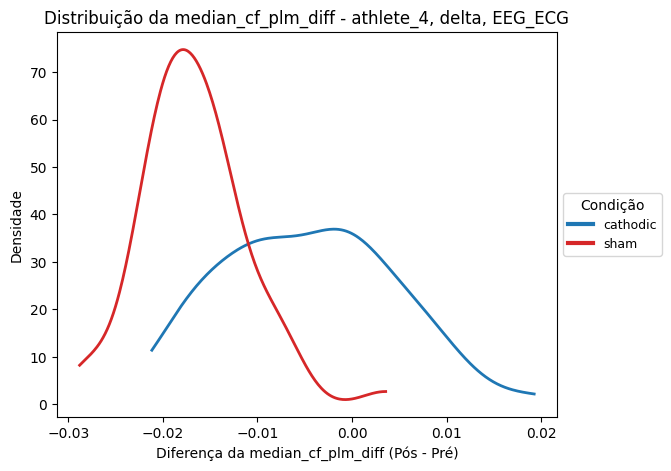

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_delta_EEG_ECG.png


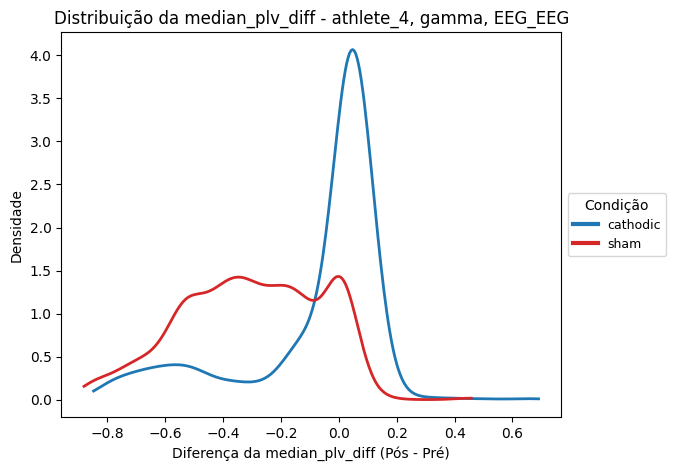

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_4_gamma_EEG_EEG.png


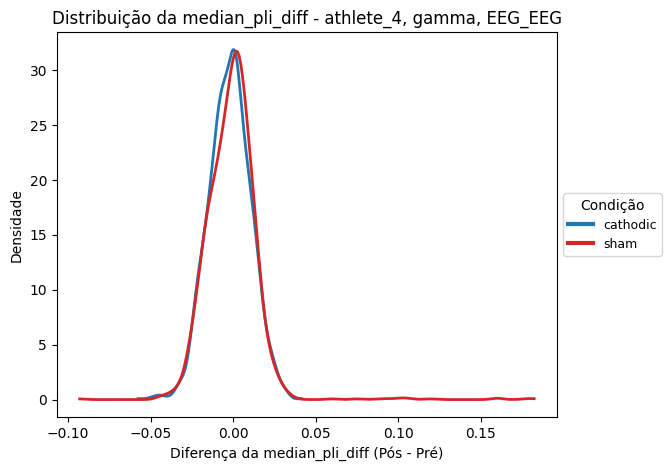

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_4_gamma_EEG_EEG.png


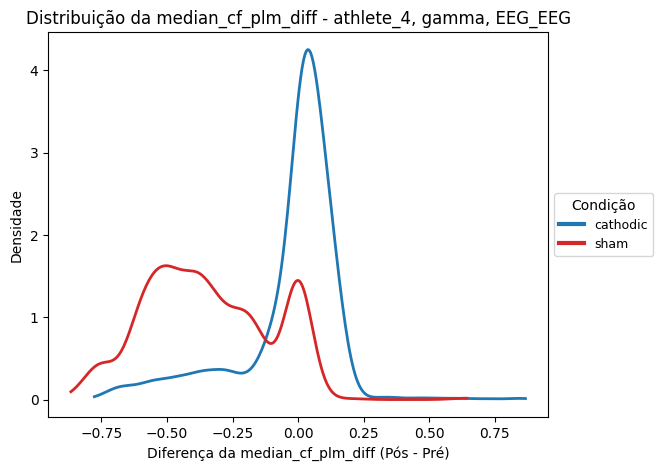

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_gamma_EEG_EEG.png


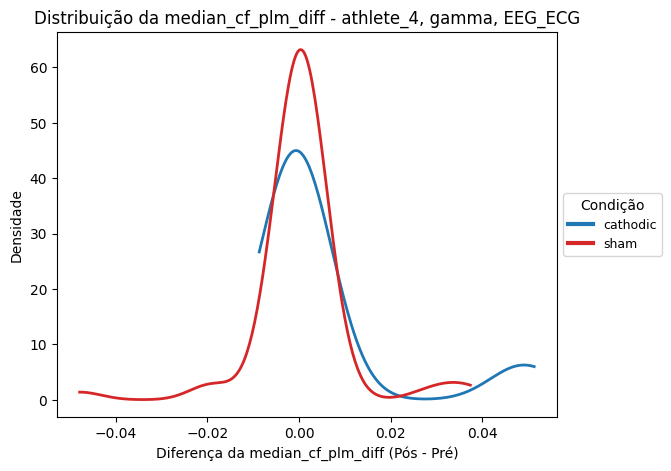

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_gamma_EEG_ECG.png


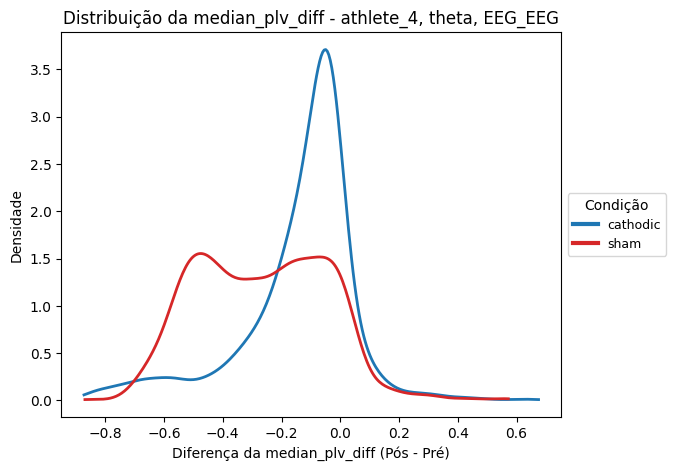

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_4_theta_EEG_EEG.png


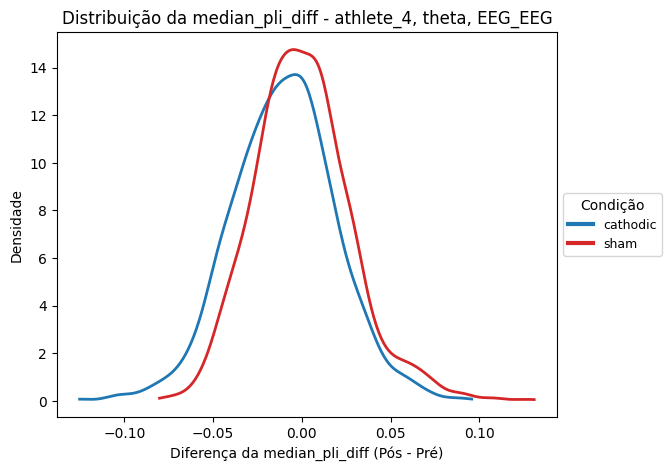

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_4_theta_EEG_EEG.png


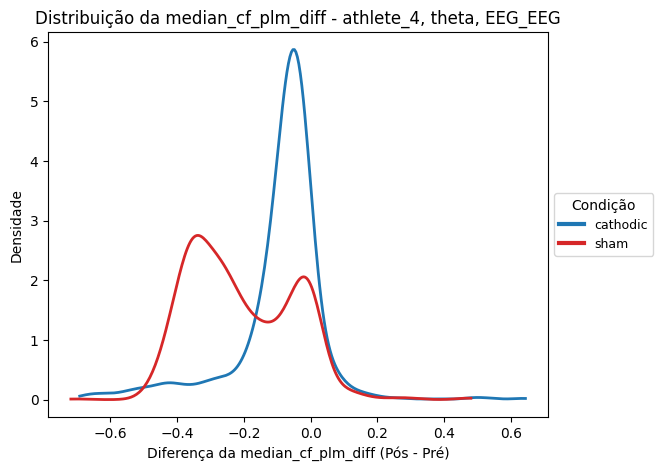

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_theta_EEG_EEG.png


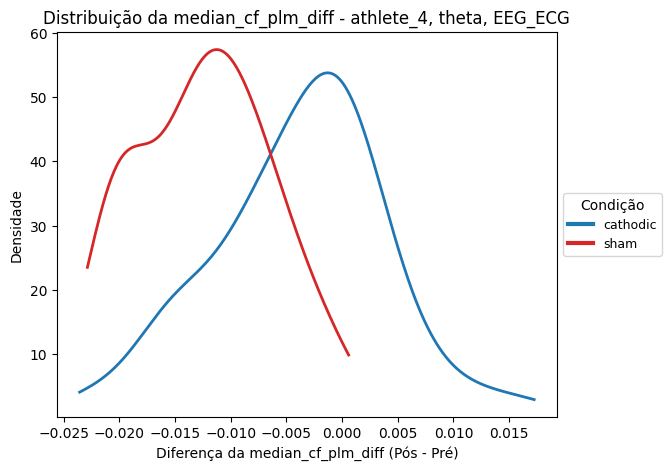

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_4_theta_EEG_ECG.png


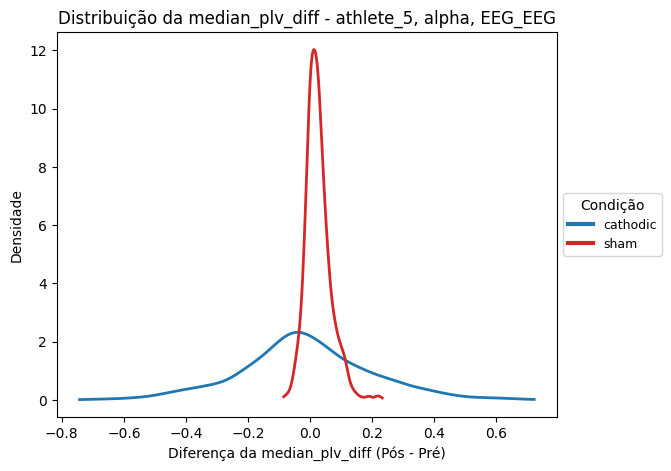

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_5_alpha_EEG_EEG.png


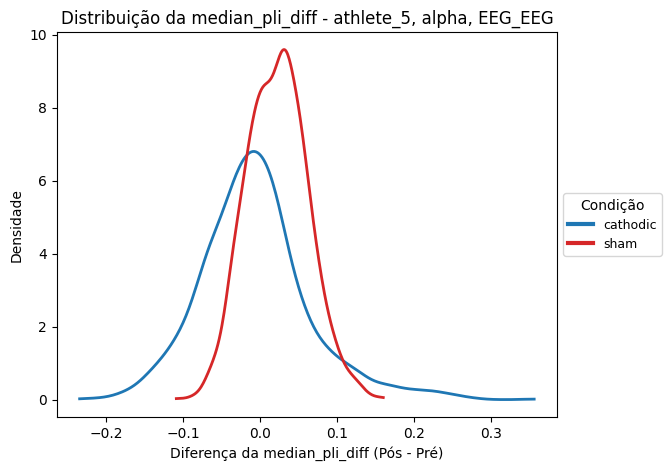

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_5_alpha_EEG_EEG.png


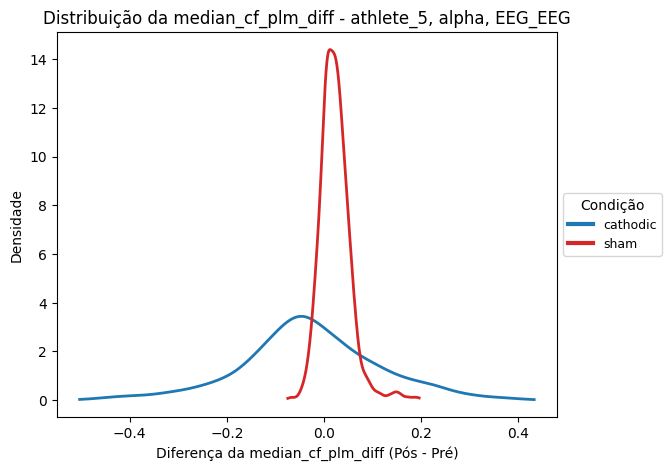

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_alpha_EEG_EEG.png


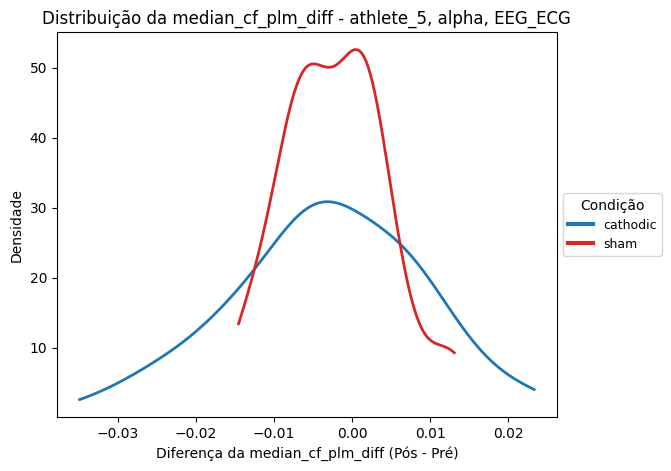

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_alpha_EEG_ECG.png


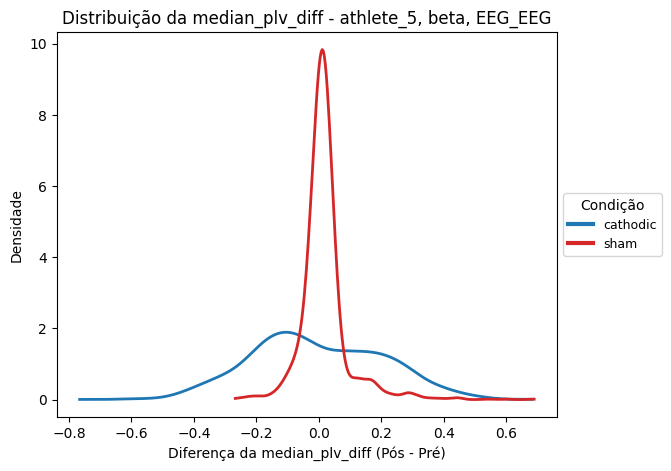

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_5_beta_EEG_EEG.png


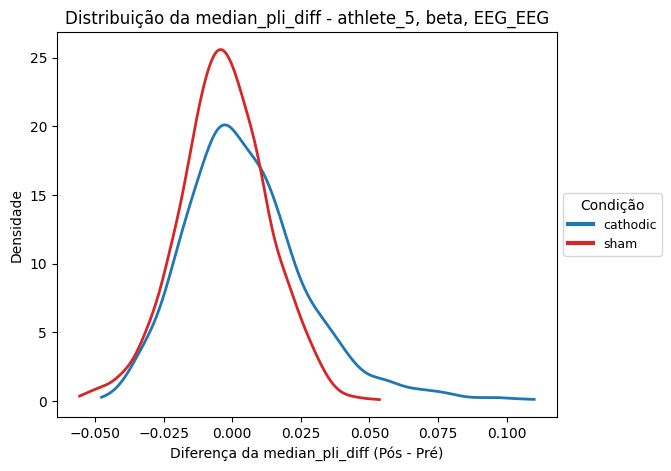

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_5_beta_EEG_EEG.png


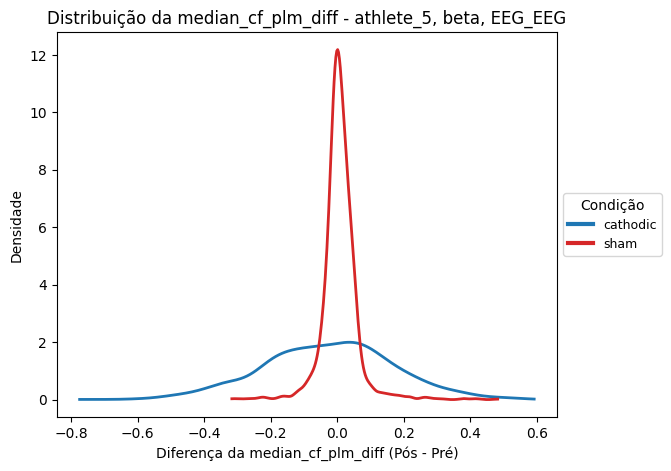

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_beta_EEG_EEG.png


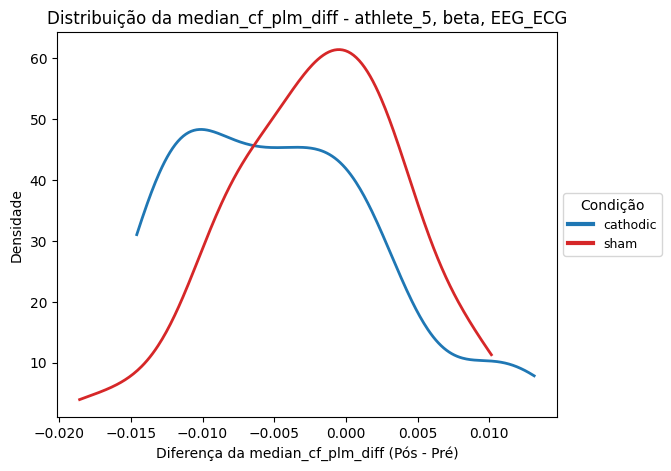

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_beta_EEG_ECG.png


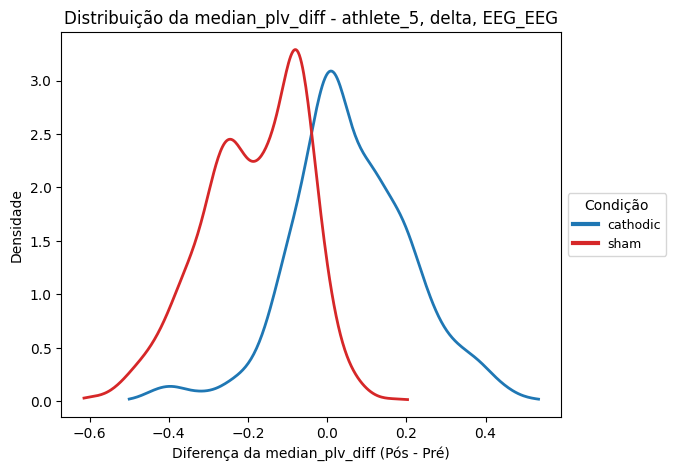

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_5_delta_EEG_EEG.png


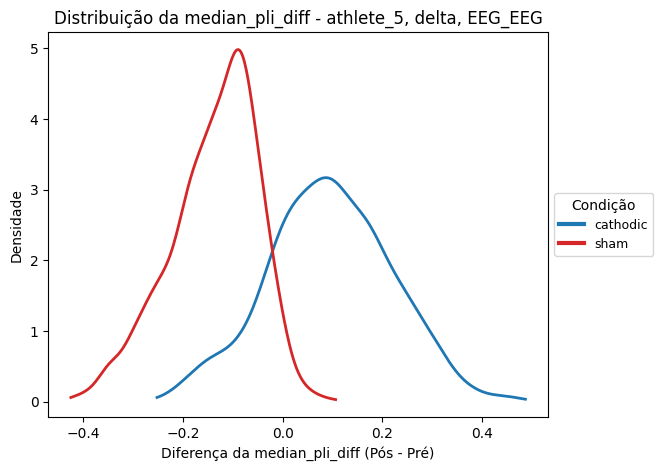

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_5_delta_EEG_EEG.png


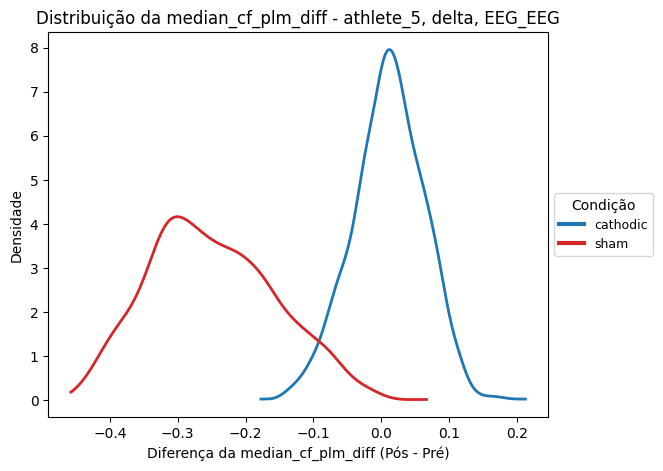

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_delta_EEG_EEG.png


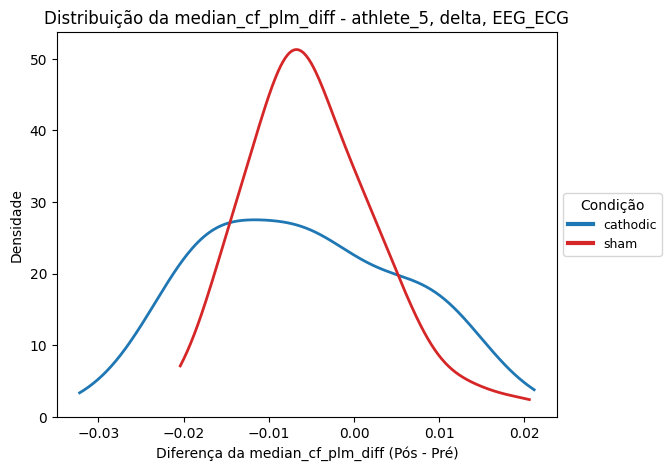

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_delta_EEG_ECG.png


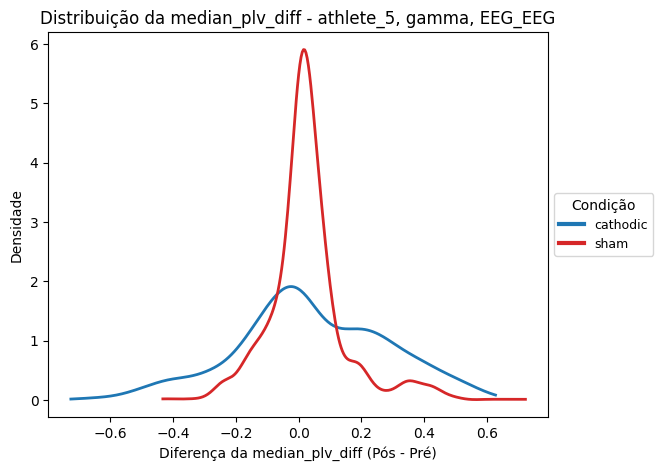

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_5_gamma_EEG_EEG.png


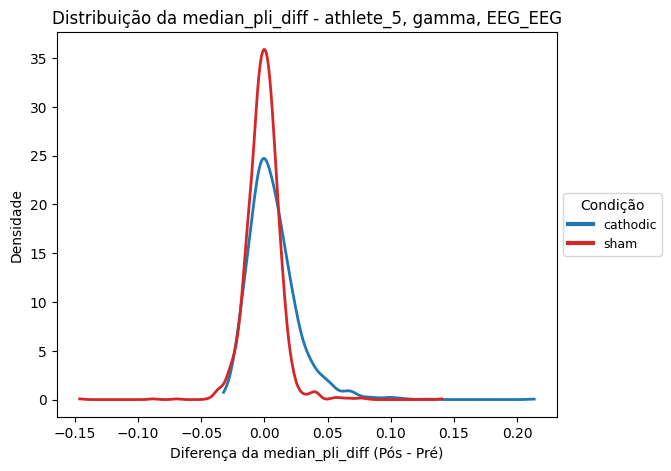

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_5_gamma_EEG_EEG.png


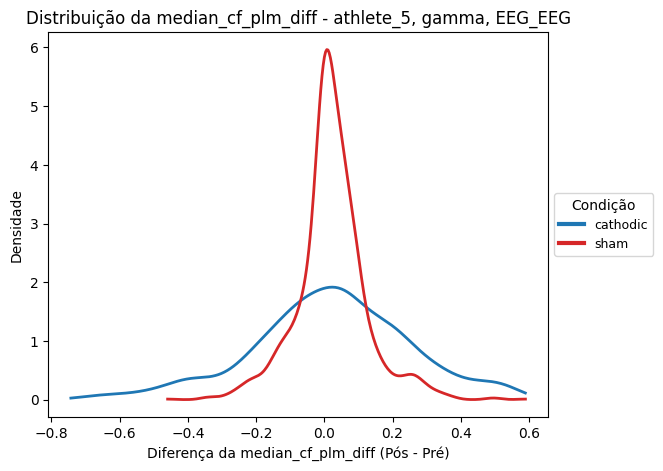

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_gamma_EEG_EEG.png


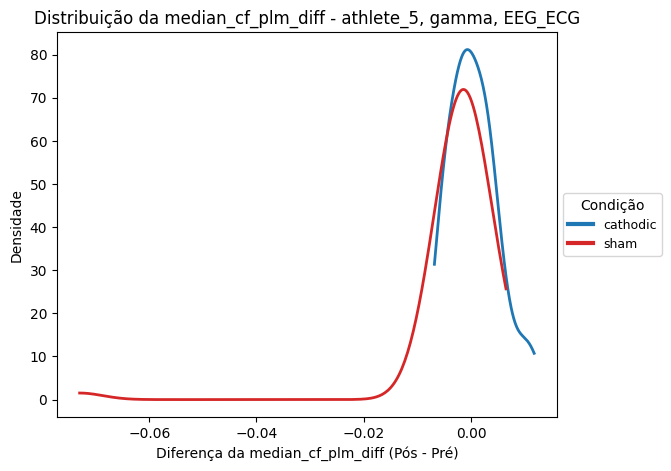

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_gamma_EEG_ECG.png


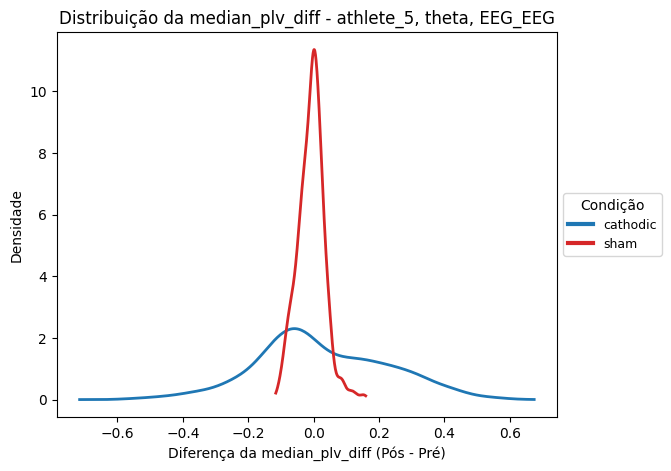

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_5_theta_EEG_EEG.png


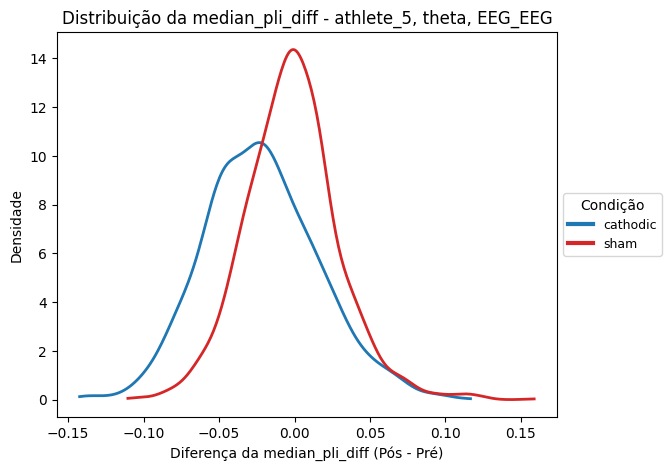

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_5_theta_EEG_EEG.png


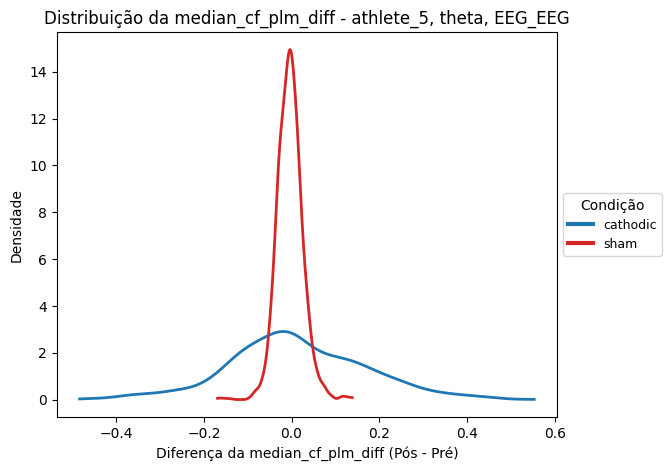

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_theta_EEG_EEG.png


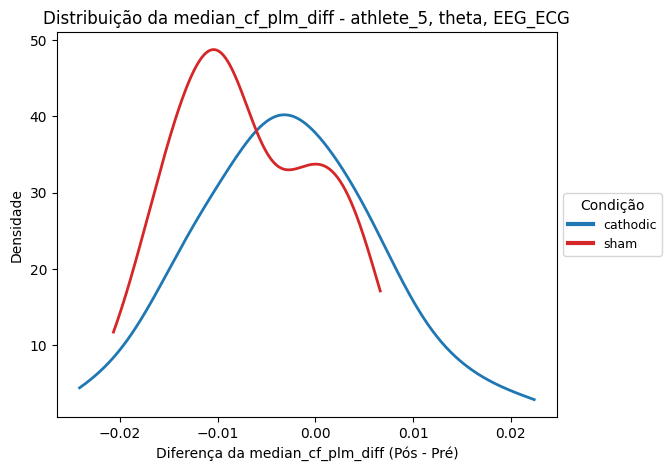

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_5_theta_EEG_ECG.png
Sem dados suficientes para median_plv_diff na condição cathodic - athlete_6, alpha, EEG_EEG


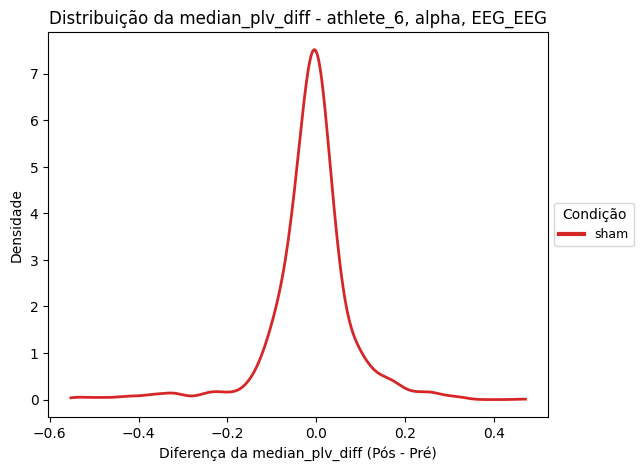

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_6_alpha_EEG_EEG.png
Sem dados suficientes para median_pli_diff na condição cathodic - athlete_6, alpha, EEG_EEG


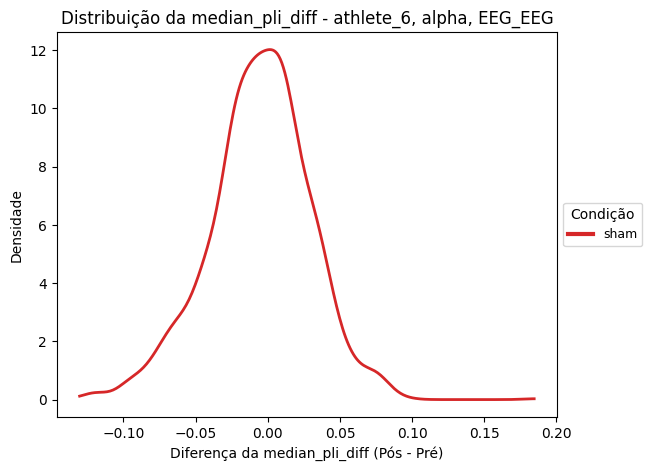

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_6_alpha_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, alpha, EEG_EEG


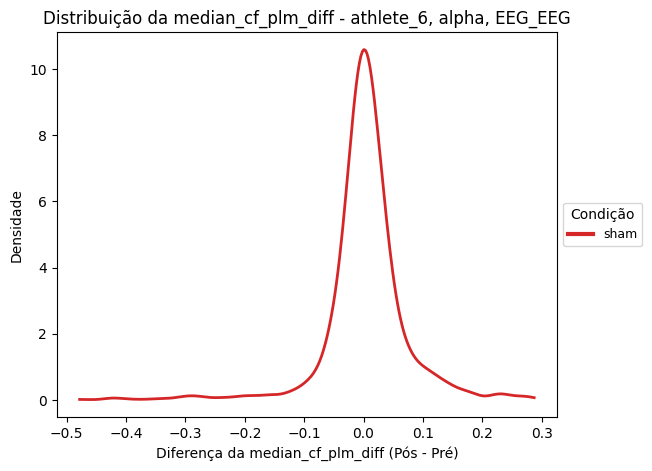

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_alpha_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, alpha, EEG_ECG


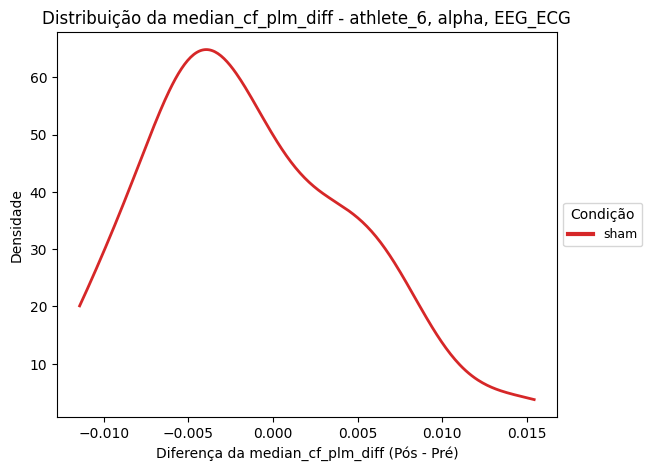

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_alpha_EEG_ECG.png
Sem dados suficientes para median_plv_diff na condição cathodic - athlete_6, beta, EEG_EEG


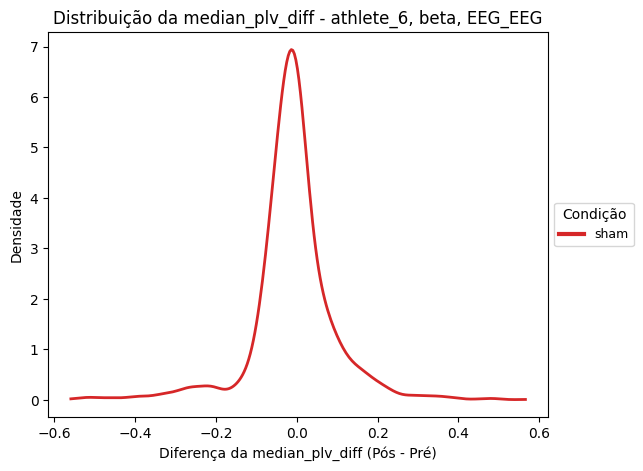

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_6_beta_EEG_EEG.png
Sem dados suficientes para median_pli_diff na condição cathodic - athlete_6, beta, EEG_EEG


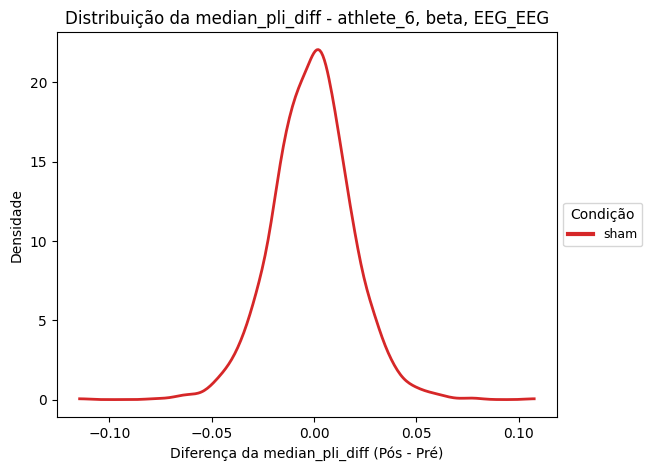

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_6_beta_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, beta, EEG_EEG


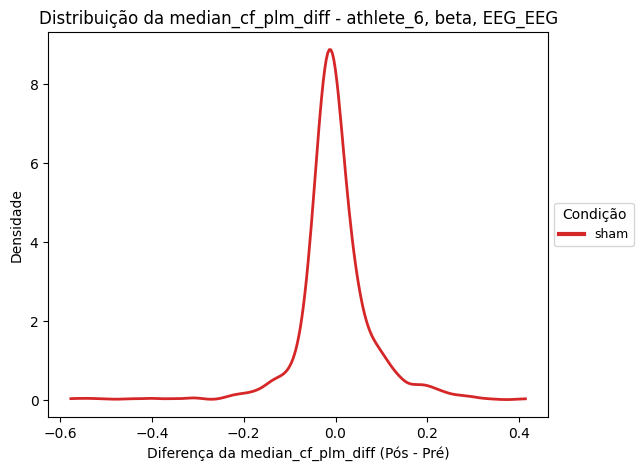

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_beta_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, beta, EEG_ECG


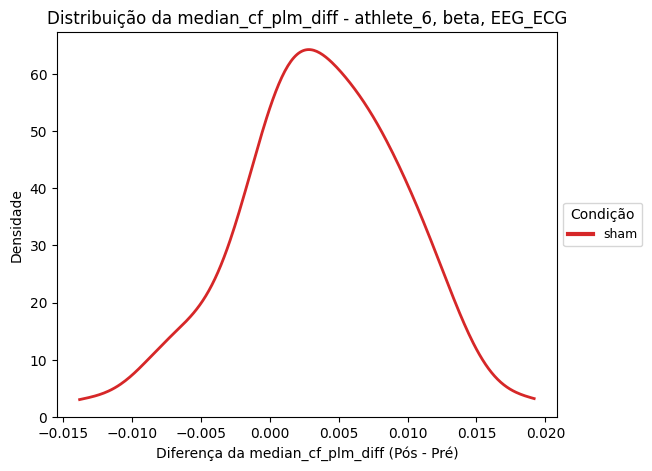

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_beta_EEG_ECG.png
Sem dados suficientes para median_plv_diff na condição cathodic - athlete_6, delta, EEG_EEG


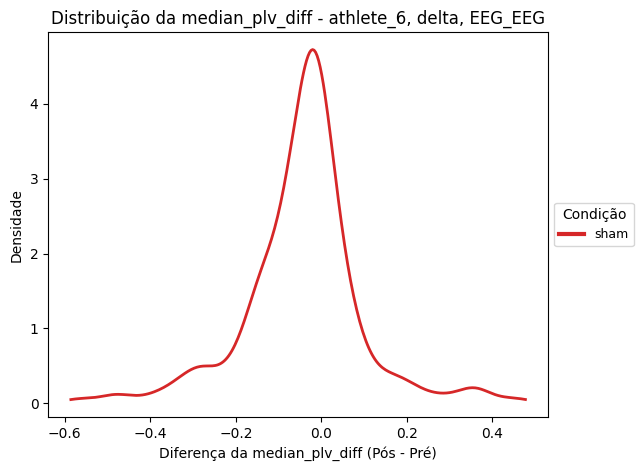

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_6_delta_EEG_EEG.png
Sem dados suficientes para median_pli_diff na condição cathodic - athlete_6, delta, EEG_EEG


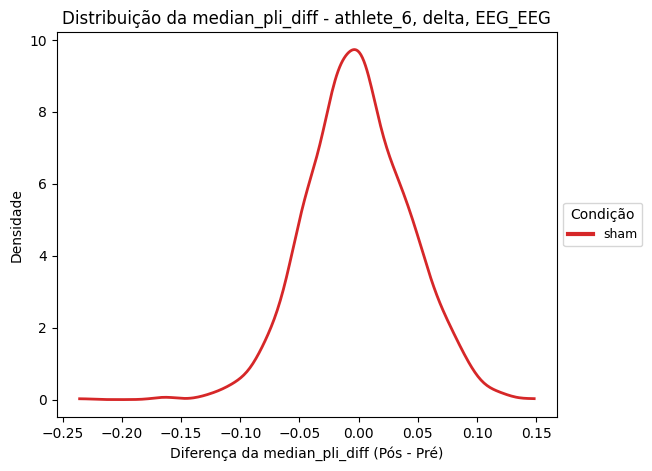

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_6_delta_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, delta, EEG_EEG


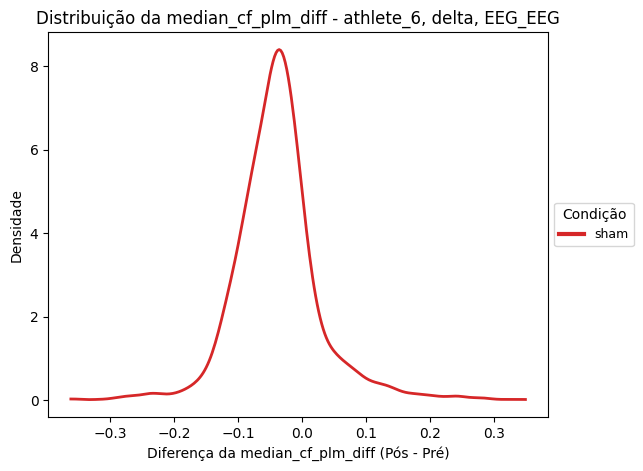

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_delta_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, delta, EEG_ECG


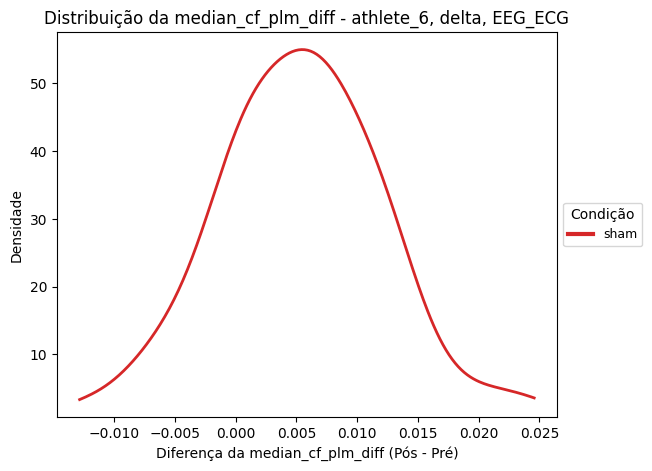

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_delta_EEG_ECG.png
Sem dados suficientes para median_plv_diff na condição cathodic - athlete_6, gamma, EEG_EEG


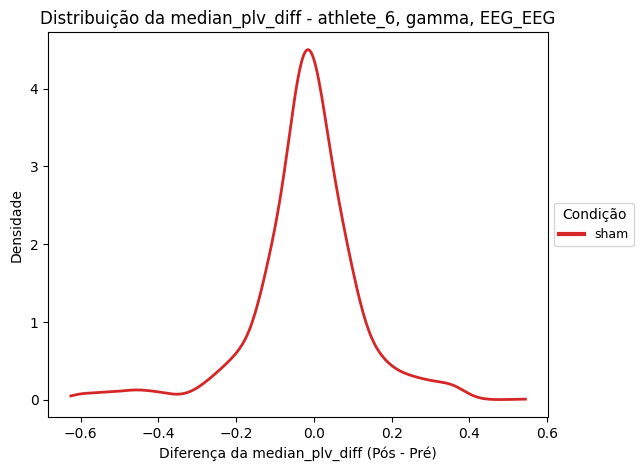

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_6_gamma_EEG_EEG.png
Sem dados suficientes para median_pli_diff na condição cathodic - athlete_6, gamma, EEG_EEG


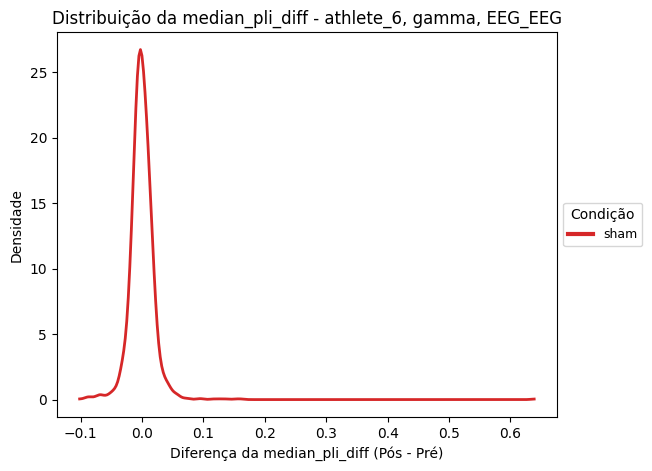

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_6_gamma_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, gamma, EEG_EEG


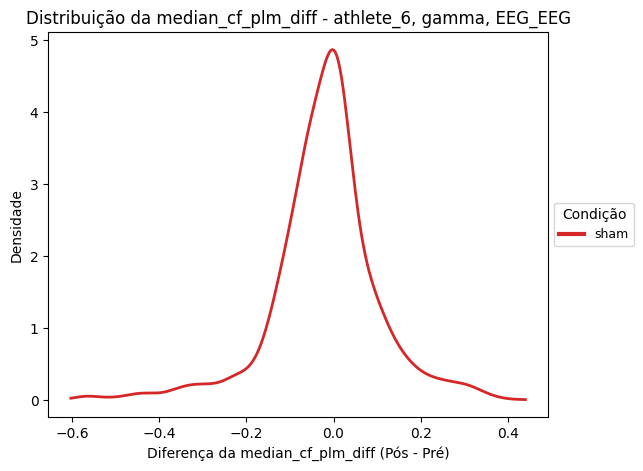

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_gamma_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, gamma, EEG_ECG


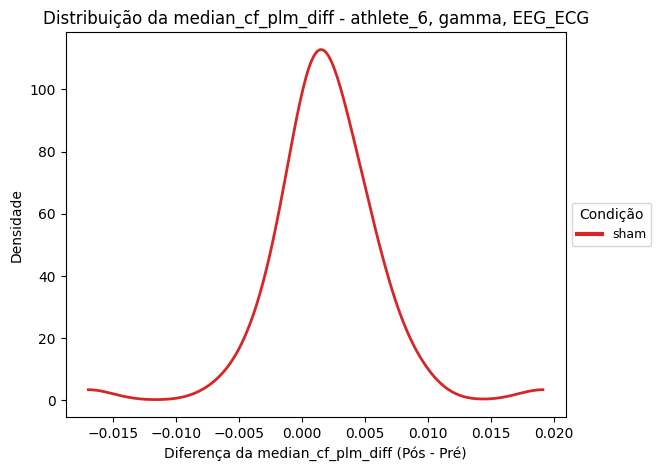

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_gamma_EEG_ECG.png
Sem dados suficientes para median_plv_diff na condição cathodic - athlete_6, theta, EEG_EEG


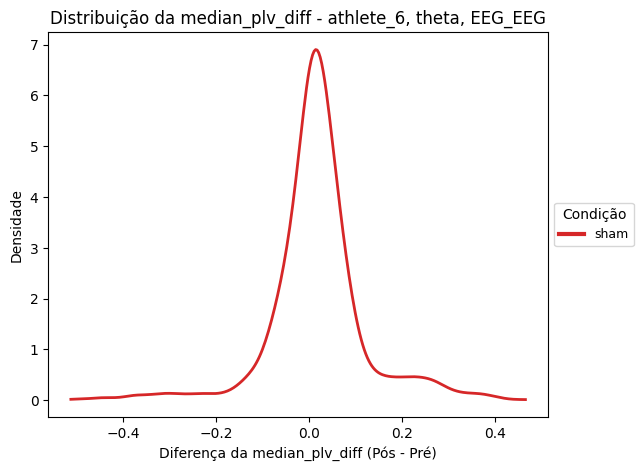

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_6_theta_EEG_EEG.png
Sem dados suficientes para median_pli_diff na condição cathodic - athlete_6, theta, EEG_EEG


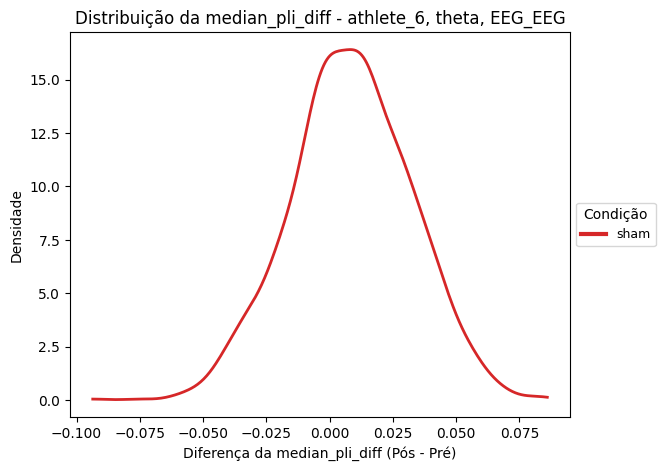

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_6_theta_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, theta, EEG_EEG


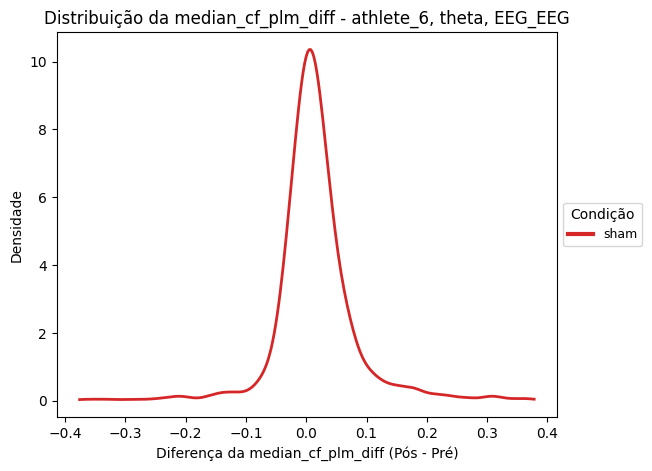

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_theta_EEG_EEG.png
Sem dados suficientes para median_cf_plm_diff na condição cathodic - athlete_6, theta, EEG_ECG


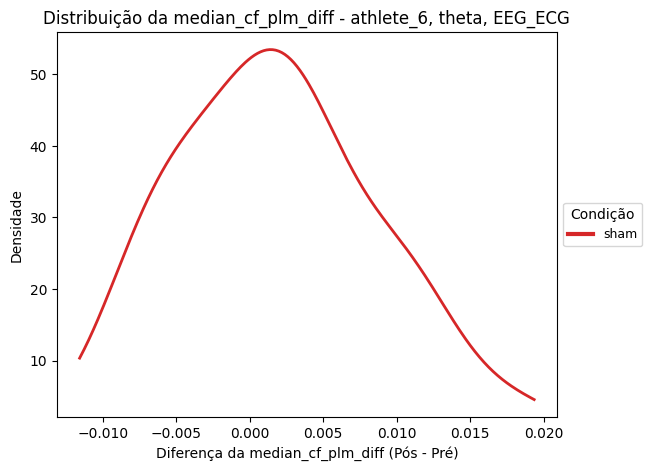

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_theta_EEG_ECG.png


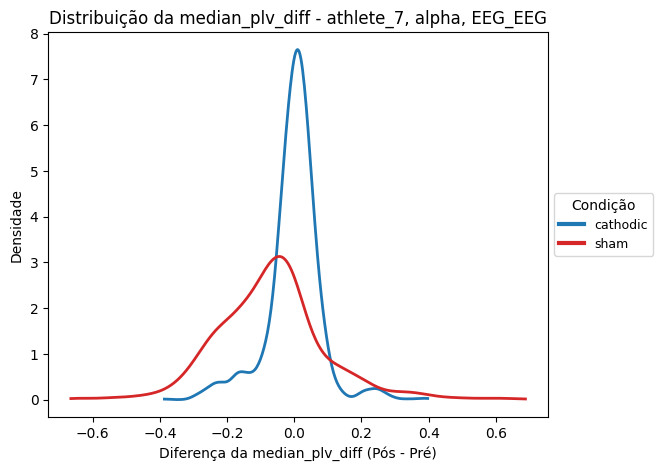

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_7_alpha_EEG_EEG.png


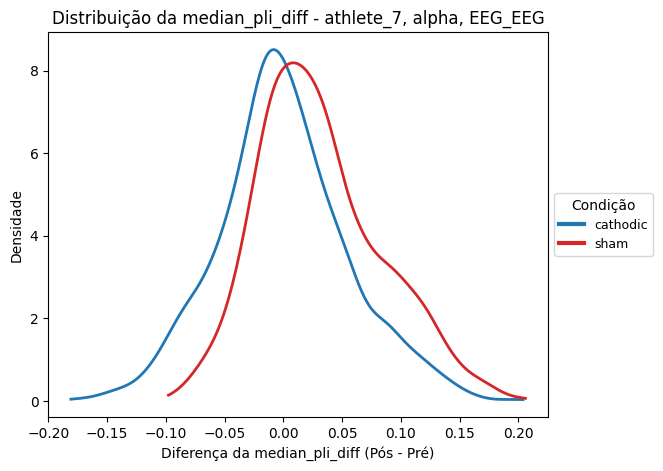

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_7_alpha_EEG_EEG.png


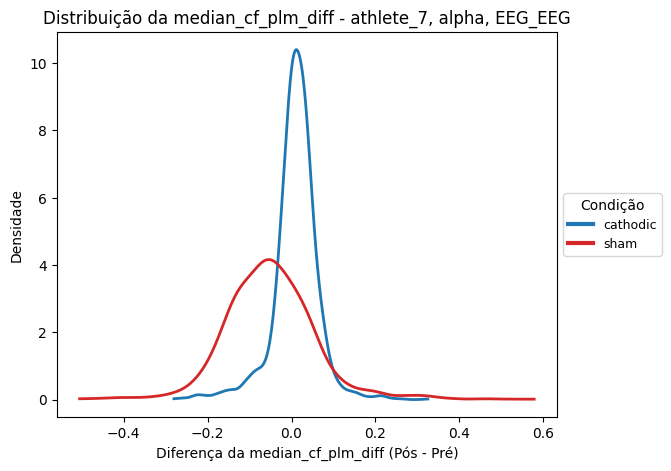

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_alpha_EEG_EEG.png


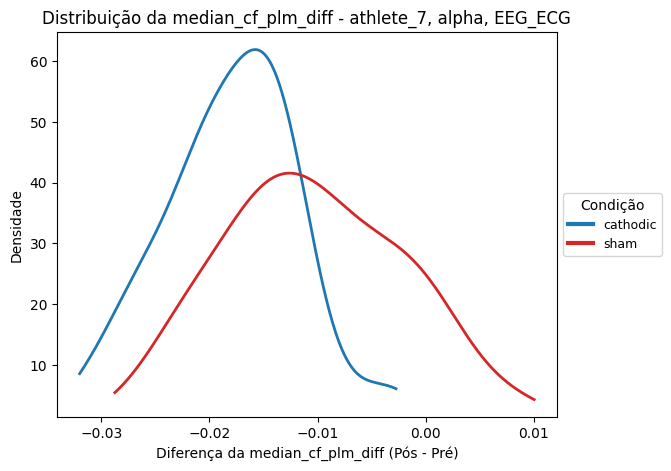

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_alpha_EEG_ECG.png


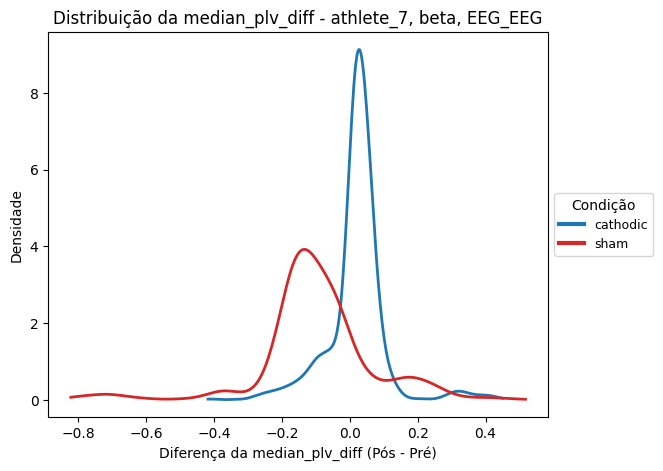

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_7_beta_EEG_EEG.png


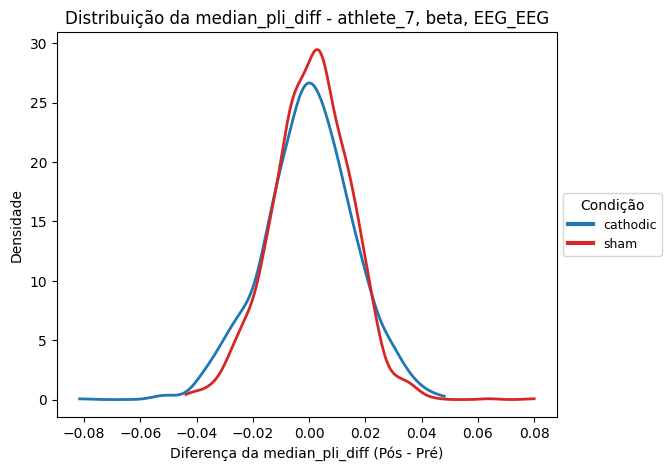

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_7_beta_EEG_EEG.png


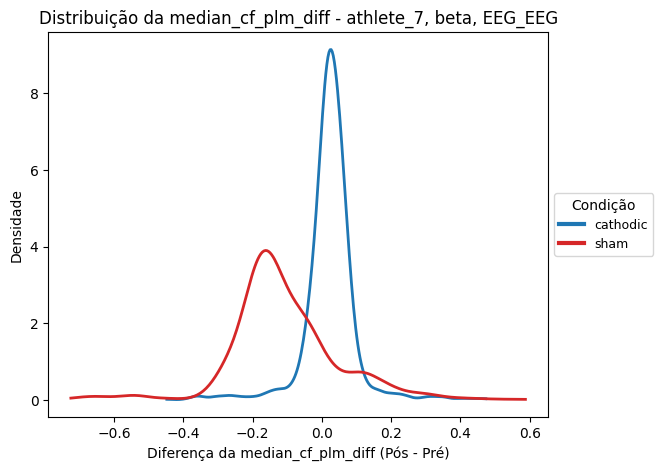

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_beta_EEG_EEG.png


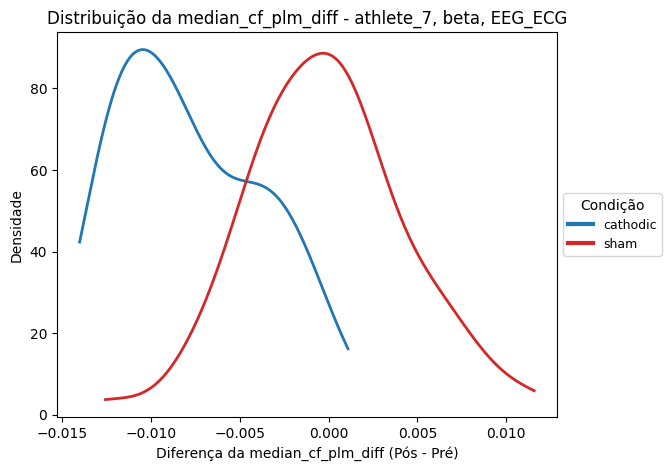

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_beta_EEG_ECG.png


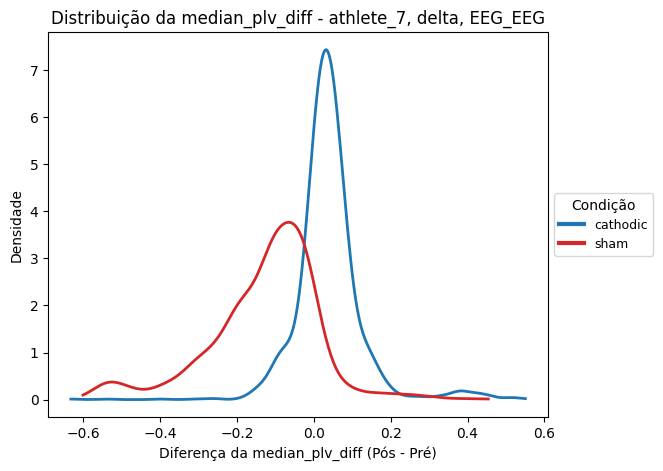

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_7_delta_EEG_EEG.png


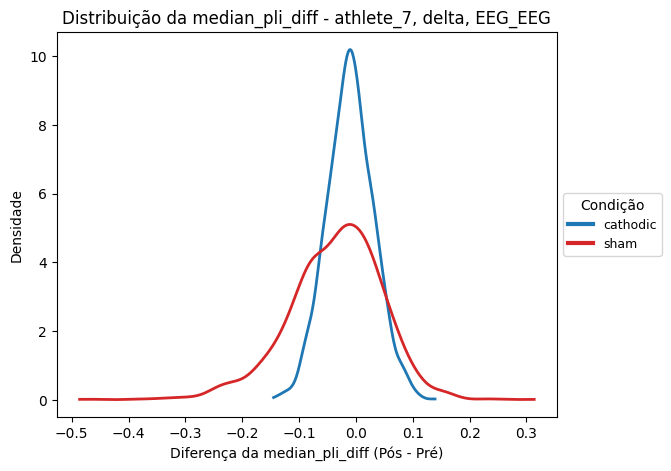

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_7_delta_EEG_EEG.png


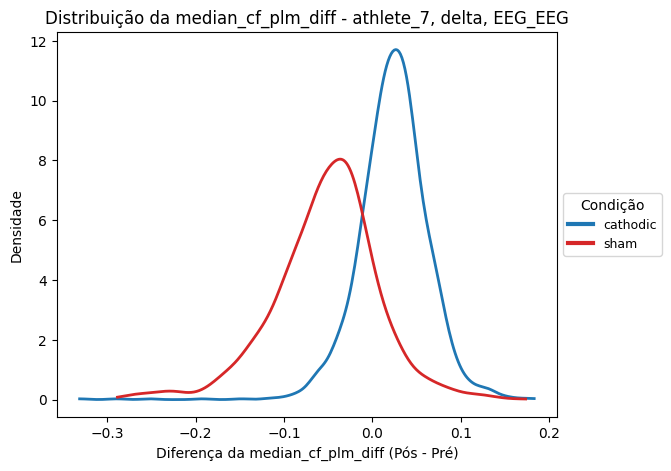

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_delta_EEG_EEG.png


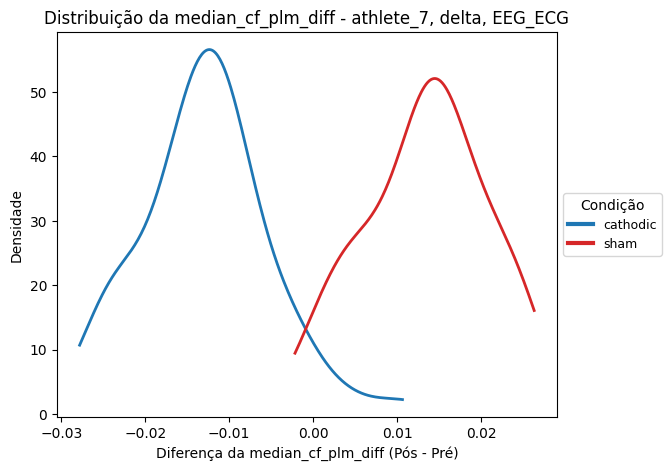

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_delta_EEG_ECG.png


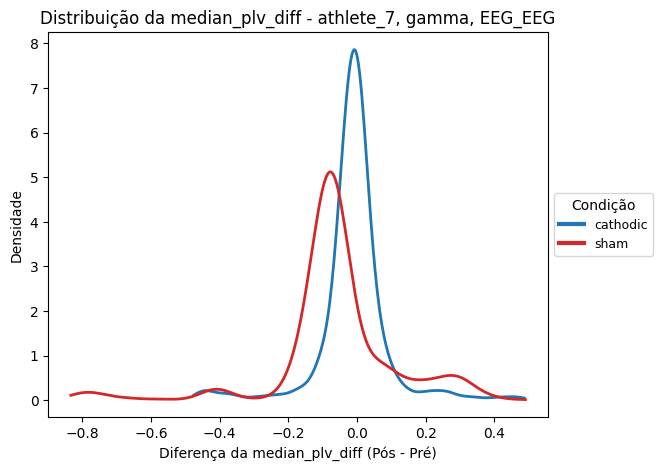

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_7_gamma_EEG_EEG.png


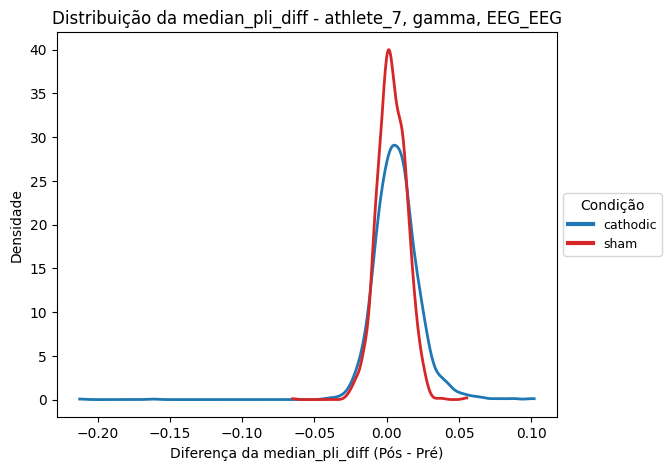

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_7_gamma_EEG_EEG.png


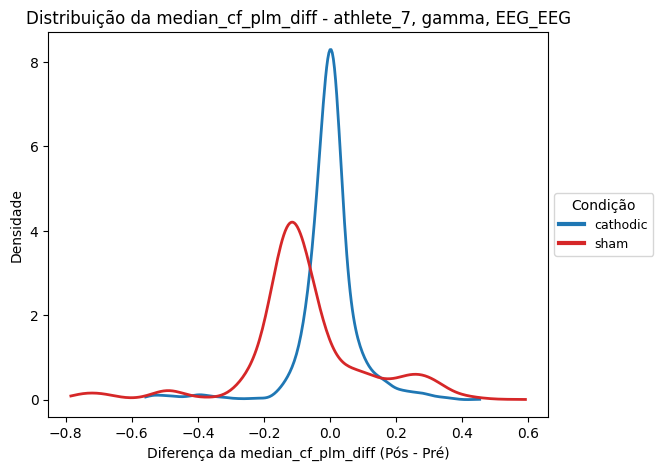

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_gamma_EEG_EEG.png


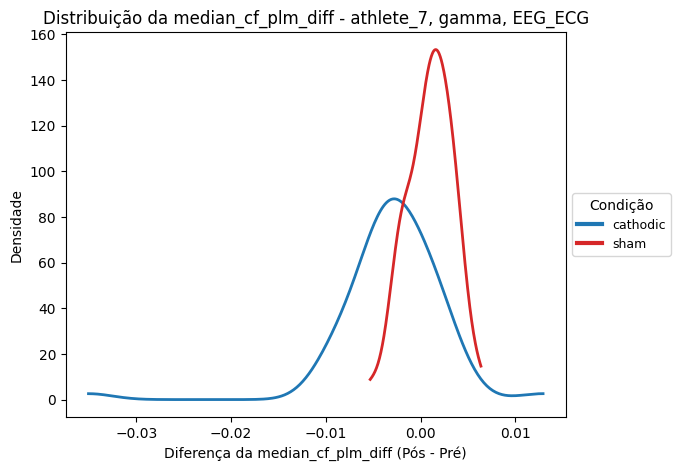

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_gamma_EEG_ECG.png


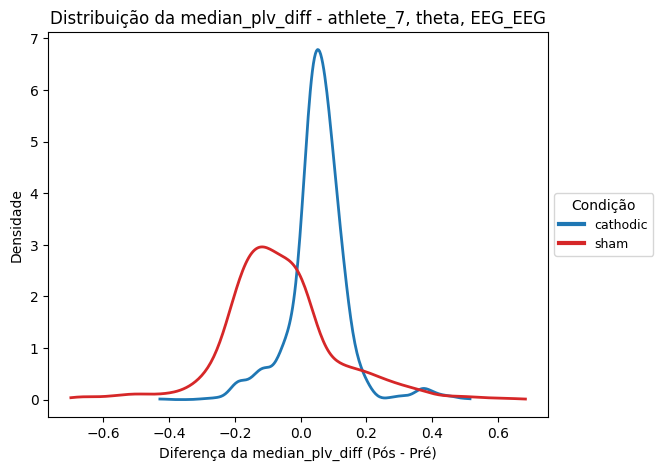

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_plv_diff_athlete_7_theta_EEG_EEG.png


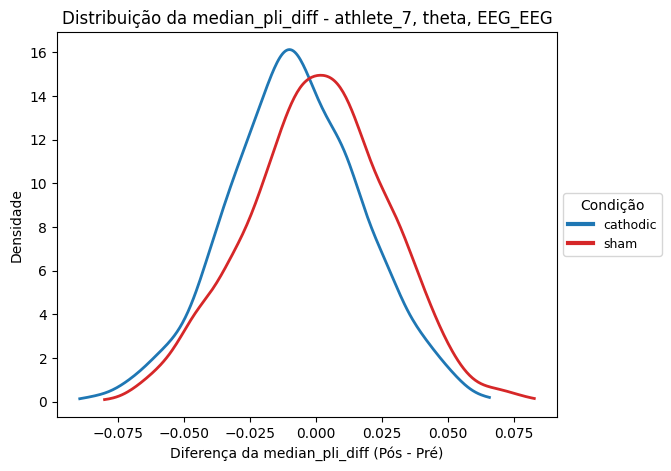

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_pli_diff_athlete_7_theta_EEG_EEG.png


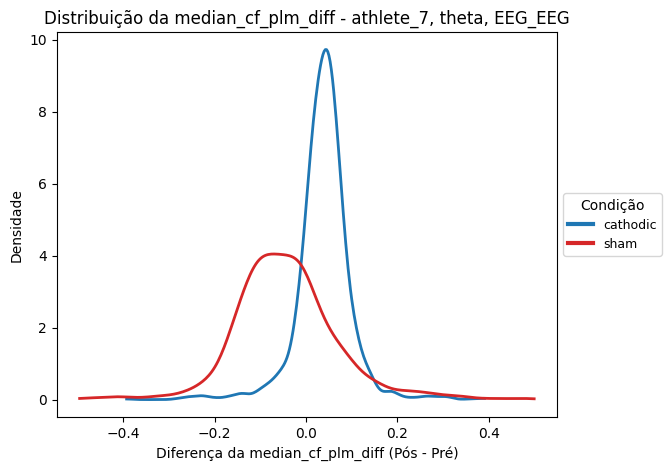

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_theta_EEG_EEG.png


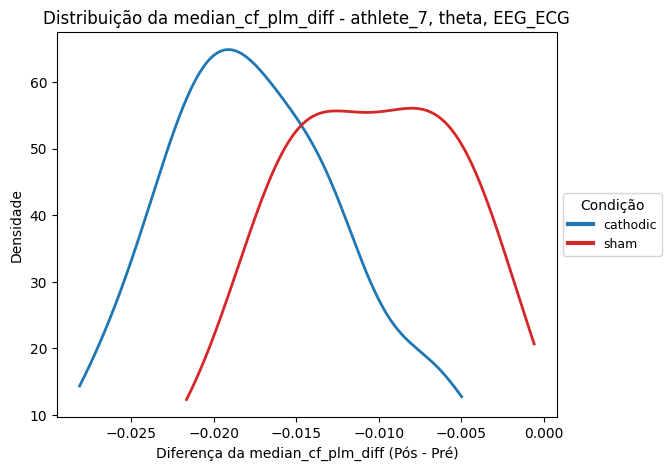

[INFO] Figura salva em: connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_7_theta_EEG_ECG.png


In [48]:
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde

# Criar pasta para salvar os gráficos
save_folder = "connectivity_metrics_individual_distribution"
os.makedirs(save_folder, exist_ok=True)

# Definir cores para cada condição
condition_colors = {
    'cathodic': '#1f77b4',  # Azul
    'sham': '#d62728'       # Vermelho
}

def plot_distribution_by_condition(df, metric, athlete, freq_band, channel_type):
    """Plota apenas a curva KDE (sem histograma) da métrica por condição e salva o gráfico."""
    metric_data = df[metric].dropna()
    if metric_data.nunique() < 2:
        print(f"Sem dados suficientes para {metric} - {athlete}, {freq_band}, {channel_type}")
        return

    fig, ax = plt.subplots(figsize=(8, 5))
    fig.subplots_adjust(right=0.75)
    legend_handles = []

    for condition, color in condition_colors.items():
        subset = df[df['condition'] == condition][metric].dropna()
        if subset.empty or subset.nunique() < 2:
            print(f"Sem dados suficientes para {metric} na condição {condition} - {athlete}, {freq_band}, {channel_type}")
            continue

        kde = gaussian_kde(subset)
        x_vals = np.linspace(subset.min(), subset.max(), 300)
        # Plota somente a curva KDE sem preencher
        ax.plot(x_vals, kde(x_vals), color=color, linewidth=2, alpha=1, label=f"KDE - {condition}")
        legend_handles.append(plt.Line2D([0], [0], color=color, linewidth=3, label=condition))

    if not legend_handles:
        print(f"Nenhuma condição válida para {metric} - {athlete}, {freq_band}, {channel_type}")
        plt.close()
        return

    ax.set_title(f'Distribuição da {metric} - {athlete}, {freq_band}, {channel_type}')
    ax.set_xlabel(f'Diferença da {metric} (Pós - Pré)')
    ax.set_ylabel('Densidade')
    ax.legend(handles=legend_handles, title='Condição', fontsize=9,
              loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)

    filename = f"{save_folder}/{metric}_{athlete}_{freq_band}_{channel_type}.png".replace(" ", "_")
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    print(f"[INFO] Figura salva em: {filename}")

# === Iterar por atleta, frequency_band, channel_pair_type e métrica ===
for athlete in df_final['athlete'].unique():
    for freq_band in df_final['frequency_band'].unique():
        for channel_type in df_final['channel_pair_type'].unique():
            subset = df_final[
                (df_final['athlete'] == athlete) &
                (df_final['frequency_band'] == freq_band) &
                (df_final['channel_pair_type'] == channel_type)
            ]
            if subset.empty:
                continue

            if channel_type == 'EEG_EEG':
                plot_distribution_by_condition(subset, 'median_plv_diff', athlete, freq_band, channel_type)
                plot_distribution_by_condition(subset, 'median_pli_diff', athlete, freq_band, channel_type)

            plot_distribution_by_condition(subset, 'median_cf_plm_diff', athlete, freq_band, channel_type)

In [49]:
!zip -r connectivity_metrics_individual_distribution.zip /content/connectivity_metrics_individual_distribution

updating: content/connectivity_metrics_individual_distribution/ (stored 0%)
updating: content/connectivity_metrics_individual_distribution/median_pli_diff_athlete_1_theta_EEG_EEG.png (deflated 11%)
updating: content/connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_6_gamma_EEG_ECG.png (deflated 13%)
updating: content/connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_2_alpha_EEG_ECG.png (deflated 10%)
updating: content/connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_theta_EEG_EEG.png (deflated 12%)
updating: content/connectivity_metrics_individual_distribution/median_cf_plm_diff_athlete_3_gamma_EEG_ECG.png (deflated 13%)
updating: content/connectivity_metrics_individual_distribution/median_plv_diff_athlete_3_beta_EEG_EEG.png (deflated 11%)
updating: content/connectivity_metrics_individual_distribution/median_plv_diff_athlete_4_gamma_EEG_EEG.png (deflated 12%)
updating: content/connectivity_metrics_individual_distribut

# ECG heart rate over conditions

In [ ]:
!pip install neurokit2 --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 693.1/693.1 kB 13.2 MB/s eta 0:00:00


In [ ]:
import os
import io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import resample
from google.colab import auth
from oauth2client.client import GoogleCredentials
from googleapiclient.discovery import build
from googleapiclient.http import MediaIoBaseDownload
from pydrive2.auth import GoogleAuth
from pydrive2.drive import GoogleDrive
import warnings

# Suprimir warnings do MNE sobre convenções de nomes de arquivos
warnings.filterwarnings("ignore", category=RuntimeWarning, message=".*does not conform to MNE naming conventions.*")

def download_file(file_id, destination_folder='.', service=None):
    request = service.files().get_media(fileId=file_id)
    metadata = service.files().get(fileId=file_id).execute()
    file_name = metadata.get('name')
    file_path = os.path.join(destination_folder, file_name)

    if os.path.exists(file_path):
        print(f'Arquivo {file_name} já existe em {destination_folder}. Pulando download.')
        return file_path

    fh = io.BytesIO()
    downloader = MediaIoBaseDownload(fh, request)
    done = False

    while not done:
        status, done = downloader.next_chunk()
        if status:
            print(f'Progresso do download: {status.progress() * 100:.2f}%')

    fh.seek(0)
    with open(file_path, 'wb') as f:
        f.write(fh.read())

    return file_path

def download_ecg_files(ECG_FOLDER, ECG_FOLDER_ID, drive, service):
    os.makedirs(ECG_FOLDER, exist_ok=True)
    query = f"'{ECG_FOLDER_ID}' in parents and trashed=false"
    folder_files = drive.ListFile({'q': query}).GetList()
    print('Baixando arquivos ECG...')
    for file in folder_files:
        print(f'Baixando arquivo ECG: {file["title"]}')
        download_file(file_id=file['id'], destination_folder=ECG_FOLDER, service=service)


def load_ecg_data(ecg_path):
    try:
        ecg_df = pd.read_csv(ecg_path)
        return ecg_df
    except Exception as e:
        print(f'Erro ao carregar ECG em {ecg_path}: {e}')
        return None

def populate_data(EEG_FOLDER, ECG_FOLDER, ATHLETES, CONDITIONS, data):
    for athlete in ATHLETES:
        for condition in CONDITIONS:
            ecg_file_path = os.path.join(ECG_FOLDER, f'{athlete}_{condition}_ecg_peaks.csv')
            if os.path.exists(ecg_file_path):
                data['ecg'][athlete][condition] = load_ecg_data(ecg_file_path)

In [ ]:
# CELL 2 - Autenticação e download inicial
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

credentials = GoogleCredentials.get_application_default()
service = build('drive', 'v3', credentials=credentials)

download_ecg_files(ECG_FOLDER='ecg', ECG_FOLDER_ID='1_ecMf3E9EXvMKOQgyR4fT8Vs8pkJrNly', drive=drive, service=service)

Baixando arquivos ECG...
Baixando arquivo ECG: athlete_4_post_sham_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_7_post_cathodic_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_7_pre_cathodic_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_7_post_sham_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_7_pre_sham_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_6_post_cathodic_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_6_pre_cathodic_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_6_post_sham_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_6_pre_sham_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_5_post_cathodic_ecg_peaks.csv
Progresso do download: 100.00%
Baixando arquivo ECG: athlete_5_pre_cathodic_ecg_peaks.csv
Progresso do download: 100.00%

In [ ]:
# CELL 3 - Configurações e carregamento de dados
ATHLETES = ['athlete_1', 'athlete_2', 'athlete_3', 'athlete_4', 'athlete_5', 'athlete_6', 'athlete_7']
CONDITIONS = ['pre_sham', 'post_sham', 'pre_cathodic', 'post_cathodic']
FREQUENCY_BANDS = {
    'delta': [0.5, 4],
    'theta': [4, 8],
    'alpha': [8, 13],
    'beta': [13, 30],
    'gamma': [30, 60]
}

data = {'eeg': {}, 'ecg': {}}
for modality in data:
    for athlete in ATHLETES:
        data[modality][athlete] = {condition: None for condition in CONDITIONS}

populate_data(EEG_FOLDER='eeg', ECG_FOLDER='ecg', ATHLETES=ATHLETES, CONDITIONS=CONDITIONS, data=data)

In [ ]:
data['ecg']

{'athlete_1': {'pre_sham':            time       emg   ecg_cleaned  peaks  first_filtered  final_filtered
  0       104.386 -0.000030  8.386428e-07      0             0.0             0.0
  1       104.387 -0.000030  1.108894e-06      0             0.0             0.0
  2       104.387 -0.000031  1.372902e-06      0             0.0             0.0
  3       104.388 -0.000032  1.628587e-06      0             0.0             0.0
  4       104.389 -0.000029  1.882886e-06      0             0.0             0.0
  ...         ...       ...           ...    ...             ...             ...
  299995  374.381 -0.000029  3.796160e-07      0             0.0             0.0
  299996  374.382 -0.000029  3.515577e-07      0             0.0             0.0
  299997  374.383 -0.000030  3.152039e-07      0             0.0             0.0
  299998  374.384 -0.000030  2.754012e-07      0             0.0             0.0
  299999  374.385 -0.000030  2.307530e-07      0             0.0             0.0
  


Cálculo de frequência cardíaca concluído.


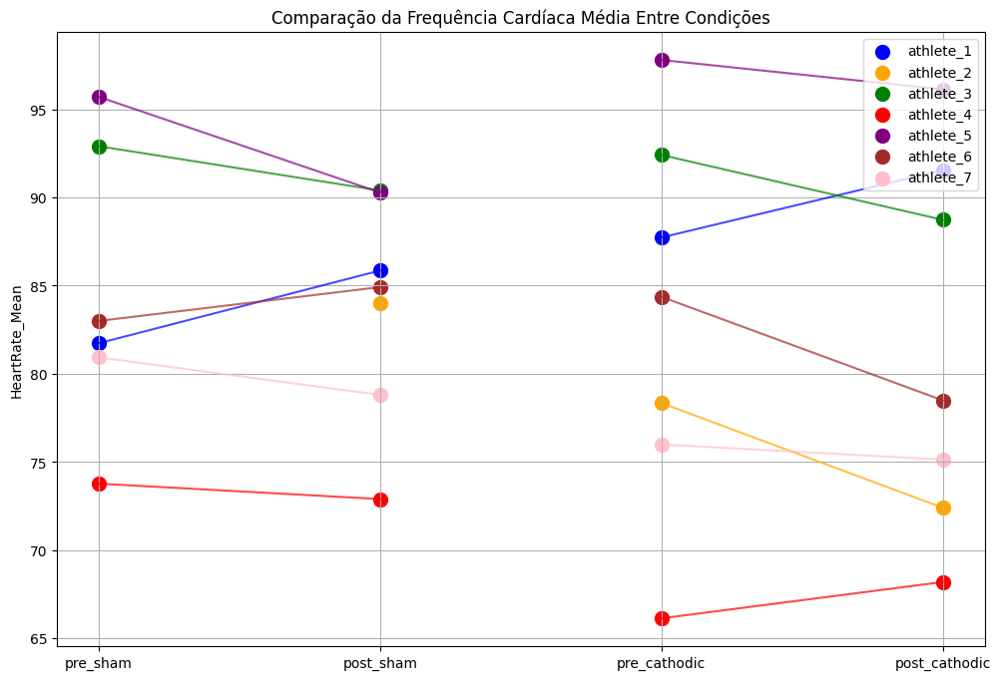

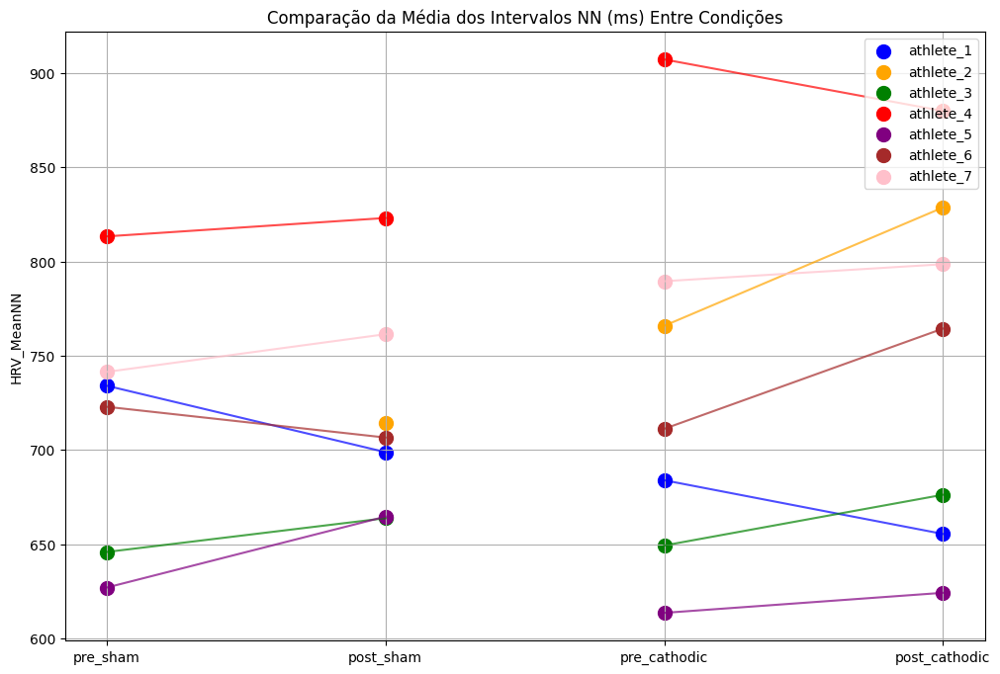

Exploração de dados de HR finalizada.


{'athlete_1': {'pre_sham': {'HeartRate_Mean': 81.7387108149743,
   'HRV_MeanNN': 734.0463215258856},
  'post_sham': {'HeartRate_Mean': 85.86071286635388,
   'HRV_MeanNN': 698.8062176165804},
  'pre_cathodic': {'HeartRate_Mean': 87.73329671593935,
   'HRV_MeanNN': 683.8908629441624},
  'post_cathodic': {'HeartRate_Mean': 91.54830230986835,
   'HRV_MeanNN': 655.3917274939173}},
 'athlete_2': {'pre_sham': None,
  'post_sham': {'HeartRate_Mean': 84.03017953928283,
   'HRV_MeanNN': 714.0291777188329},
  'pre_cathodic': {'HeartRate_Mean': 78.3429283637011,
   'HRV_MeanNN': 765.8636363636364},
  'post_cathodic': {'HeartRate_Mean': 72.40651019929243,
   'HRV_MeanNN': 828.6547692307691}},
 'athlete_3': {'pre_sham': {'HeartRate_Mean': 92.9040882254651,
   'HRV_MeanNN': 645.8273381294963},
  'post_sham': {'HeartRate_Mean': 90.39287421440966,
   'HRV_MeanNN': 663.7691358024691},
  'pre_cathodic': {'HeartRate_Mean': 92.41115168789526,
   'HRV_MeanNN': 649.2722891566265},
  'post_cathodic': {'HeartR

In [ ]:
import neurokit2 as nk
import matplotlib.pyplot as plt
import numpy as np

# Definindo a taxa de amostragem fixa
SAMPLING_RATE = 1111.11

# Definindo uma paleta de cores para os atletas
ATHLETES_COLORS = {
    'athlete_1': 'blue',
    'athlete_2': 'orange',
    'athlete_3': 'green',
    'athlete_4': 'red',
    'athlete_5': 'purple',
    'athlete_6': 'brown',
    'athlete_7': 'pink'
}

# Função para calcular a frequência cardíaca média usando apenas os picos detectados
def calculate_hr_metrics(peaks, time):
    """
    Calcula a frequência cardíaca média e a média dos intervalos RR com base nos picos detectados.

    Parameters:
    - peaks: Série contendo picos R do ECG.
    - time: Série de tempo correspondente ao sinal de ECG.

    Returns:
    - dicionário contendo as métricas HR.
    """
    try:
        rr_intervals = np.diff(time[peaks == 1].values)
        if len(rr_intervals) < 2:
            raise ValueError("Picos insuficientes para calcular HR.")

        heart_rate_mean = 60 / rr_intervals.mean()  # Convertendo intervalos RR para bpm
        mean_nn = np.mean(rr_intervals * 1000)  # Convertendo para milissegundos

        metrics = {
            "HeartRate_Mean": heart_rate_mean,
            "HRV_MeanNN": mean_nn  # Média dos intervalos NN (RR) em ms
        }
        return metrics
    except Exception as e:
        print(f"Erro ao processar dados de HR: {e}")
        return None

# Dicionário para armazenar os dados de HR por atleta e condição
hrv_data = {}

# Calcular HR para cada atleta e condição usando apenas os picos
for athlete, conditions in data['ecg'].items():
    hrv_data[athlete] = {}
    for condition, df in conditions.items():
        if df is not None and 'peaks' in df.columns and 'time' in df.columns:
            metrics = calculate_hr_metrics(df['peaks'], df['time'])
            hrv_data[athlete][condition] = metrics if metrics else None
        else:
            hrv_data[athlete][condition] = None

print("Cálculo de frequência cardíaca concluído.")

def plot_hr_comparison(metric_name, title):
    conditions = ['pre_sham', 'post_sham', 'pre_cathodic', 'post_cathodic']
    x_positions = [1, 2, 3, 4]

    plt.figure(figsize=(12, 8))

    for athlete, color in ATHLETES_COLORS.items():
        values = []
        valid_x_positions = []

        for i, cond in enumerate(conditions):
            if athlete in hrv_data and hrv_data[athlete] is not None and hrv_data[athlete].get(cond) is not None:
                metric_value = hrv_data[athlete][cond].get(metric_name)
                if metric_value is not None:
                    values.append(metric_value)
                    valid_x_positions.append(x_positions[i])

        if values:
            plt.scatter(valid_x_positions, values, color=color, label=athlete, s=100)

            # Conectar pre_sham e post_sham apenas se ambos existirem
            if (
                hrv_data[athlete].get('pre_sham') is not None and
                hrv_data[athlete].get('post_sham') is not None
            ):
                plt.plot(
                    [x_positions[0], x_positions[1]],
                    [hrv_data[athlete]['pre_sham'].get(metric_name), hrv_data[athlete]['post_sham'].get(metric_name)],
                    color=color, linestyle='-', alpha=0.7
                )

            # Conectar pre_cathodic e post_cathodic apenas se ambos existirem
            if (
                hrv_data[athlete].get('pre_cathodic') is not None and
                hrv_data[athlete].get('post_cathodic') is not None
            ):
                plt.plot(
                    [x_positions[2], x_positions[3]],
                    [hrv_data[athlete]['pre_cathodic'].get(metric_name), hrv_data[athlete]['post_cathodic'].get(metric_name)],
                    color=color, linestyle='-', alpha=0.7
                )

    plt.xticks(x_positions, conditions)
    plt.ylabel(metric_name)
    plt.title(title)
    plt.grid(True)
    plt.legend(loc='upper right')
    plt.show()


# Plotar a frequência cardíaca média e HRV_MeanNN para todas as condições
plot_hr_comparison('HeartRate_Mean', 'Comparação da Frequência Cardíaca Média Entre Condições')
plot_hr_comparison('HRV_MeanNN', 'Comparação da Média dos Intervalos NN (ms) Entre Condições')

print("Exploração de dados de HR finalizada.")

# Armazenar valores calculados para análises futuras
hrv_data

# Testing PLV, PLI, CF-PLM methods

In [ ]:
!pip install mne --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 24.4 MB/s eta 0:00:00


Baseline CF-PLM (ECG vs EEG, sem injeção): 0.049761145290638

=== Experimento Cross-frequency (ECG=1.0Hz, EEG=40.0Hz) ===

Experimento Cross-frequency:
0% Injeção => CF-PLM: 0.049761145290638, PLV: 0.0007059928539384126, PLI: 0.00132
25% Injeção => CF-PLM: 0.2206841574780719, PLV: 0.000988285864893957, PLI: 0.0010066666666666666
50% Injeção => CF-PLM: 0.4351037731487976, PLV: 0.0009630067510205119, PLI: 0.0008133333333333333
75% Injeção => CF-PLM: 0.6235692562802521, PLV: 0.0005009308581674252, PLI: 5.333333333333333e-05
100% Injeção => CF-PLM: 0.9594539424186116, PLV: 0.00013659059889353502, PLI: 0.0001
[INFO] Figura salva em: testing_connectivity_metrics/1_ECG_Original_vs_Injecao_Cross-frequency.png


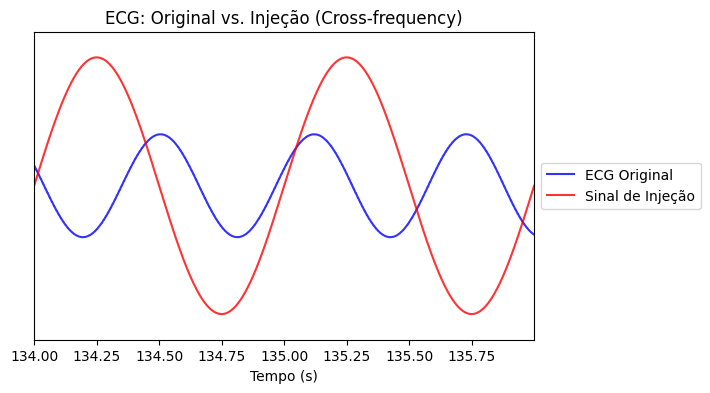

[INFO] Figura salva em: testing_connectivity_metrics/2_ECG_Injetado_Cross-frequency.png


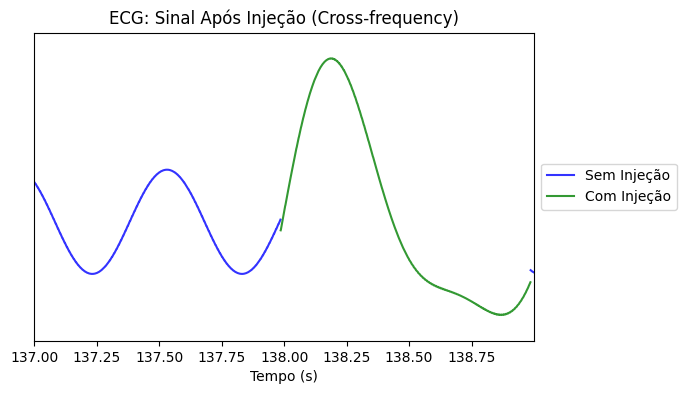

[INFO] Figura salva em: testing_connectivity_metrics/3_EEG_Original_vs_Injecao_Cross-frequency.png


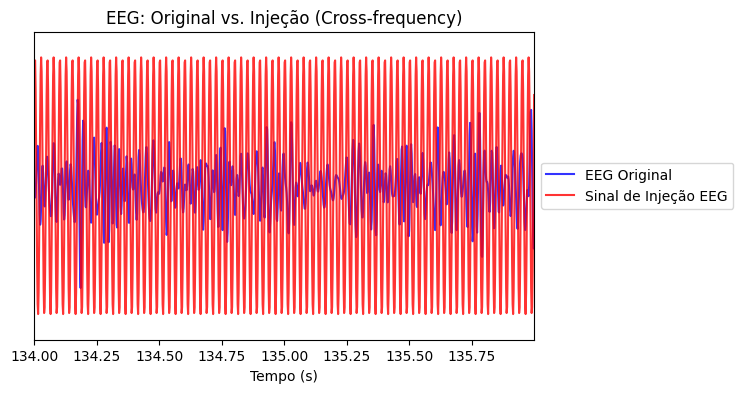

[INFO] Figura salva em: testing_connectivity_metrics/4_EEG_Injetado_Cross-frequency.png


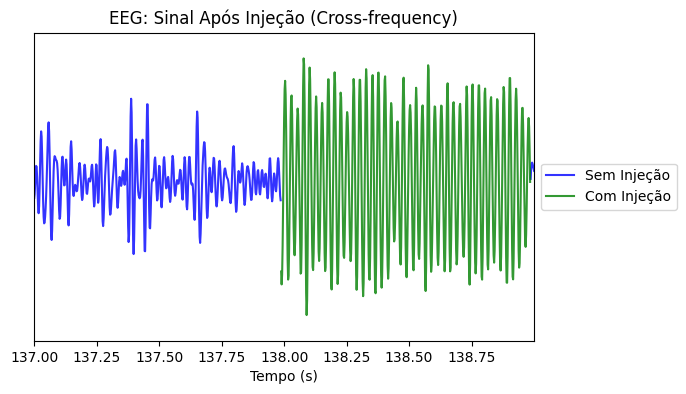

[INFO] Figura salva em: testing_connectivity_metrics/5_Passo1_Fases_Cross-frequency.png


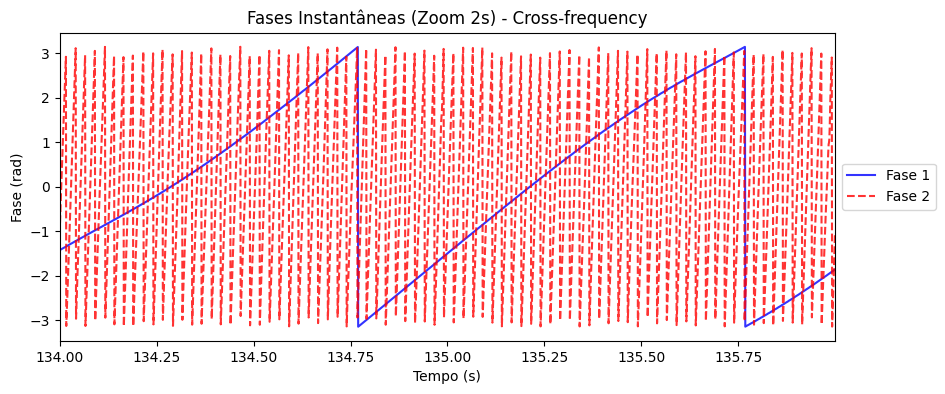

[INFO] Figura salva em: testing_connectivity_metrics/6_Passo2_Interferometrico_Cross-frequency.png


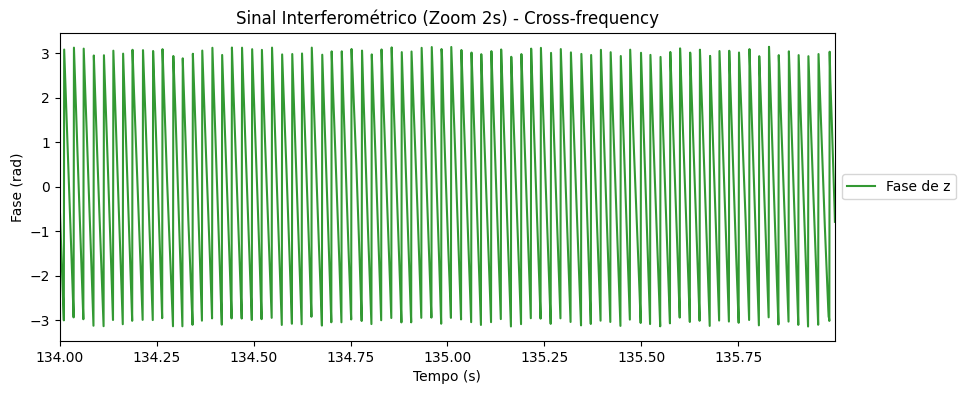

[INFO] Figura salva em: testing_connectivity_metrics/7_Passo3_FFT_PSD_Cross-frequency.png


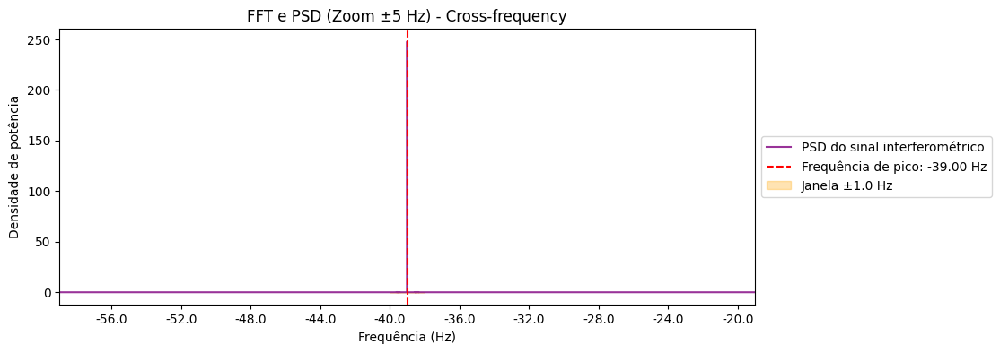


=== Experimento Same-frequency (ECG=10.0Hz, EEG=10.0Hz) ===

Experimento Same-frequency:
0% Injeção => CF-PLM: 0.049761145290638, PLV: 0.0007059928539384126, PLI: 0.00132
25% Injeção => CF-PLM: 0.16252085472275735, PLV: 0.2076861304622425, PLI: 0.20662666666666665
50% Injeção => CF-PLM: 0.3886829255592274, PLV: 0.4617674369101969, PLI: 0.4798266666666667
75% Injeção => CF-PLM: 0.5998708545880511, PLV: 0.7119100217673308, PLI: 0.73108
100% Injeção => CF-PLM: 0.9224131020713192, PLV: 0.9596296540218906, PLI: 0.9870866666666667
[INFO] Figura salva em: testing_connectivity_metrics/8_ECG_Original_vs_Injecao_Same-frequency.png


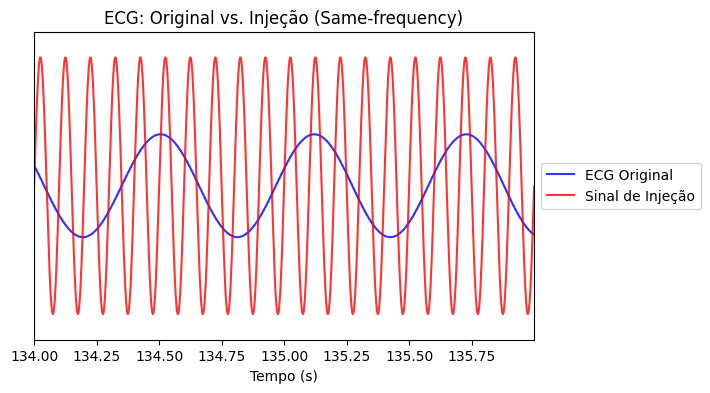

[INFO] Figura salva em: testing_connectivity_metrics/9_ECG_Injetado_Same-frequency.png


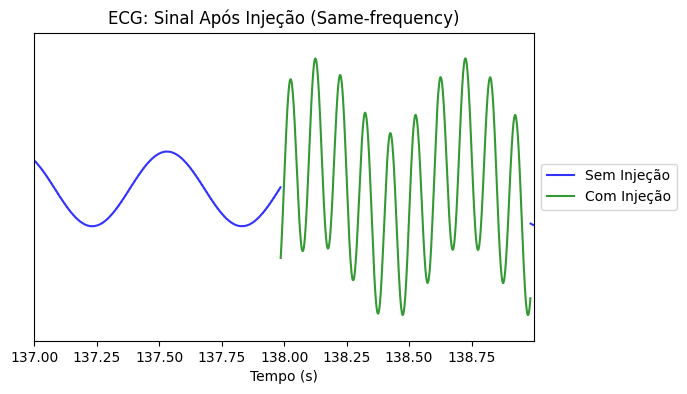

[INFO] Figura salva em: testing_connectivity_metrics/10_EEG_Original_vs_Injecao_Same-frequency.png


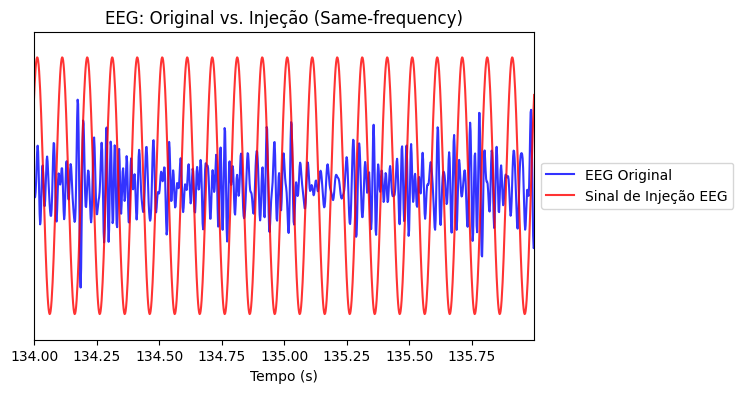

[INFO] Figura salva em: testing_connectivity_metrics/11_EEG_Injetado_Same-frequency.png


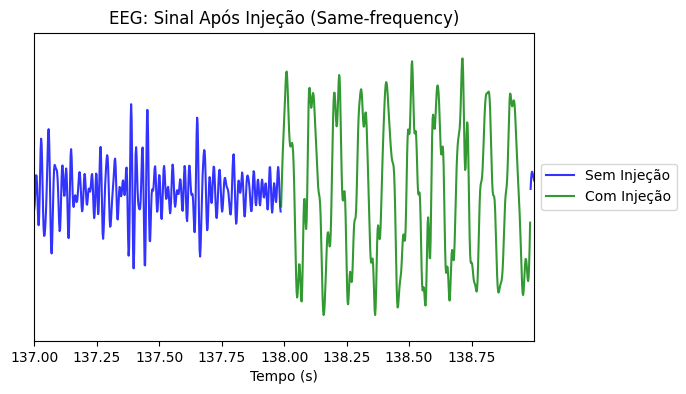

[INFO] Figura salva em: testing_connectivity_metrics/12_Passo1_Fases_Same-frequency.png


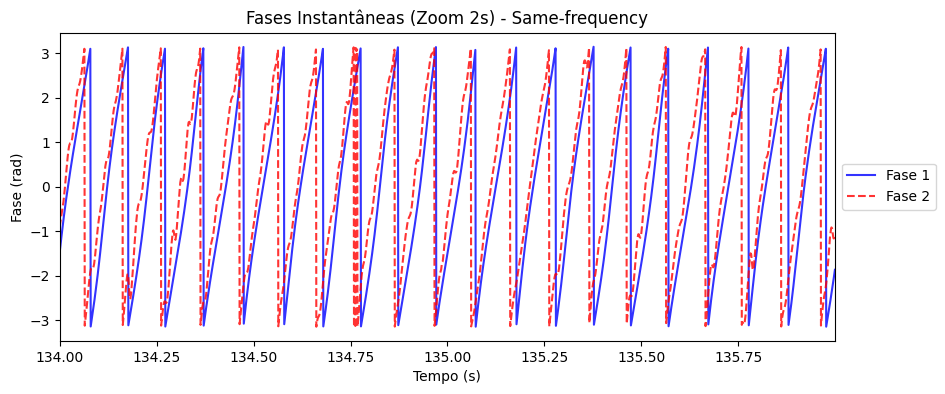

[INFO] Figura salva em: testing_connectivity_metrics/13_Passo2_Interferometrico_Same-frequency.png


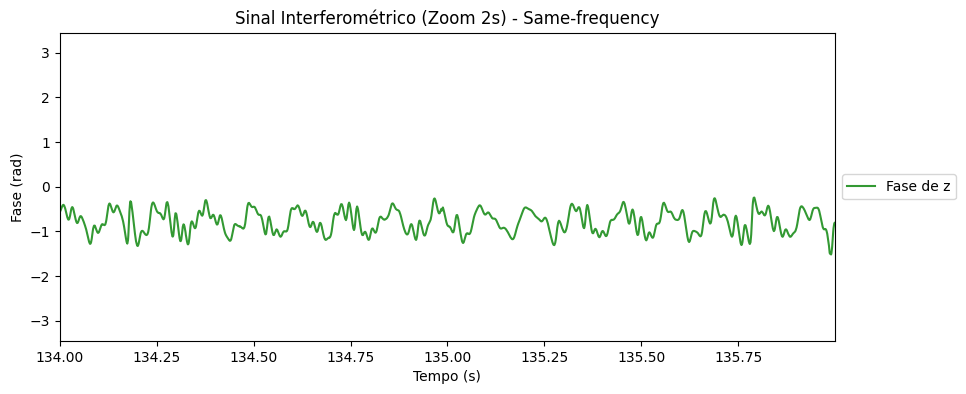

[INFO] Figura salva em: testing_connectivity_metrics/14_Passo3_FFT_PSD_Same-frequency.png


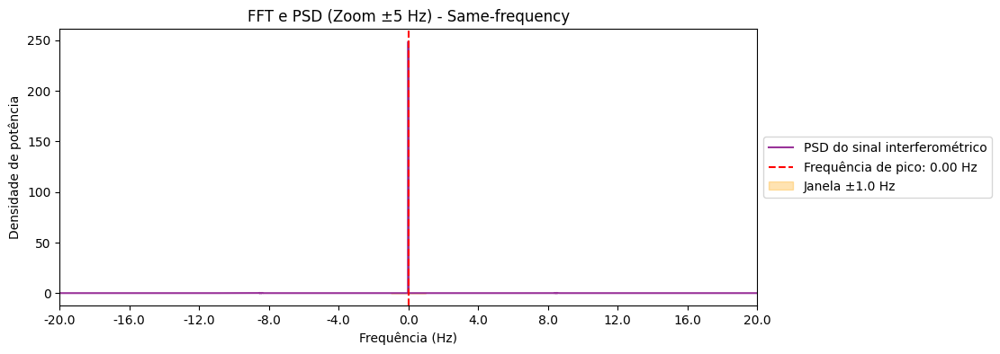


=== Experimento Same-frequency Com Phase Lag Zero (ECG=10.0Hz, EEG=10.0Hz) ===

Experimento Same-frequency Com Phase Lag Zero:
0% Injeção => CF-PLM: 0.049761145290638, PLV: 0.0007059928539384126, PLI: 0.00132
25% Injeção => CF-PLM: 0.16325255431754557, PLV: 0.20991113164469205, PLI: 0.0042
50% Injeção => CF-PLM: 0.3894863548969881, PLV: 0.4634917163665967, PLI: 0.00184
75% Injeção => CF-PLM: 0.6051437577670422, PLV: 0.7182558277339647, PLI: 0.0012
100% Injeção => CF-PLM: 0.9220612013141066, PLV: 0.9594450552683161, PLI: 0.00298
[INFO] Figura salva em: testing_connectivity_metrics/15_ZeroLag_Fases_Same-frequency Com Phase Lag Zero.png


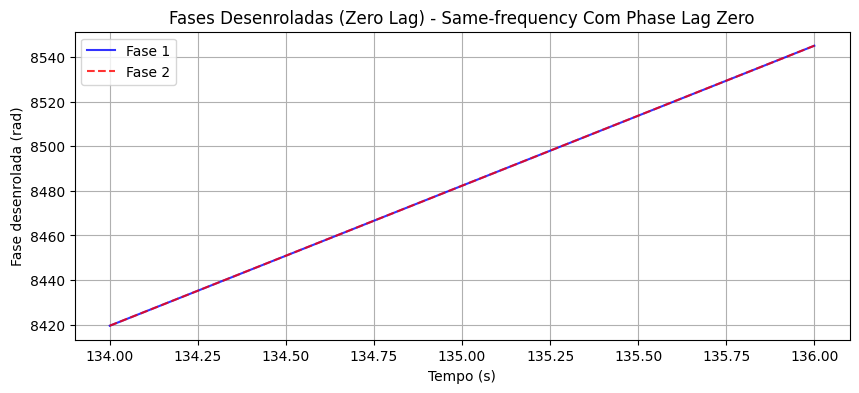

[INFO] Figura salva em: testing_connectivity_metrics/16_ZeroLag_Diferenca_Fase_Same-frequency Com Phase Lag Zero.png


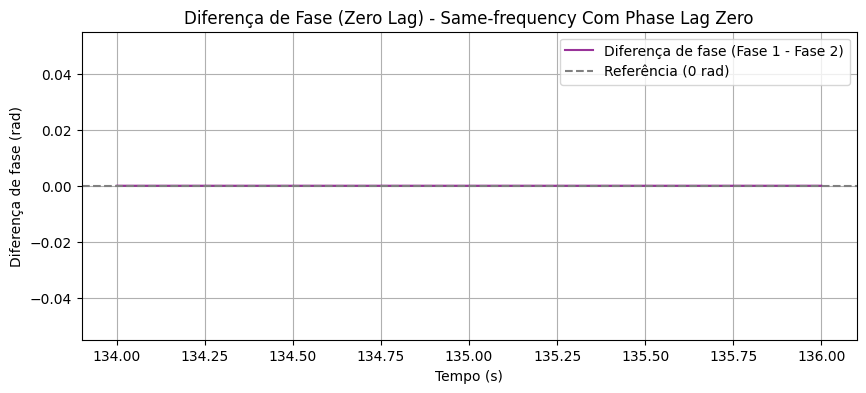

[INFO] Figura salva em: testing_connectivity_metrics/17_Comparativo_Subplots_Experimentos.png


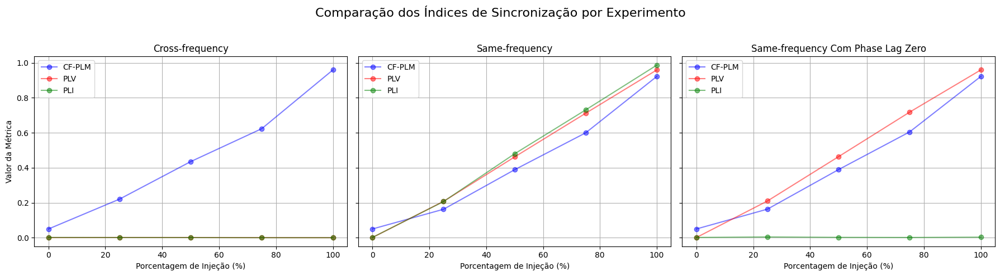


[INFO] Fim da execução.


In [ ]:
import os
import numpy as np
from scipy.signal import hilbert
import numpy.fft as fft
import pandas as pd
import matplotlib.pyplot as plt
import mne
from scipy.interpolate import interp1d
from matplotlib.ticker import MaxNLocator

# Cria a pasta para salvar as figuras se ela não existir e define um contador global para os plots
output_folder = "testing_connectivity_metrics"
if not os.path.exists(output_folder):
    os.makedirs(output_folder)
plot_counter = 1

def save_plot(filename):
    """
    Salva o plot na pasta definida com um prefixo numérico que indica a ordem.
    """
    global plot_counter, output_folder
    new_filename = os.path.join(output_folder, f"{plot_counter}_{filename}")
    plt.savefig(new_filename, dpi=300, bbox_inches='tight')
    print(f"[INFO] Figura salva em: {new_filename}")
    plot_counter += 1

def generate_injection_mask(time_vector, pulse_duration, injection_pct, fs):
    """
    Gera uma máscara de injeção e os intervalos correspondentes.
    """
    total_samples = len(time_vector)
    total_inj_samples = int(injection_pct * total_samples)
    pulse_samples = int(pulse_duration * fs)
    num_pulses = max(1, total_inj_samples // pulse_samples)
    spacing = total_samples // num_pulses

    inj_mask = np.zeros_like(time_vector)
    injection_intervals = []
    for i in range(num_pulses):
        start_idx = i * spacing
        end_idx = start_idx + pulse_samples
        if end_idx > total_samples:
            end_idx = total_samples
        inj_mask[start_idx:end_idx] = 1
        injection_intervals.append((time_vector[start_idx], time_vector[end_idx - 1]))
    return inj_mask, injection_intervals

def generate_injection_signal(time_vector, inj_freq, amplitude, phase=0.0):
    """
    Gera um sinal senoidal contínuo para injeção com um deslocamento de fase opcional.
    """
    return amplitude * np.sin(2 * np.pi * inj_freq * time_vector + phase)

def apply_injection(original_signal, inj_signal, inj_mask):
    """
    Aplica o sinal de injeção ao sinal original usando a máscara binária.
    """
    return original_signal + inj_signal * inj_mask

def resample_signal(source_time, signal, target_time):
    """
    Reamostra um sinal de sua base de tempo original para uma nova base usando interpolação linear.
    """
    interp_func = interp1d(source_time, signal, kind="linear", fill_value="extrapolate")
    return interp_func(target_time)

def kuramoto_simulation(T, dt, freqs, k, tau):
    """
    Exemplo de simulação de Kuramoto com atraso (tau).
    """
    N = len(freqs)
    num_steps = int(T/dt)
    theta = np.zeros((N, num_steps))
    theta[:, 0] = np.random.uniform(0, 2*np.pi, size=N) + np.random.normal(0, 0.1, size=N)
    delay_steps = int(tau/dt)
    for t in range(1, num_steps):
        for n in range(N):
            sum_term = 0
            for p in range(N):
                idx = t - delay_steps if t - delay_steps >= 0 else 0
                sum_term += np.sin(theta[p, idx] - theta[n, t-1])
            dtheta = 2*np.pi*freqs[n] + (k/N)*sum_term
            theta[n, t] = theta[n, t-1] + dtheta*dt
    return theta

def compute_plv(x, y):
    """
    Calcula Phase Locking Value (PLV) entre dois sinais.
    """
    phase_diff = np.angle(hilbert(x)) - np.angle(hilbert(y))
    return np.abs(np.mean(np.exp(1j * phase_diff)))

def compute_pli(x, y):
    """
    Calcula Phase Lag Index (PLI) entre dois sinais.
    """
    phase_diff = np.angle(hilbert(x)) - np.angle(hilbert(y))
    return np.abs(np.mean(np.sign(np.sin(phase_diff))))

def compute_cf_plm(x, y, fs, B=1.0):
    """
    Calcula o CF-PLM usando uma abordagem baseada em FFT.
    """
    x_an = hilbert(x)
    y_an = hilbert(y)
    z = (x_an * np.conjugate(y_an)) / (np.abs(x_an) * np.abs(y_an))
    z = np.nan_to_num(z)
    N = len(z)
    Z = fft.fft(z)
    Pxx = np.abs(Z)**2 / (N * fs)
    freqs = fft.fftfreq(N, d=1/fs)
    Pxx_shifted = fft.fftshift(Pxx)
    freqs_shifted = fft.fftshift(freqs)
    peak_idx = np.argmax(Pxx_shifted)
    f_peak = freqs_shifted[peak_idx]
    mask = (freqs_shifted >= f_peak - B) & (freqs_shifted <= f_peak + B)
    power_band = np.trapz(Pxx_shifted[mask], freqs_shifted[mask])
    total_power = np.trapz(Pxx_shifted, freqs_shifted)
    cf_plm_val = power_band / total_power
    return cf_plm_val, freqs_shifted, Pxx_shifted, f_peak

# -----------------------------------------------------------------------------
# PLOTS DE SINAIS (SEM SUBPLOTS)
# -----------------------------------------------------------------------------

def plot_ecg_original_vs_injection(time_ecg, ecg_original, ecg_injection, exp_label):
    zoom_half_window = 1.0
    mid_ecg = (time_ecg[0] + time_ecg[-1]) / 2
    zoom_start_ecg = mid_ecg - zoom_half_window
    zoom_end_ecg = mid_ecg + zoom_half_window
    idx_zoom_ecg = (time_ecg >= zoom_start_ecg) & (time_ecg <= zoom_end_ecg)
    y_min_ecg = np.min(np.concatenate((ecg_original[idx_zoom_ecg], ecg_injection[idx_zoom_ecg])))
    y_max_ecg = np.max(np.concatenate((ecg_original[idx_zoom_ecg], ecg_injection[idx_zoom_ecg])))
    margin_ecg = 0.1 * (y_max_ecg - y_min_ecg)
    y_min_ecg -= margin_ecg
    y_max_ecg += margin_ecg
    plt.figure(figsize=(8, 4))
    plt.subplots_adjust(right=0.75)
    plt.plot(time_ecg, ecg_original, label='ECG Original', color='blue', alpha=0.8)
    plt.plot(time_ecg, ecg_injection, label='Sinal de Injeção', color='red', alpha=0.8)
    plt.xlim(zoom_start_ecg, zoom_end_ecg)
    plt.ylim(y_min_ecg, y_max_ecg)
    plt.ticklabel_format(useOffset=False, style='plain')
    plt.xlabel('Tempo (s)')
    plt.title(f'ECG: Original vs. Injeção ({exp_label})')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    plt.gca().get_yaxis().set_visible(False)
    save_plot(f"ECG_Original_vs_Injecao_{exp_label}.png")
    plt.show()
    plt.close()

def plot_ecg_injected(time_ecg, ecg_injected, inj_mask_ecg, exp_label):
    zoom_half_window = 1.0
    mid_ecg = ((time_ecg[0] + time_ecg[-1]) / 2) + 3
    zoom_start_ecg = mid_ecg - zoom_half_window
    zoom_end_ecg = mid_ecg + zoom_half_window
    idx_zoom_ecg = (time_ecg >= zoom_start_ecg) & (time_ecg <= zoom_end_ecg)
    ecg_injected_no_injection = np.full_like(ecg_injected, np.nan)
    ecg_injected_with_injection = np.full_like(ecg_injected, np.nan)
    ecg_injected_no_injection[inj_mask_ecg == 0] = ecg_injected[inj_mask_ecg == 0]
    ecg_injected_with_injection[inj_mask_ecg == 1] = ecg_injected[inj_mask_ecg == 1]
    y_min_ecg = np.min(ecg_injected[idx_zoom_ecg])
    y_max_ecg = np.max(ecg_injected[idx_zoom_ecg])
    margin_ecg = 0.1 * (y_max_ecg - y_min_ecg)
    y_min_ecg -= margin_ecg
    y_max_ecg += margin_ecg
    plt.figure(figsize=(8, 4))
    plt.subplots_adjust(right=0.75)
    plt.plot(time_ecg, ecg_injected_no_injection, color='blue', label='Sem Injeção', alpha=0.8)
    plt.plot(time_ecg, ecg_injected_with_injection, color='green', label='Com Injeção', alpha=0.8)
    plt.xlim(zoom_start_ecg, zoom_end_ecg)
    plt.ylim(y_min_ecg, y_max_ecg)
    plt.ticklabel_format(useOffset=False, style='plain')
    plt.xlabel('Tempo (s)')
    plt.title(f'ECG: Sinal Após Injeção ({exp_label})')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    plt.gca().get_yaxis().set_visible(False)
    save_plot(f"ECG_Injetado_{exp_label}.png")
    plt.show()
    plt.close()

def plot_eeg_original_vs_injection(time_eeg, eeg_original, eeg_injection, exp_label):
    zoom_half_window = 1.0
    mid_eeg = (time_eeg[0] + time_eeg[-1]) / 2
    zoom_start_eeg = mid_eeg - zoom_half_window
    zoom_end_eeg = mid_eeg + zoom_half_window
    idx_zoom_eeg = (time_eeg >= zoom_start_eeg) & (time_eeg <= zoom_end_eeg)
    y_min_eeg = np.min(np.concatenate((eeg_original[idx_zoom_eeg], eeg_injection[idx_zoom_eeg])))
    y_max_eeg = np.max(np.concatenate((eeg_original[idx_zoom_eeg], eeg_injection[idx_zoom_eeg])))
    margin_eeg = 0.1 * (y_max_eeg - y_min_eeg)
    y_min_eeg -= margin_eeg
    y_max_eeg += margin_eeg
    plt.figure(figsize=(8, 4))
    plt.subplots_adjust(right=0.75)
    plt.plot(time_eeg, eeg_original, label='EEG Original', color='blue', alpha=0.8)
    plt.plot(time_eeg, eeg_injection, label='Sinal de Injeção EEG', color='red', alpha=0.8)
    plt.xlim(zoom_start_eeg, zoom_end_eeg)
    plt.ylim(y_min_eeg, y_max_eeg)
    plt.ticklabel_format(useOffset=False, style='plain')
    plt.xlabel('Tempo (s)')
    plt.title(f'EEG: Original vs. Injeção ({exp_label})')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    plt.gca().get_yaxis().set_visible(False)
    save_plot(f"EEG_Original_vs_Injecao_{exp_label}.png")
    plt.show()
    plt.close()

def plot_eeg_injected(time_eeg, eeg_injected, inj_mask_eeg, exp_label):

    zoom_half_window = 1.0
    mid_eeg = ((time_eeg[0] + time_eeg[-1]) / 2) + 3
    zoom_start_eeg = mid_eeg - zoom_half_window
    zoom_end_eeg = mid_eeg + zoom_half_window
    idx_zoom_eeg = (time_eeg >= zoom_start_eeg) & (time_eeg <= zoom_end_eeg)
    eeg_injected_no_injection = np.full_like(eeg_injected, np.nan)
    eeg_injected_with_injection = np.full_like(eeg_injected, np.nan)
    eeg_injected_no_injection[inj_mask_eeg == 0] = eeg_injected[inj_mask_eeg == 0]
    eeg_injected_with_injection[inj_mask_eeg == 1] = eeg_injected[inj_mask_eeg == 1]
    y_min_eeg = np.min(eeg_injected[idx_zoom_eeg])
    y_max_eeg = np.max(eeg_injected[idx_zoom_eeg])
    margin_eeg = 0.1 * (y_max_eeg - y_min_eeg)
    y_min_eeg -= margin_eeg
    y_max_eeg += margin_eeg
    plt.figure(figsize=(8, 4))
    plt.subplots_adjust(right=0.75)
    plt.plot(time_eeg, eeg_injected_no_injection, color='blue', label='Sem Injeção', alpha=0.8)
    plt.plot(time_eeg, eeg_injected_with_injection, color='green', label='Com Injeção', alpha=0.8)
    plt.xlim(zoom_start_eeg, zoom_end_eeg)
    plt.ylim(y_min_eeg, y_max_eeg)
    plt.ticklabel_format(useOffset=False, style='plain')
    plt.xlabel('Tempo (s)')
    plt.title(f'EEG: Sinal Após Injeção ({exp_label})')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    plt.gca().get_yaxis().set_visible(False)
    save_plot(f"EEG_Injetado_{exp_label}.png")
    plt.show()
    plt.close()

def plot_signals_no_subplots(time_ecg, ecg_original, ecg_injection, ecg_injected,
                             inj_mask_ecg,
                             time_eeg, eeg_original, eeg_injection, eeg_injected,
                             inj_mask_eeg,
                             exp_label):
    plot_ecg_original_vs_injection(time_ecg, ecg_original, ecg_injection, exp_label)
    plot_ecg_injected(time_ecg, ecg_injected, inj_mask_ecg, exp_label)
    plot_eeg_original_vs_injection(time_eeg, eeg_original, eeg_injection, exp_label)
    plot_eeg_injected(time_eeg, eeg_injected, inj_mask_eeg, exp_label)

def plot_cf_plm_steps_all_passes(x, y, fs, exp_label="", B=1.0):
    t = np.arange(len(x)) / fs
    mid_time = (t[0] + t[-1]) / 2
    zoom_half_window = 1.0
    zoom_start = mid_time - zoom_half_window
    zoom_end = mid_time + zoom_half_window
    x_an = hilbert(x)
    y_an = hilbert(y)
    phi_x = np.angle(x_an)
    phi_y = np.angle(y_an)
    plt.figure(figsize=(10, 4))
    plt.plot(t, phi_x, label='Fase 1', color='blue', alpha=0.8)
    plt.plot(t, phi_y, label='Fase 2', color='red', linestyle='--', alpha=0.8)
    plt.xlabel('Tempo (s)')
    plt.ylabel('Fase (rad)')
    plt.title(f'Fases Instantâneas (Zoom 2s) - {exp_label}')
    plt.xlim(zoom_start, zoom_end)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    save_plot(f"Passo1_Fases_{exp_label}.png")
    plt.show()
    plt.close()
    x_an = hilbert(x)
    y_an = hilbert(y)
    z = np.nan_to_num((x_an * np.conjugate(y_an)) / (np.abs(x_an) * np.abs(y_an)))
    phi_z = np.angle(z)
    plt.figure(figsize=(10, 4))
    plt.plot(t, phi_z, label='Fase de z', color='green', alpha=0.8)
    plt.xlabel('Tempo (s)')
    plt.ylabel('Fase (rad)')
    plt.title(f'Sinal Interferométrico (Zoom 2s) - {exp_label}')
    plt.xlim(zoom_start, zoom_end)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    save_plot(f"Passo2_Interferometrico_{exp_label}.png")
    plt.show()
    plt.close()
    N = len(z)
    Z = fft.fft(z)
    Pxx = np.abs(Z)**2 / (N * fs)
    freqs = fft.fftfreq(N, d=1/fs)
    Pxx_shifted = fft.fftshift(Pxx)
    freqs_shifted = fft.fftshift(freqs)
    peak_idx = np.argmax(Pxx_shifted)
    f_peak = freqs_shifted[peak_idx]
    mask = (freqs_shifted >= f_peak - B) & (freqs_shifted <= f_peak + B)
    plt.figure(figsize=(10, 4))
    plt.plot(freqs_shifted, Pxx_shifted, label='PSD do sinal interferométrico', color='purple', alpha=0.8)
    plt.axvline(f_peak, color='red', linestyle='--', label=f'Frequência de pico: {f_peak:.2f} Hz')
    plt.fill_between(freqs_shifted, Pxx_shifted, where=mask, color='orange', alpha=0.3, label=f'Janela ±{B} Hz')
    plt.xlabel('Frequência (Hz)')
    plt.ylabel('Densidade de potência')
    plt.title(f'FFT e PSD (Zoom ±5 Hz) - {exp_label}')
    plt.xlim(f_peak - 20, f_peak + 20)
    plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.1f}'))
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), frameon=True)
    save_plot(f"Passo3_FFT_PSD_{exp_label}.png")
    plt.show()
    plt.close()

def plot_zero_lag_phases(signal1, signal2, fs, exp_label):
    phase1 = np.unwrap(np.angle(hilbert(signal1)))
    phase2 = np.unwrap(np.angle(hilbert(signal2)))
    t = np.arange(len(signal1)) / fs
    phase1 -= phase1[0]
    phase2 -= phase2[0]
    zoom_start = t[len(t) // 2] - 1.0
    zoom_end = t[len(t) // 2] + 1.0
    idx_zoom = (t >= zoom_start) & (t <= zoom_end)
    plt.figure(figsize=(10, 4))
    plt.plot(t[idx_zoom], phase1[idx_zoom], label='Fase 1', color='blue', alpha=0.8)
    plt.plot(t[idx_zoom], phase2[idx_zoom], label='Fase 2', color='red', linestyle='--', alpha=0.8)
    plt.xlabel('Tempo (s)')
    plt.ylabel('Fase desenrolada (rad)')
    plt.title(f'Fases Desenroladas (Zero Lag) - {exp_label}')
    plt.legend(loc='upper left')
    plt.grid(True)
    save_plot(f"ZeroLag_Fases_{exp_label}.png")
    plt.show()
    plt.close()
    phase_diff = phase1 - phase2
    plt.figure(figsize=(10, 4))
    plt.plot(t[idx_zoom], phase_diff[idx_zoom], color='purple', label='Diferença de fase (Fase 1 - Fase 2)', alpha=0.8)
    plt.axhline(0, color='gray', linestyle='--', label='Referência (0 rad)')
    plt.xlabel('Tempo (s)')
    plt.ylabel('Diferença de fase (rad)')
    plt.title(f'Diferença de Fase (Zero Lag) - {exp_label}')
    plt.legend(loc='upper right')
    plt.grid(True)
    save_plot(f"ZeroLag_Diferenca_Fase_{exp_label}.png")
    plt.show()
    plt.close()

def plot_comparative_metrics(results):
    experiments = list(results.keys())
    injection_levels = [0, 25, 50, 75, 100]
    num_experiments = len(experiments)
    fig, axs = plt.subplots(1, num_experiments, figsize=(6*num_experiments, 5), sharey=True)
    if num_experiments == 1:
        axs = [axs]
    for ax, exp in zip(axs, experiments):
        cf_plm_results, plv_results, pli_results = results[exp]
        cf_plm_values = [cf_plm_results[pct] for pct in ["0%", "25%", "50%", "75%", "100%"]]
        plv_values    = [plv_results[pct]    for pct in ["0%", "25%", "50%", "75%", "100%"]]
        pli_values    = [pli_results[pct]    for pct in ["0%", "25%", "50%", "75%", "100%"]]
        ax.plot(injection_levels, cf_plm_values, marker='o', label='CF-PLM', color='blue', alpha=0.5)
        ax.plot(injection_levels, plv_values, marker='o', label='PLV', color='red', alpha=0.5)
        ax.plot(injection_levels, pli_values, marker='o', label='PLI', color='green', alpha=0.5)
        ax.set_xlabel('Porcentagem de Injeção (%)')
        ax.set_title(exp)
        ax.grid(True)
        ax.legend()
    axs[0].set_ylabel('Valor da Métrica')
    plt.suptitle('Comparação dos Índices de Sincronização por Experimento', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    save_plot("Comparativo_Subplots_Experimentos.png")
    plt.show()
    plt.close()

# -----------------------------------------------------------------------------
# SCRIPT PRINCIPAL
# -----------------------------------------------------------------------------

# 1) Carrega dados de ECG (0.5-2 Hz) do CSV
ecg_path = "athlete_1_post_cathodic_processed_ecg.csv"
ecg_df = pd.read_csv(ecg_path, header=0)
if "time" in ecg_df.columns:
    time_ecg = ecg_df["time"].astype(float).values.flatten()
    fs_ecg = 1 / np.mean(np.diff(time_ecg))
else:
    raise ValueError("Coluna 'time' não encontrada no ECG")
if "ecg_sinusal" in ecg_df.columns:
    ecg = ecg_df["ecg_sinusal"].astype(float).values.flatten()
else:
    raise ValueError("Coluna 'ecg_sinusal' não encontrada no arquivo CSV.")

# 2) Carrega dados de EEG do arquivo FIF e filtra (30-60 Hz)
eeg_path = "athlete_1_post_cathodic.fif"
raw = mne.io.read_raw_fif(eeg_path, preload=True, verbose="ERROR")
raw.filter(30, 60, fir_design="firwin", verbose="ERROR")
eeg = raw.get_data(picks=[0]).flatten()

# 3) Ajusta duração para ambos os sinais
duration = min(len(ecg) / fs_ecg, len(eeg) / raw.info["sfreq"])
t_ecg = np.linspace(0, duration, int(duration * fs_ecg), endpoint=False)
t_eeg = np.linspace(0, duration, int(duration * raw.info["sfreq"]), endpoint=False)
ecg = ecg[: int(duration * fs_ecg)]
eeg = eeg[: int(duration * raw.info["sfreq"])]

# 4) Normaliza (centraliza) os sinais
ecg = ecg - np.mean(ecg)
eeg = eeg - np.mean(eeg)

# 5) Calcula baseline CF-PLM (sem injeção)
eeg_resampled_baseline = resample_signal(t_eeg, eeg, t_ecg)
baseline_cf_plm, _, _, _ = compute_cf_plm(ecg, eeg_resampled_baseline, fs_ecg)
print(f"Baseline CF-PLM (ECG vs EEG, sem injeção): {baseline_cf_plm}")

# 6) Parâmetros de injeção
scale_factor_ecg = 5 * np.std(ecg)
scale_factor_eeg = 5 * np.std(eeg)
injection_percentages = {
    "0%": 0.0,
    "25%": 0.25,
    "50%": 0.50,
    "75%": 0.75,
    "100%": 1.0
}
pulse_duration = 1.0

# 7) Definição dos experimentos:
# "Cross-frequency": ECG injetado a 1 Hz e EEG a 40 Hz
# "Same-frequency": ECG e EEG ambos injetados a 10 Hz (com defasagem, por exemplo, pi/4)
# "Same-frequency Com Phase Lag Zero": Simulação com sinais idênticos (10 Hz, zero defasagem)
experiments = [
    ("Cross-frequency", 1.0, 40.0),
    ("Same-frequency", 10.0, 10.0),
    ("Same-frequency Com Phase Lag Zero", 10.0, 10.0)
]

results = {}

for exp_label, ecg_inj_freq, eeg_inj_freq in experiments:
    cf_plm_results = {}
    plv_results = {}
    pli_results = {}
    signals = {}

    print(f"\n=== Experimento {exp_label} (ECG={ecg_inj_freq}Hz, EEG={eeg_inj_freq}Hz) ===")
    for label, pct in injection_percentages.items():
        # ECG
        inj_mask_ecg, intervals_ecg = generate_injection_mask(t_ecg, pulse_duration, pct, fs_ecg)
        amp_ecg = scale_factor_ecg * np.sqrt(pct)
        ecg_injection_wave = generate_injection_signal(t_ecg, ecg_inj_freq, amp_ecg, phase=0.0)
        ecg_injected_sum = apply_injection(ecg, ecg_injection_wave, inj_mask_ecg)

        # EEG
        inj_mask_eeg = np.zeros_like(t_eeg)
        for start, end in intervals_ecg:
            inj_mask_eeg[(t_eeg >= start) & (t_eeg < end)] = 1
        amp_eeg = scale_factor_eeg * np.sqrt(pct)
        phase_offset = 0.0 if exp_label == "Same-frequency Com Phase Lag Zero" else np.pi/4
        eeg_injection_wave = generate_injection_signal(t_eeg, eeg_inj_freq, amp_eeg, phase=phase_offset)
        eeg_injected_sum = apply_injection(eeg, eeg_injection_wave, inj_mask_eeg)

        # Resample EEG para a base de tempo do ECG
        eeg_injected_sum_resampled = resample_signal(t_eeg, eeg_injected_sum, t_ecg)

        # Métricas
        cf_plm_val, _, _, _ = compute_cf_plm(ecg_injected_sum, eeg_injected_sum_resampled, fs_ecg)
        plv_val = compute_plv(ecg_injected_sum, eeg_injected_sum_resampled)
        pli_val = compute_pli(ecg_injected_sum, eeg_injected_sum_resampled)

        cf_plm_results[label] = cf_plm_val
        plv_results[label] = plv_val
        pli_results[label] = pli_val

        if label == "50%":
            signals["ecg_original"] = ecg
            signals["ecg_injection_wave"] = ecg_injection_wave
            signals["ecg_injected"] = ecg_injected_sum
            signals["ecg_mask"] = inj_mask_ecg
            signals["eeg_original"] = eeg
            signals["eeg_injection_wave"] = eeg_injection_wave
            signals["eeg_injected"] = eeg_injected_sum
            signals["eeg_mask"] = inj_mask_eeg

    results[exp_label] = (cf_plm_results, plv_results, pli_results)

    print(f"\nExperimento {exp_label}:")
    for pct_label in injection_percentages.keys():
        print(
            f"{pct_label} Injeção => CF-PLM: {cf_plm_results[pct_label]}, "
            f"PLV: {plv_results[pct_label]}, PLI: {pli_results[pct_label]}"
        )

    if exp_label != "Same-frequency Com Phase Lag Zero":
        plot_signals_no_subplots(
            t_ecg,
            signals["ecg_original"], signals["ecg_injection_wave"], signals["ecg_injected"], signals["ecg_mask"],
            t_eeg,
            signals["eeg_original"], signals["eeg_injection_wave"], signals["eeg_injected"], signals["eeg_mask"],
            exp_label=exp_label
        )
        plot_cf_plm_steps_all_passes(ecg_injected_sum, eeg_injected_sum_resampled, fs_ecg, exp_label=exp_label, B=1.0)
    else:
        freq = 10.0
        amplitude = 1.0
        ecg = amplitude * np.sin(2 * np.pi * freq * t_ecg)
        eeg = ecg.copy()
        plot_zero_lag_phases(ecg, eeg, fs_ecg, exp_label)

plot_comparative_metrics(results)

print("\n[INFO] Fim da execução.")

In [ ]:
!zip -r testing_connectivity_metrics.zip testing_connectivity_metrics

updating: testing_connectivity_metrics/ (stored 0%)
updating: testing_connectivity_metrics/17_Comparativo_Subplots_Experimentos.png (deflated 15%)
updating: testing_connectivity_metrics/13_Passo2_Interferometrico_Same-frequency.png (deflated 13%)
updating: testing_connectivity_metrics/9_ECG_Injetado_Same-frequency.png (deflated 9%)
updating: testing_connectivity_metrics/4_EEG_Injetado_Cross-frequency.png (deflated 7%)
updating: testing_connectivity_metrics/7_Passo3_FFT_PSD_Cross-frequency.png (deflated 22%)
updating: testing_connectivity_metrics/14_Passo3_FFT_PSD_Same-frequency.png (deflated 23%)
updating: testing_connectivity_metrics/6_Passo2_Interferometrico_Cross-frequency.png (deflated 4%)
updating: testing_connectivity_metrics/15_ZeroLag_Fases_Same-frequency Com Phase Lag Zero.png (deflated 14%)
updating: testing_connectivity_metrics/16_ZeroLag_Diferenca_Fase_Same-frequency Com Phase Lag Zero.png (deflated 20%)
updating: testing_connectivity_metrics/1_ECG_Original_vs_Injecao_Cross